In [1]:
from time import asctime
import pandas as pd

import numpy as np
import math

import hashlib

from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string
import re
from nltk.stem.wordnet import WordNetLemmatizer
import nltk
import unicodedata

import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns

from textblob import TextBlob

pd.set_option("max_columns", None)
pd.set_option("max_rows", None)

print(f"Begin --> {asctime()}")

Begin --> Mon May 22 00:43:15 2023


In [2]:
Label = 'Shiraz/Syrah'

shiraz_reviews = pd.read_csv("../data/shiraz.csv")
fr_shiraz_reviews = pd.read_csv("../data/shiraz_fr.csv")
au_shiraz_reviews = pd.read_csv("../data/shiraz_au.csv")
low_price_shiraz_reviews = pd.read_csv("../data/shiraz_lowprice.csv")

all_shiraz = pd.concat([au_shiraz_reviews, 
                        fr_shiraz_reviews, 
                        shiraz_reviews,
                        low_price_shiraz_reviews])

def get_reviews(page, Label, all_shiraz):
    
    shiraz_reviews_additional = pd.read_csv(f"../data/shiraz_{page}.csv")
    fr_shiraz_reviews_additional = pd.read_csv(f"../data/shiraz_fr_{page}.csv")
    
    low_price_shiraz_reviews_additional = pd.read_csv(f"../data/shiraz_lowprice_{page}.csv")
    
    shiraz_additions = [all_shiraz,
                        shiraz_reviews_additional, 
                        fr_shiraz_reviews_additional, 
                        low_price_shiraz_reviews_additional]
    
    if page < 12:
        au_shiraz_reviews_additional = pd.read_csv(f"../data/shiraz_au_{page}.csv")
        shiraz_additions.append(au_shiraz_reviews_additional)
    
    all_shiraz = pd.concat(shiraz_additions)
    
    
    return all_shiraz

n = 20 # 1 plus the max id. may put 20 later
for idx in range(2, n): 
    all_shiraz = get_reviews(idx, '', all_shiraz)

all_shiraz.drop_duplicates("Note", inplace=True)
all_shiraz['Label'] = Label

In [3]:
all_shiraz.describe()

,Vintage_Year,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,53097.000000,53097.0,53097.000000,5.309700e+04,53097.000000,53097.000000,53097.000000,53097.000000,53097.000000,53097.000000,53097.000000
mean,2015.364842,1.0,84.120584,2.009184e+06,3.328998,176.038609,3.282571,4.345218,1.746286,3.394057,4.083788
std,5.141361,0.0,241.242190,1.991630e+06,1.610142,352.093956,0.323643,0.355011,0.308945,0.328306,0.542150
min,1983.000000,1.0,6.990000,4.550000e+02,0.000000,10.000000,2.077360,2.996635,1.000000,2.530444,1.000000
25%,2014.000000,1.0,25.990000,1.105466e+06,3.700000,30.000000,3.053739,4.057366,1.525692,3.162000,4.000000
50%,2017.000000,1.0,44.990000,1.372692e+06,4.000000,62.000000,3.191286,4.377648,1.682225,3.319276,4.000000
75%,2019.000000,1.0,80.000000,2.397361e+06,4.200000,171.000000,3.500560,4.656118,1.989073,3.580949,4.500000
max,2021.000000,1.0,6699.990000,1.110804e+07,4.800000,3530.000000,4.082353,5.000000,2.983982,4.517647,5.000000


In [4]:
Label = 'Pinot_Noir'

pinot_noir_reviews = pd.read_csv("../data/pinotNoir.csv")
pinotNoir_france = pd.read_csv("../data/pinotNoir_france.csv")
pinotNoir_napa = pd.read_csv("../data/pinotNoir_napa.csv")
lowprice_pn_reviews = pd.read_csv("../data/pinotNoir_lowprice.csv")

all_pinot_noir = pd.concat([pinot_noir_reviews, 
                            pinotNoir_france, 
                            pinotNoir_napa,
                            lowprice_pn_reviews
                           ])

def get_reviews(page, Label, all_pinot_noir):
    
    pinot_noir_reviews_additional = pd.read_csv(f"../data/pinotNoir_{page}.csv")
    pinotNoir_france_additional = pd.read_csv(f"../data/pinotNoir_france_{page}.csv")
    lowprice_pn_reviews_additional = pd.read_csv(f"../data/pinotNoir_lowprice_{page}.csv")
    
    new_pinots = [all_pinot_noir,
                        pinot_noir_reviews_additional, 
                        pinotNoir_france_additional, 
                        lowprice_pn_reviews_additional]
    
    if page < 5:
        pinotNoir_napa_additional = pd.read_csv(f"../data/pinotNoir_napa_{page}.csv")
        new_pinots.append(pinotNoir_napa_additional)
    
    all_pinot_noir = pd.concat(new_pinots)
    return all_pinot_noir

n = 20 # 1 plus the max id
for idx in range(2, n): 
    all_pinot_noir = get_reviews(idx, '', all_pinot_noir)

all_pinot_noir.drop_duplicates("Note", inplace=True)
all_pinot_noir['Label'] = Label

In [5]:
all_pinot_noir.describe()

,Vintage_Year,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,71156.000000,71206.0,71206.000000,7.120600e+04,71206.000000,71206.000000,71206.000000,71206.000000,71206.000000,71206.000000,71206.000000
mean,2016.094272,1.0,314.308717,2.272438e+06,3.554455,269.658203,3.757987,2.834839,1.609332,2.291518,4.191686
std,5.153221,0.0,1218.837829,2.365706e+06,1.580286,4329.156007,0.331736,0.384831,0.221395,0.275260,0.533607
min,1967.000000,1.0,8.990000,1.150000e+02,0.000000,10.000000,2.646839,1.231121,1.000000,1.279174,1.000000
25%,2015.000000,1.0,31.750000,1.101284e+06,3.900000,31.000000,3.453705,2.584187,1.464928,2.105013,4.000000
50%,2018.000000,1.0,49.990000,1.480693e+06,4.200000,66.000000,3.814031,2.945540,1.597683,2.206164,4.000000
75%,2019.000000,1.0,159.000000,2.606479e+06,4.400000,151.000000,4.029349,3.093469,1.740380,2.497619,4.500000
max,2021.000000,1.0,22900.000000,1.142358e+07,4.900000,162987.000000,4.683422,4.504314,2.689254,4.474684,5.000000


In [6]:
all_pinot_noir.Varietal_Name.unique()

array(['Pinot Noir', 'Côte de Nuits Red', 'Côte de Beaune Red', 'Red',
       'Côte Chalonnaise Red', 'Douro Red', 'Barolo', 'Spätburgunder'],
      dtype=object)

In [7]:
all_pinot_noir.Country.unique()

array(['United States', 'France', 'Argentina', 'Portugal', 'New Zealand',
       'Australia', 'Italy', 'South Africa', 'Switzerland', 'Austria',
       'Germany', 'Chile', 'Spain', 'Canada'], dtype=object)

In [8]:
Label = "Tempranillo"

tempranillo_reviews = pd.read_csv("../data/tempranillo.csv")
lowprice_tempranillo_reviews = pd.read_csv("../data/tempranillo_lowprice.csv")
tempranillo_spain = pd.read_csv("../data/tempranillo_spain.csv")

all_tempranillo_reviews = pd.concat([tempranillo_spain, 
                                     lowprice_tempranillo_reviews,
                                     tempranillo_reviews])

def get_reviews(page, Label, all_tempranillo_reviews):
    
    tempranillo_reviews = pd.read_csv(f"../data/tempranillo_{page}.csv")
    tempranillo_spain = pd.read_csv(f"../data/tempranillo_spain_{page}.csv")
    

    all_tempranillo_reviews = pd.concat([all_tempranillo_reviews,
                                         tempranillo_spain, 
                                         tempranillo_reviews])
    
    if page < 18:
        lowprice_tempranillo_reviews = pd.read_csv(f"../data/tempranillo_lowprice_{page}.csv")
        all_tempranillo_reviews = pd.concat([all_tempranillo_reviews,
                                         lowprice_tempranillo_reviews])
        
    
    return all_tempranillo_reviews

n = 20 # 1 plus the max id. may put 20 later
for idx in range(2, n): 
    all_tempranillo_reviews = get_reviews(idx, '', all_tempranillo_reviews)

all_tempranillo_reviews.drop_duplicates("Note", inplace=True)
all_tempranillo_reviews['Label'] = Label

In [9]:
all_tempranillo_reviews.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,31849.0,31849.000000,3.184900e+04,31849.000000,31849.000000,31849.000000,31849.000000,31849.000000,31849.000000,31849.000000
mean,1.0,57.835429,2.400913e+06,3.633389,589.793180,3.472179,3.935004,1.674587,3.617635,3.992650
std,0.0,124.730448,2.329306e+06,1.185086,1181.062957,0.425072,0.256701,0.207578,0.208650,0.571531
min,1.0,6.990000,2.214000e+03,0.000000,10.000000,2.356410,2.943386,1.000000,2.671217,1.000000
25%,1.0,16.990000,1.160380e+06,3.700000,62.000000,3.188456,3.777619,1.548216,3.500589,3.800000
50%,1.0,24.990000,1.443518e+06,3.900000,173.000000,3.675487,3.903501,1.682522,3.632050,4.000000
75%,1.0,47.583333,2.870792e+06,4.200000,546.000000,3.751706,4.058439,1.802369,3.740640,4.500000
max,1.0,2077.000000,1.049989e+07,4.800000,20255.000000,4.196374,4.604461,2.476876,4.398265,5.000000


In [10]:
all_tempranillo_reviews.Varietal_Name.unique()

array(['Ribera Del Duero Red', 'Toro Red', 'Rioja Red', 'Tempranillo',
       'Douro Red', 'Alentejo Red', 'Dão Red', 'Red'], dtype=object)

In [11]:
all_tempranillo_reviews.Country.unique()

array(['Spain', 'Portugal', 'Argentina', 'Italy'], dtype=object)

In [12]:
all_tempranillo_reviews['Label'] = 'Tempranillo'

In [13]:
Label = "Pinot_Grigio"

pinotgrigio_reviews = pd.read_csv("../data/pinotGrigio.csv")
higher_price_pinotgrigio_reviews = pd.read_csv("../data/pinotGrigio_highmidprice.csv")

all_pinotgrigio_reviews = pd.concat([pinotgrigio_reviews, 
                                     higher_price_pinotgrigio_reviews])

def get_reviews(page, Label, all_pinotgrigio_reviews):
    
    pinotgrigio_reviews = pd.read_csv(f"../data/pinotGrigio_{page}.csv")
    
    all_pinotgrigio_reviews = pd.concat([all_pinotgrigio_reviews,
                                         pinotgrigio_reviews])
    
    return all_pinotgrigio_reviews

n = 19 # 1 plus the max id. may put 20 later
for idx in range(2, n): 
    all_pinotgrigio_reviews = get_reviews(idx, '', all_pinotgrigio_reviews)

all_pinotgrigio_reviews.drop_duplicates("Note", inplace=True)
all_pinotgrigio_reviews['Label'] = Label


In [14]:
all_pinotgrigio_reviews.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,23203.000000,23203.000000,2.320300e+04,23203.000000,23203.000000,23203.000000,23203.000000,23088.000000,87.000000,23203.000000
mean,2.014050,19.587911,2.330062e+06,2.878917,159.613714,2.851801,2.988792,1.853955,3.021585,3.734271
std,0.184922,12.123160,2.288100e+06,1.645955,273.598248,0.263145,0.187881,0.223827,0.226153,0.626590
min,1.000000,4.990000,1.220000e+02,0.000000,10.000000,2.119574,2.190989,1.211560,2.760202,1.000000
25%,2.000000,11.990000,1.149297e+06,3.300000,25.000000,2.679822,2.904404,1.714144,2.760202,3.500000
50%,2.000000,15.990000,1.555983e+06,3.700000,58.000000,2.875965,2.970807,1.815099,3.215008,4.000000
75%,2.000000,23.000000,2.551048e+06,3.900000,187.000000,3.003009,3.028844,1.963748,3.215008,4.000000
max,4.000000,124.000000,1.079241e+07,4.400000,3538.000000,4.078433,3.963333,2.941210,3.215008,5.000000


In [15]:
all_pinotgrigio_reviews.Country.unique()

array(['France', 'Italy', 'United States', 'Austria', 'New Zealand',
       'Germany', 'South Africa', 'Argentina', 'Australia'], dtype=object)

In [16]:
Label = 'Cabernet_Sauvignon'

cabsauv_reviews = pd.read_csv("../data/cabsauv.csv")
lowprice_cabsauv_reviews = pd.read_csv("../data/cabsauv_lowprice.csv")
medprice_cabsauv_reviews = pd.read_csv("../data/cabsauv_medprice.csv")

all_cabernetsauvignon_reviews = pd.concat([cabsauv_reviews, 
                                           lowprice_cabsauv_reviews,
                                           medprice_cabsauv_reviews])

def get_reviews(page, Label, all_cabernetsauvignon_reviews):
    
    cabsauv_reviews = pd.read_csv(f"../data/cabsauv_{page}.csv")
    lowprice_cabsauv_reviews = pd.read_csv(f"../data/cabsauv_lowprice_{page}.csv")
    medprice_cabsauv_reviews = pd.read_csv(f"../data/cabsauv_medprice_{page}.csv")

    all_cabernetsauvignon_reviews = pd.concat([all_cabernetsauvignon_reviews,
                                               cabsauv_reviews, 
                                               lowprice_cabsauv_reviews,
                                               medprice_cabsauv_reviews])
    
    return all_cabernetsauvignon_reviews

n = 20 # 1 plus the max id. may put 20 later
for idx in range(2, n): 
    all_cabernetsauvignon_reviews = get_reviews(idx, '', all_cabernetsauvignon_reviews)

all_cabernetsauvignon_reviews.drop_duplicates("Note", inplace=True)
all_cabernetsauvignon_reviews['Label'] = Label

In [17]:
all_cabernetsauvignon_reviews.describe()

,Vintage_Year,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,33134.000000,33134.0,33134.000000,3.313400e+04,33134.000000,33134.000000,33134.000000,33134.000000,33134.000000,33134.000000,33134.000000
mean,2014.963059,1.0,227.260598,2.496036e+06,3.898886,272.403543,3.375970,4.647962,1.633451,3.440185,4.542693
std,6.844137,0.0,284.489199,2.411071e+06,1.583203,957.167074,0.226240,0.252656,0.189778,0.214063,0.453718
min,1882.000000,1.0,52.420000,7.450000e+02,0.000000,10.000000,2.432904,3.107852,1.000000,2.562290,1.000000
25%,2014.000000,1.0,99.990000,1.158753e+06,4.300000,34.000000,3.291726,4.616043,1.521970,3.319212,4.500000
50%,2016.000000,1.0,159.990000,1.698761e+06,4.500000,66.000000,3.370786,4.717961,1.618428,3.418941,4.500000
75%,2018.000000,1.0,250.000000,3.229876e+06,4.600000,163.000000,3.439525,4.788034,1.735482,3.531737,5.000000
max,2020.000000,1.0,4599.990000,1.112865e+07,5.000000,16712.000000,4.267385,5.000000,2.637879,4.357128,5.000000


In [18]:
Label = 'Chardonnay'

chardonnay_french_reviews = pd.read_csv("../data/chardonnay_french.csv")
chardonnay_napa_reviews = pd.read_csv("../data/chardonnay_napa.csv")
chardonnay_chili_reviews = pd.read_csv("../data/chardonnay_chili.csv")
chardonnay_chili_reviews2 = pd.read_csv("../data/chardonnay_chili_2.csv")
chardonnay_chili_reviews3 = pd.read_csv("../data/chardonnay_chili_3.csv")
chardonnay_germany_reviews = pd.read_csv("../data/chardonnay_germany.csv")

all_chardonnay_reviews = pd.concat([chardonnay_french_reviews, 
                                    chardonnay_napa_reviews,
                                    chardonnay_chili_reviews,
                                    chardonnay_chili_reviews2,
                                    chardonnay_chili_reviews3,
                                    chardonnay_germany_reviews
                                   ])

def get_reviews(page, Label, all_chardonnay_reviews):
    
    chardonnay_french_reviews = pd.read_csv(f"../data/chardonnay_french_{page}.csv")
    
#    chardonnay_chili_reviews = pd.read_csv(f"../data/chardonnay_chili_{page}.csv")
    
    all_chardonnay_reviews = pd.concat([all_chardonnay_reviews,
                                        chardonnay_french_reviews
                                       ])
    if page < 12:
        chardonnay_napa_reviews = pd.read_csv(f"../data/chardonnay_napa_{page}.csv")
        all_chardonnay_reviews = pd.concat([all_chardonnay_reviews, chardonnay_napa_reviews])
        

    
    return all_chardonnay_reviews

n = 20 # 1 plus the max id. may put 20 later
for idx in range(2, n): 
    all_chardonnay_reviews = get_reviews(idx, '', all_chardonnay_reviews)

all_chardonnay_reviews.drop_duplicates("Note", inplace=True)
all_chardonnay_reviews['Label'] = Label

In [19]:
all_chardonnay_reviews.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,39501.0,39501.000000,3.950100e+04,39501.000000,39501.000000,39501.000000,39501.000000,39501.000000,0.0,39501.000000
mean,2.0,340.977360,2.011831e+06,3.351900,119.854788,3.122046,3.934751,1.920494,NaN,4.216526
std,0.0,2868.367377,2.129723e+06,1.775421,291.620570,0.489437,0.565888,0.460549,NaN,0.568002
min,2.0,5.950000,7.400000e+02,0.000000,10.000000,1.000000,2.334125,1.084545,NaN,1.000000
25%,2.0,40.990000,1.100484e+06,3.600000,27.000000,2.854924,3.664311,1.559319,NaN,4.000000
50%,2.0,93.830000,1.474094e+06,4.300000,49.000000,3.209557,3.810221,1.784185,NaN,4.300000
75%,2.0,176.990000,2.223383e+06,4.400000,100.000000,3.348336,4.508591,2.250492,NaN,4.500000
max,2.0,77500.000000,1.122828e+07,4.900000,5641.000000,4.878398,5.000000,3.478333,NaN,5.000000


In [20]:
Label = 'Sauvignon_Blanc'

sauvBlanc_reviews = pd.read_csv("../data/sauvBlanc.csv")
sauvBlanc_spain_reviews = pd.read_csv("../data/sauvBlanc_spain.csv")
sauvBlanc_chili_reviews = pd.read_csv("../data/sauvBlanc_chili.csv")
sauvBlanc_portugal_reviews = pd.read_csv("../data/sauvBlanc_portugal.csv")
sauvBlanc_chili_reviews2 = pd.read_csv(f"../data/sauvBlanc_chili_2.csv")
sauvBlanc_chili_reviews3 = pd.read_csv(f"../data/sauvBlanc_chili_3.csv")

all_sauvBlanc_reviews = pd.concat([sauvBlanc_reviews, 
                                   sauvBlanc_spain_reviews,
                                   sauvBlanc_chili_reviews,
                                   sauvBlanc_chili_reviews2,
                                   sauvBlanc_chili_reviews3,
                                   sauvBlanc_portugal_reviews
                                   ])

def get_reviews(page, Label, all_sauvBlanc_reviews):
    
    sauvBlanc_reviews_additional = pd.read_csv(f"../data/sauvBlanc_{page}.csv")

    all_sauvBlanc_reviews = pd.concat([all_sauvBlanc_reviews,
                                       sauvBlanc_reviews_additional
                                       ])
    
    return all_sauvBlanc_reviews

n = 20 # 1 plus the max id. may put 20 later
for idx in range(2, n): 
    all_sauvBlanc_reviews = get_reviews(idx, '', all_sauvBlanc_reviews)

all_sauvBlanc_reviews.drop_duplicates("Note", inplace=True)
all_sauvBlanc_reviews['Label'] = Label

In [21]:
all_sauvBlanc_reviews.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,29542.0,29542.000000,2.954200e+04,29542.000000,29542.000000,29542.000000,29542.000000,29542.000000,0.0,29542.000000
mean,2.0,45.431960,2.255934e+06,3.470781,459.956266,4.005031,2.732787,1.449568,NaN,3.997502
std,0.0,208.634598,2.342079e+06,1.452766,3627.923051,0.324899,0.508415,0.250273,NaN,0.543064
min,2.0,6.490000,6.000000e+02,0.000000,10.000000,2.740741,1.525593,1.000000,NaN,1.000000
25%,2.0,16.990000,1.139485e+06,3.900000,35.000000,3.937092,2.281134,1.301792,NaN,4.000000
50%,2.0,25.400000,1.403730e+06,4.100000,82.000000,4.021718,2.641467,1.390472,NaN,4.000000
75%,2.0,39.990000,2.426710e+06,4.200000,245.000000,4.129828,3.022839,1.520753,NaN,4.300000
max,2.0,5250.000000,1.108052e+07,4.700000,86039.000000,4.576501,4.128267,2.547586,NaN,5.000000


In [22]:
sauvBlanc_reviews.Country.unique()

array(['France', 'United States', 'New Zealand', 'Italy'], dtype=object)

In [23]:
portugal_white_reviews = pd.read_csv("../data/white_portugal.csv")
german_white_reviews = pd.read_csv("../data/white_germany.csv")
italian_white_reviews = pd.read_csv("../data/white_italy.csv")
rhone_white_reviews = pd.read_csv("../data/white_rhone.csv")
loire_white_reviews = pd.read_csv("../data/white_loire.csv")

portugal_white_reviews['Label'] = 'Portuguese_White'
german_white_reviews['Label'] = 'German_White'
loire_white_reviews['Label'] = 'Loire_Valley_White'
rhone_white_reviews['Label'] = 'Rhone_Valley_White'
italian_white_reviews['Label'] = 'Italian_White'

general_white_reviews = pd.concat([portugal_white_reviews,
                                   german_white_reviews,
                                   italian_white_reviews,
                                   rhone_white_reviews,
                                   loire_white_reviews
                                  ])

def get_reviews(page, Label, general_white_reviews):
    
    new_reviews = []
    
    if page < 7:
        portugal_white_reviews = pd.read_csv(f"../data/white_portugal_{page}.csv")
        portugal_white_reviews['Label'] = 'Portuguese_White'
        new_reviews.append(portugal_white_reviews)
        
    if page < 9:
        rhone_white_reviews = pd.read_csv(f"../data/white_rhone_{page}.csv")
        rhone_white_reviews['Label'] = 'Rhone_Valley_White'
        new_reviews.append(rhone_white_reviews)
    
    if page < 19:
        loire_white_reviews = pd.read_csv(f"../data/white_loire_{page}.csv")
        loire_white_reviews['Label'] = 'Loire_Valley_White'
        new_reviews.append(loire_white_reviews)

    german_white_reviews = pd.read_csv(f"../data/white_germany_{page}.csv")
    italian_white_reviews = pd.read_csv(f"../data/white_italy_{page}.csv")
    german_white_reviews['Label'] = 'German_White'
    italian_white_reviews['Label'] = 'Italian_White'
    
    new_reviews.append(general_white_reviews)
    general_white_reviews = pd.concat(new_reviews)
    
    return general_white_reviews

n = 20 # 1 plus the max id
for idx in range(2, n): 
    general_white_reviews = get_reviews(idx, '', general_white_reviews)

general_white_reviews.drop_duplicates("Note", inplace=True)

In [24]:
general_white_reviews.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,44187.0,44187.000000,4.418700e+04,44187.000000,44187.000000,44187.000000,44187.000000,44187.000000,0.0,44187.000000
mean,2.0,55.512045,2.380518e+06,3.156186,275.487564,3.894368,2.643958,1.606672,NaN,4.007661
std,0.0,96.969024,2.192201e+06,1.648384,2924.872765,0.780120,0.718510,0.420049,NaN,0.525282
min,2.0,4.500000,1.688000e+03,0.000000,10.000000,1.981176,1.413393,1.000000,NaN,1.000000
25%,2.0,20.990000,1.178395e+06,3.600000,29.000000,3.273304,2.096680,1.315349,NaN,3.900000
50%,2.0,31.490000,1.553119e+06,3.900000,65.000000,4.025216,2.295857,1.479231,NaN,4.000000
75%,2.0,54.990000,2.683222e+06,4.100000,148.000000,4.586034,3.359209,1.781489,NaN,4.400000
max,2.0,1995.000000,1.092437e+07,4.900000,86051.000000,5.000000,4.432068,3.524566,NaN,5.000000


In [25]:
general_white_reviews.Label.unique()

array(['Loire_Valley_White', 'Rhone_Valley_White', 'Portuguese_White',
       'German_White', 'Italian_White'], dtype=object)

In [26]:
general_white_reviews.Varietal_Name.unique()

array(['Muscadet', 'Chenin Blanc', 'White', 'Saint-Péray', 'Condrieu',
       'Vinho Verde White', 'Riesling', 'Müller Thurgau', 'Pinot Grigio',
       'Gewürztraminer'], dtype=object)

In [27]:
italian_red_reviews = pd.read_csv("../data/red_italy.csv")
italian_red_reviews['Label'] = italian_red_reviews.Varietal_Name
italian_red_reviews.Varietal_Name.unique()

italian_red_reviews2 = italian_red_reviews.copy()
mask = italian_red_reviews2.Varietal_Name=="Red"
italian_red_reviews2.loc[mask, 'Label'] = 'Italian_Red'

italian_red_reviews = italian_red_reviews2
del(italian_red_reviews2)

red_12_reviews = pd.read_csv("../data/12_red.csv")
red_12_reviews['Label'] = red_12_reviews['Varietal_Name']

argentina_red_reviews = pd.read_csv("../data/argentina_red.csv")
argentina_red_reviews['Label'] = argentina_red_reviews['Varietal_Name']

general_red_reviews = pd.concat([italian_red_reviews,
                                 red_12_reviews,
                                 argentina_red_reviews
                                  ])

def get_reviews(page, Label, general_red_reviews):
    
    italian_red_reviews = pd.read_csv(f"../data/red_italy_{page}.csv")
    italian_red_reviews['Label'] = italian_red_reviews.Varietal_Name
    italian_red_reviews.Varietal_Name.unique()

    italian_red_reviews2 = italian_red_reviews.copy()
    mask = italian_red_reviews2.Varietal_Name=="Red"
    italian_red_reviews2.loc[mask, 'Label'] = 'Italian_Red'

    italian_red_reviews = italian_red_reviews2
    del(italian_red_reviews2)

    red_12_reviews = pd.read_csv(f"../data/12_red_{page}.csv")
    red_12_reviews['Label'] = red_12_reviews['Varietal_Name']

    argentina_red_reviews = pd.read_csv(f"../data/argentina_red_{page}.csv")
    argentina_red_reviews['Label'] = argentina_red_reviews['Varietal_Name']

    general_red_reviews = pd.concat([general_red_reviews,
                                     italian_red_reviews,
                                     red_12_reviews,
                                     argentina_red_reviews
                                      ])
    
    return general_red_reviews

n = 20 # 1 plus the max id. may put 20 later
for idx in range(2, n): 
    general_red_reviews = get_reviews(idx, '', general_red_reviews)

general_red_reviews.drop_duplicates("Note", inplace=True)

In [28]:
italian_red_reviews.Label.unique()

array(['Barolo', 'Amarone', 'Bolgheri', 'Brunello', 'Italian_Red',
       'Barbaresco'], dtype=object)

In [29]:
red_12_reviews.Varietal_Name.unique()

array(['Barolo', 'Barbaresco', 'Nebbiolo'], dtype=object)

In [30]:
argentina_red_reviews.Varietal_Name.unique()

array(['Malbec', 'Cabernet - Malbec', 'Bordeaux Blend', 'Cabernet Franc',
       'Cabernet Sauvignon'], dtype=object)

In [31]:
general_red_reviews.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,64815.0,64815.000000,6.481500e+04,64815.000000,64815.000000,64815.000000,64815.000000,64815.000000,64815.000000,64815.000000
mean,1.0,116.372746,2.076347e+06,4.117738,484.296860,3.608237,3.815815,1.878304,3.394294,4.258664
std,0.0,205.272066,2.349371e+06,0.826859,1173.628046,0.818402,0.394237,0.448452,0.774139,0.483050
min,1.0,8.990000,1.208000e+03,0.000000,10.000000,1.671605,2.717979,1.000000,1.635140,1.000000
25%,1.0,27.990000,8.773100e+04,4.100000,64.000000,2.885780,3.623535,1.571272,2.691907,4.000000
50%,1.0,65.990000,1.232758e+06,4.300000,142.000000,3.488861,3.818585,1.781880,3.460569,4.500000
75%,1.0,130.990000,2.460545e+06,4.400000,404.000000,4.536867,3.954447,2.075484,4.188387,4.500000
max,1.0,4500.000000,1.149844e+07,4.900000,16578.000000,5.000000,5.000000,3.672775,4.814000,5.000000


In [32]:
general_red_reviews.Label.unique()

array(['Barolo', 'Amarone', 'Bolgheri', 'Brunello', 'Italian_Red',
       'Barbaresco', 'Nebbiolo', 'Malbec', 'Cabernet - Malbec',
       'Bordeaux Blend', 'Cabernet Franc', 'Cabernet Sauvignon',
       'Bonarda', 'Pinot Noir', 'Merlot', 'Syrah', 'Valpolicella Red',
       'Primitivo', 'Barbera', 'Petit Verdot', 'Syrah - Viognier',
       'Chianti', "Montepulciano d'Abruzzo",
       'Vino Nobile Di Montepulciano', 'Tempranillo'], dtype=object)

In [33]:
bordeaux_white_reviews = pd.read_csv("../data/bordeaux_white.csv")
bordeaux_white_reviews['Label'] = 'Bordeaux_White'
bordeaux_red_reviews = pd.read_csv("../data/bordeaux_red.csv")
bordeaux_red_reviews['Label'] = 'Bordeaux_Red'

general_bordeaux_reviews = pd.concat([bordeaux_white_reviews,
                                 bordeaux_red_reviews
                                  ])

def get_reviews(page, Label, general_bordeaux_reviews):
    
    bordeaux_red_reviews = pd.read_csv(f"../data/bordeaux_red_{page}.csv")
    bordeaux_red_reviews['Label'] = 'Bordeaux_Red'
    
    general_bordeaux_reviews = pd.concat([general_bordeaux_reviews,
                                          bordeaux_red_reviews])
    
    if page < 9:
        bordeaux_white_reviews = pd.read_csv(f"../data/bordeaux_white_{page}.csv")
        bordeaux_white_reviews['Label'] = 'Bordeaux_White'
        
        general_bordeaux_reviews = pd.concat([general_bordeaux_reviews,
                                      bordeaux_white_reviews])

    return general_bordeaux_reviews

n = 20 # 1 plus the max id. may put 20 later
for idx in range(2, n): 
    general_bordeaux_reviews = get_reviews(idx, '', general_bordeaux_reviews)

general_bordeaux_reviews.drop_duplicates("Note", inplace=True)

In [34]:
general_bordeaux_reviews.describe()

,Vintage_Year,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,15653.000000,15653.000000,15653.000000,1.565300e+04,15653.000000,15653.00000,15653.000000,15653.000000,15653.000000,7338.000000,15653.000000
mean,2010.087076,1.531208,233.504446,1.857888e+06,3.716042,291.62052,3.358813,3.973715,1.716731,3.758826,4.116827
std,12.467172,0.499041,532.011057,1.892073e+06,1.403813,456.97060,0.485338,0.194048,0.182600,0.310290,0.577379
min,1947.000000,1.000000,4.750000,3.110000e+03,0.000000,10.00000,2.500000,3.515830,1.123631,3.079442,1.000000
25%,2005.000000,1.000000,19.990000,1.099644e+06,3.800000,40.00000,3.010252,3.825714,1.601154,3.485501,4.000000
50%,2015.000000,2.000000,58.499167,1.197490e+06,4.300000,85.00000,3.209236,3.923720,1.692091,3.727519,4.000000
75%,2019.000000,2.000000,209.990000,2.150286e+06,4.400000,301.00000,3.463636,4.154899,1.806501,4.029381,4.500000
max,2021.000000,2.000000,9600.000000,1.034144e+07,4.900000,3504.00000,4.500000,4.528557,2.853410,4.500000,5.000000


In [35]:
Label = 'Riesling'

riesling_reviews = pd.read_csv("../data/riesling.csv")
us_riesling_reviews = pd.read_csv("../data/riesling_us.csv")

all_riesling_reviews = pd.concat([riesling_reviews,
                                  us_riesling_reviews
                                  ])


def get_reviews(page, Label, all_riesling_reviews):
    
    riesling_reviews = pd.read_csv(f"../data/riesling_{page}.csv")
    
    all_riesling_reviews = pd.concat([all_riesling_reviews,
                                      riesling_reviews
                                      ])
    
    if page < 8:
        us_riesling_reviews = pd.read_csv(f"../data/riesling_us_{page}.csv")
        all_riesling_reviews = pd.concat([all_riesling_reviews,
                                      us_riesling_reviews
                                      ])

    
    return all_riesling_reviews

n = 20 # 1 plus the max id. may put 20 later
for idx in range(2, n): 
    all_riesling_reviews = get_reviews(idx, '', all_riesling_reviews)

all_riesling_reviews.drop_duplicates("Note", inplace=True)
all_riesling_reviews['Label'] = Label

In [36]:
all_riesling_reviews.describe()

,Vintage_Year,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,30618.000000,30668.0,30668.000000,3.066800e+04,30668.000000,30668.000000,30668.000000,30668.000000,30668.000000,0.0,30668.000000
mean,2016.595597,2.0,64.210093,2.320433e+06,3.292093,126.504598,4.442090,3.052754,2.082703,NaN,4.081773
std,4.143657,0.0,114.146206,2.061600e+06,1.655805,423.933441,0.266817,0.226547,0.524474,NaN,0.501807
min,1990.000000,2.0,4.990000,9.700000e+01,0.000000,10.000000,3.519688,2.421348,1.000000,NaN,1.000000
25%,2015.000000,2.0,25.990000,1.174311e+06,3.900000,28.000000,4.283172,2.936609,1.654745,NaN,4.000000
50%,2018.000000,2.0,39.970000,1.661558e+06,4.100000,50.000000,4.497353,3.025713,2.002863,NaN,4.000000
75%,2019.000000,2.0,67.400000,2.552048e+06,4.200000,110.000000,4.629889,3.184138,2.457392,NaN,4.500000
max,2022.000000,2.0,1995.000000,1.037046e+07,4.900000,6281.000000,5.000000,3.716295,3.577273,NaN,5.000000


In [37]:
all_riesling_reviews.Country.unique()

array(['Germany', 'Austria', 'France', 'United States', 'Australia',
       'New Zealand', 'Italy'], dtype=object)

In [38]:
Label = 'Chianti'

chianti_reviews = pd.read_csv("../data/chianti.csv")
all_chianti_reviews = chianti_reviews

def get_reviews(page, Label, all_chianti_reviews):
    chianti_reviews = pd.read_csv(f"../data/chianti_{page}.csv")
    all_chianti_reviews = pd.concat([all_chianti_reviews,
                                      chianti_reviews])
    return all_chianti_reviews

n = 18 # 1 plus the max id
for idx in range(2, n): 
    all_chianti_reviews = get_reviews(idx, '', all_chianti_reviews)

all_chianti_reviews.drop_duplicates("Note", inplace=True)
all_chianti_reviews['Label'] = Label

In [39]:
all_chianti_reviews.describe()

,Vintage_Year,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,22706.000000,22706.000000,22706.000000,2.270600e+04,22706.000000,22706.000000,22706.000000,22706.000000,22706.000000,22682.000000,22706.000000
mean,2016.311460,1.001057,32.970302,1.978378e+06,3.539448,326.388576,3.842319,3.129781,1.468753,3.596787,3.867687
std,6.849762,0.032495,28.018430,2.172148e+06,1.140042,653.303860,0.136514,0.157251,0.185197,0.146627,0.538586
min,1929.000000,1.000000,5.990000,1.650000e+03,0.000000,10.000000,3.090477,2.576984,1.000000,2.886616,1.000000
25%,2016.000000,1.000000,17.800000,1.137405e+06,3.700000,48.000000,3.795685,3.023914,1.355445,3.517326,3.500000
50%,2017.000000,1.000000,24.916667,1.207912e+06,3.900000,118.000000,3.868693,3.116868,1.451294,3.592104,4.000000
75%,2019.000000,1.000000,38.810000,1.985914e+06,4.000000,303.000000,3.918561,3.223140,1.568984,3.684530,4.000000
max,2021.000000,2.000000,234.990000,1.050404e+07,4.500000,6445.000000,4.127048,3.719831,2.176439,4.127457,5.000000


In [40]:
# burgundy red, white

burgundy_red_reviews = pd.read_csv("../data/burgundy_red.csv")
burgundy_red_reviews['Label'] = 'Burgundy_Red'

burgundy_white = pd.read_csv("../data/burgundy_white.csv")
burgundy_white['Label'] = 'Burgundy_White'

all_burgundy_reviews = pd.concat([burgundy_red_reviews,
                                  burgundy_white])

def get_reviews(page, Label, all_burgundy_reviews):
    burgundy_red_reviews = pd.read_csv(f"../data/burgundy_red_{page}.csv")
    burgundy_red_reviews['Label'] = 'Burgundy_Red'
    burgundy_white = pd.read_csv(f"../data/burgundy_white_{page}.csv")
    burgundy_white['Label'] = 'Burgundy_White'

    all_burgundy_reviews = pd.concat([all_burgundy_reviews,
                                      burgundy_red_reviews,
                                      burgundy_white])
    return all_burgundy_reviews

n = 20 # 1 plus the max id
for idx in range(2, n): 
    all_burgundy_reviews = get_reviews(idx, '', all_burgundy_reviews)

all_burgundy_reviews.drop_duplicates("Note", inplace=True)

In [41]:
all_burgundy_reviews[all_burgundy_reviews.Type_ID==2].Varietal_Name.unique()

array(['Côte de Beaune White', 'Chablis', 'Macônnais White', 'White',
       'Côte Chalonnaise White'], dtype=object)

In [42]:
all_burgundy_reviews.describe()

,Vintage_Year,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,48261.000000,48261.000000,48261.000000,4.826100e+04,48261.000000,48261.000000,48261.000000,48261.000000,48261.000000,22596.000000,48261.000000
mean,2014.037836,1.531796,595.770679,1.608782e+06,3.533800,83.435424,3.686935,3.316000,1.674243,2.557434,4.352693
std,5.718679,0.498993,1610.502983,1.571200e+06,1.782874,147.828309,0.422781,0.434275,0.228329,0.202354,0.475099
min,1967.000000,1.000000,15.000000,1.108000e+03,0.000000,10.000000,2.616280,2.069003,1.013858,1.862121,1.000000
25%,2012.000000,1.000000,99.990000,1.099253e+06,4.300000,27.000000,3.298731,2.979343,1.517195,2.455935,4.000000
50%,2016.000000,2.000000,185.000000,1.260606e+06,4.400000,44.000000,3.774482,3.192609,1.654897,2.590427,4.500000
75%,2018.000000,2.000000,431.974340,1.769969e+06,4.500000,81.000000,4.086173,3.737998,1.818381,2.691838,4.500000
max,2021.000000,2.000000,22900.000000,1.001724e+07,4.800000,3049.000000,4.511125,4.151304,3.019239,3.043249,5.000000


In [43]:
all_burgundy_reviews.Varietal_Name.unique()

array(['Côte de Nuits Red', 'Côte de Beaune Red', 'Côte de Beaune White',
       'Chablis', 'Macônnais White', 'White', 'Côte Chalonnaise White',
       'Red', 'Côte Chalonnaise Red', nan], dtype=object)

In [44]:
all_burgundy_reviews.groupby("Label").count()

,Full_Vintage_Name,Winery_Name,Vintage_Year,Short_Wine_Name,Type_ID,Region,Country,Price,Currency,Wine_ID,Average_Rating,Rating_Count,Varietal_Name,Body_Description,Acidity_Description,Food_Pairings,Most_Used_Grapes,Acidity,Intensity,Sweetness,Tannin,Primary_Keywords,User_Rating,Note,Created_At
Label,,,,,,,,,,,,,,,,,,,,,,,,,
Burgundy_Red,22597,22597,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22596,22595
Burgundy_White,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,25665,0,25665,25665,25665,25665


In [45]:
Label = 'Port'
port_reviews = pd.read_csv("../data/port.csv")
lowerprice_port_reviews = pd.read_csv("../data/port_lowerprice.csv")
all_port_reviews = pd.concat([port_reviews,
                              lowerprice_port_reviews])

def get_reviews(page, Label, all_port_reviews):
    port_reviews = pd.read_csv(f"../data/port_{page}.csv")
    all_port_reviews = pd.concat([all_port_reviews,
                                  port_reviews])
    
    if page < 7:
        lowerprice_port_reviews = pd.read_csv(f"../data/port_lowerprice_{page}.csv")
        all_port_reviews.append(lowerprice_port_reviews)
    
    return all_port_reviews

n = 12 # 1 plus the max id
for idx in range(2, n): 
    all_port_reviews = get_reviews(idx, '', all_port_reviews)

all_port_reviews.drop_duplicates("Note", inplace=True)
all_port_reviews['Label'] = Label

In [46]:
all_port_reviews.Varietal_Name.unique()

array(['Colheita Port', 'Tawny Port', 'Port', 'Vintage Port',
       'Single Quinta Vintage Port', 'Late Bottled Vintage Port',
       'White Port', 'Crusted Port', 'Ruby Port'], dtype=object)

In [47]:
all_port_reviews.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,14329.0,14329.000000,1.432900e+04,14329.000000,14329.000000,14329.000000,14329.000000,14329.000000,0.0,14329.000000
mean,24.0,87.842273,1.722417e+06,3.820846,1131.100286,3.008602,4.459269,4.543238,NaN,4.090809
std,0.0,156.403660,1.703627e+06,1.002400,2105.061334,0.115784,0.265520,0.239223,NaN,0.522714
min,24.0,8.012500,8.971000e+03,0.000000,10.000000,2.214286,3.524138,3.792857,NaN,1.000000
25%,24.0,20.832500,1.142829e+06,3.800000,67.000000,2.931641,4.301051,4.386378,NaN,4.000000
50%,24.0,39.990000,1.212857e+06,4.000000,348.000000,3.019685,4.420032,4.545709,NaN,4.000000
75%,24.0,82.000000,1.737286e+06,4.300000,1306.000000,3.078296,4.677442,4.743196,NaN,4.500000
max,24.0,1565.000000,1.049979e+07,4.900000,16384.000000,3.722857,5.000000,5.000000,NaN,5.000000


In [48]:
Label = 'Grenache'
grenache_reviews = pd.read_csv("../data/grenache.csv")
lowerprice_grenache_reviews = pd.read_csv("../data/grenache_lowerprice.csv")
all_grenache_reviews = pd.concat([grenache_reviews,
                                  lowerprice_grenache_reviews
                                  ])

def get_reviews(page, Label, all_grenache_reviews):
    grenache_reviews = pd.read_csv(f"../data/grenache_{page}.csv")
    lowerprice_grenache_reviews = pd.read_csv(f"../data/grenache_lowerprice_{page}.csv")
    all_grenache_reviews = pd.concat([all_grenache_reviews,
                                      grenache_reviews,
                                      lowerprice_grenache_reviews])
    return all_grenache_reviews

n = 20 # 1 plus the max id
for idx in range(2, n): 
    all_grenache_reviews = get_reviews(idx, '', all_grenache_reviews)

all_grenache_reviews.drop_duplicates("Note", inplace=True)
all_grenache_reviews['Label'] = Label

In [49]:
all_grenache_reviews.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,24525.000000,24525.000000,2.452500e+04,24525.000000,24525.00000,24525.000000,24525.000000,24326.000000,21239.000000,24525.000000
mean,1.393843,65.358784,2.577594e+06,3.614393,281.54630,3.301943,4.104405,1.657669,3.078359,4.016999
std,1.005102,149.341830,2.342373e+06,1.227847,527.22895,0.271363,0.664364,0.269817,0.246067,0.534387
min,1.000000,6.990000,7.768000e+03,0.000000,10.00000,2.452091,2.079335,1.000000,2.510233,1.000000
25%,1.000000,17.000000,1.162566e+06,3.700000,47.00000,3.103978,3.822532,1.490359,2.899111,4.000000
50%,1.000000,27.749167,1.548286e+06,3.900000,107.00000,3.262778,4.229474,1.624067,3.011798,4.000000
75%,1.000000,54.990000,4.075513e+06,4.200000,306.00000,3.458796,4.652907,1.792387,3.245390,4.500000
max,4.000000,2250.000000,1.104125e+07,4.800000,6289.00000,4.064539,5.000000,2.820172,4.129229,5.000000


In [50]:
# more.. albarino and chenin blanc

albarino_reviews = pd.read_csv("../data/albarino.csv")
albarino_reviews['Label'] = 'Albarino'

all_albarino_reviews = albarino_reviews

def get_reviews(page, Label, all_albarino_reviews):
    albarino_reviews = pd.read_csv(f"../data/albarino_{page}.csv")
    albarino_reviews['Label'] = 'Albarino'


    all_albarino_reviews = pd.concat([all_albarino_reviews,
                                                  albarino_reviews])
    return all_albarino_reviews

n = 7 # 1 plus the max id
for idx in range(2, n): 
    all_albarino_reviews = get_reviews(idx, '', all_albarino_reviews)
all_albarino_reviews.drop_duplicates("Note", inplace=True)

In [51]:
# chenin blanc

cheninBlanc_reviews = pd.read_csv("../data/cheninBlanc.csv")
cheninBlanc_reviews['Label'] = 'Chenin_Blanc'

all_cheninBlanc_reviews = cheninBlanc_reviews

def get_reviews(page, Label, all_cheninBlanc_reviews):

    cheninBlanc_reviews = pd.read_csv(f"../data/cheninBlanc_{page}.csv")
    cheninBlanc_reviews['Label'] = 'Chenin_Blanc'

    all_cheninBlanc_reviews = pd.concat([all_cheninBlanc_reviews,
                                                  cheninBlanc_reviews])
    return all_cheninBlanc_reviews

n = 14 # 1 plus the max id
for idx in range(2, n): 
    all_cheninBlanc_reviews = get_reviews(idx, '', all_cheninBlanc_reviews)
all_cheninBlanc_reviews.drop_duplicates("Note", inplace=True)

In [52]:
albarino_and_cheninBlanc_reviews = pd.concat([all_albarino_reviews, all_cheninBlanc_reviews])

In [53]:
albarino_and_cheninBlanc_reviews.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,21513.000000,21513.000000,2.151300e+04,21513.000000,21513.000000,21513.000000,21513.000000,21136.000000,5.000000e+01,21513.000000
mean,2.015200,34.307541,2.783030e+06,3.442295,209.314833,4.231989,2.224873,1.589154,3.653236e+00,3.959401
std,0.140065,34.984990,2.333470e+06,1.367746,387.106469,0.501232,0.468527,0.292013,4.485978e-16,0.521966
min,1.000000,5.990000,3.124000e+03,0.000000,10.000000,2.332355,1.072706,1.000000,3.653236e+00,1.000000
25%,2.000000,18.165833,1.191728e+06,3.700000,39.000000,3.716683,1.895634,1.410598,3.653236e+00,3.800000
50%,2.000000,24.990000,1.790269e+06,3.900000,80.000000,4.290780,2.231370,1.545856,3.653236e+00,4.000000
75%,2.000000,39.990000,4.135906e+06,4.100000,213.000000,4.726198,2.530961,1.707080,3.653236e+00,4.100000
max,3.000000,499.000000,1.072226e+07,4.600000,3554.000000,5.000000,4.522520,3.273580,3.653236e+00,5.000000


In [54]:
Label = 'Beaujolais'

beaujolais_reviews = pd.read_csv("../data/beaujolais.csv")

all_beaujolais = pd.concat([beaujolais_reviews])

def get_reviews(page, Label, all_beaujolais):
    
    beaujolais_reviews_additional = pd.read_csv(f"../data/beaujolais_{page}.csv")
    
    all_beaujolais = pd.concat([all_beaujolais,
                        beaujolais_reviews_additional])
    return all_beaujolais

n = 15 # 1 plus the max id.
for idx in range(2, n): 
    all_beaujolais = get_reviews(idx, '', all_beaujolais)

all_beaujolais.drop_duplicates("Note", inplace=True)
all_beaujolais['Label'] = Label

In [55]:
all_beaujolais.describe()

,Vintage_Year,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,17774.000000,17774.0,17774.000000,1.777400e+04,17774.000000,17774.000000,17774.000000,17774.000000,17774.000000,17774.000000,17774.000000
mean,2018.252616,1.0,34.533294,3.115333e+06,3.148678,133.365253,4.608944,1.463231,1.511281,1.872027,3.880061
std,2.308895,0.0,56.196770,2.424927e+06,1.551523,268.855893,0.171966,0.238625,0.183793,0.168000,0.508586
min,2009.000000,1.0,5.760000,2.785000e+03,0.000000,10.000000,3.749380,1.000000,1.000000,1.370476,1.000000
25%,2017.000000,1.0,21.990000,1.226536e+06,3.600000,30.000000,4.535884,1.297153,1.394058,1.769494,3.500000
50%,2019.000000,1.0,27.990000,2.047923e+06,3.900000,61.000000,4.622427,1.436598,1.506916,1.850648,4.000000
75%,2020.000000,1.0,37.990000,4.964352e+06,4.000000,127.000000,4.717905,1.581932,1.622302,1.962379,4.000000
max,2022.000000,1.0,1036.666667,1.117572e+07,4.500000,2684.000000,5.000000,2.727406,2.170614,2.724361,5.000000


In [56]:
dataset = pd.concat([all_shiraz,
                     all_pinot_noir,
                     all_tempranillo_reviews,
                     all_pinotgrigio_reviews,
                     all_cabernetsauvignon_reviews,
                     all_chardonnay_reviews,
                     all_sauvBlanc_reviews,
                     general_white_reviews,
                     general_red_reviews,
                     general_bordeaux_reviews,
                     all_riesling_reviews,
                     all_chianti_reviews,
                     all_burgundy_reviews,
                     all_port_reviews,
                     all_grenache_reviews,
                     albarino_and_cheninBlanc_reviews,
                     all_beaujolais
                    ])

In [57]:
dataset.dropna(subset=["Note"], inplace=True)

In [58]:
dataset.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,585952.000000,585952.000000,5.859520e+05,585952.000000,585952.000000,585952.000000,585952.000000,585261.000000,345861.000000,585952.000000
mean,1.959963,172.058516,2.207578e+06,3.526354,293.223081,3.633554,3.424984,1.776555,3.060840,4.123438
std,3.528142,1002.108213,2.216113e+06,1.513777,2021.069401,0.620712,0.862284,0.565711,0.696167,0.556804
min,1.000000,4.500000,9.700000e+01,0.000000,10.000000,1.000000,1.000000,1.000000,1.279174,1.000000
25%,1.000000,23.000000,1.132939e+06,3.800000,33.000000,3.158363,2.924892,1.482305,2.476171,4.000000
50%,1.000000,44.990000,1.447844e+06,4.100000,74.000000,3.565704,3.448437,1.649620,3.186658,4.000000
75%,2.000000,113.333333,2.488311e+06,4.400000,195.000000,4.061805,3.993426,1.883141,3.569773,4.500000
max,24.000000,77500.000000,1.149844e+07,5.000000,162987.000000,5.000000,5.000000,5.000000,4.814000,5.000000


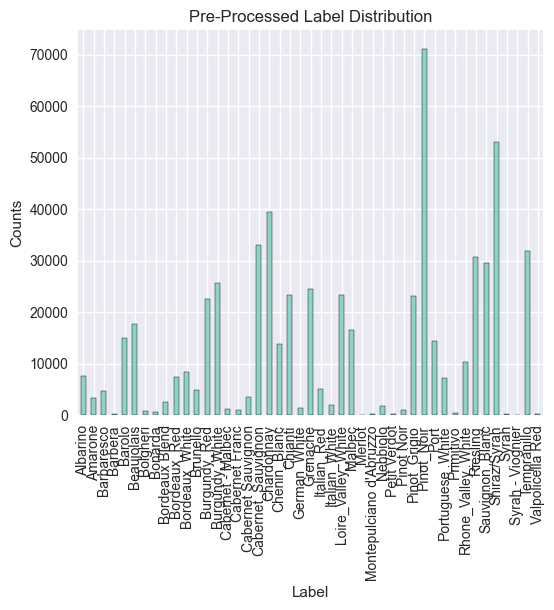

In [59]:
mpl.style.use('seaborn') 
sns.set_palette("Set3")
distribution = dataset.groupby('Label').count()['Full_Vintage_Name']
distribution = distribution[distribution.index!='Vino Nobile Di Montepulciano'] # too long

distribution.plot(kind='bar', title='Pre-Processed Label Distribution', ylabel='Counts',
         xlabel='Label', figsize=(6, 5)
                  ,edgecolor = "black"
                 )
plt.show()

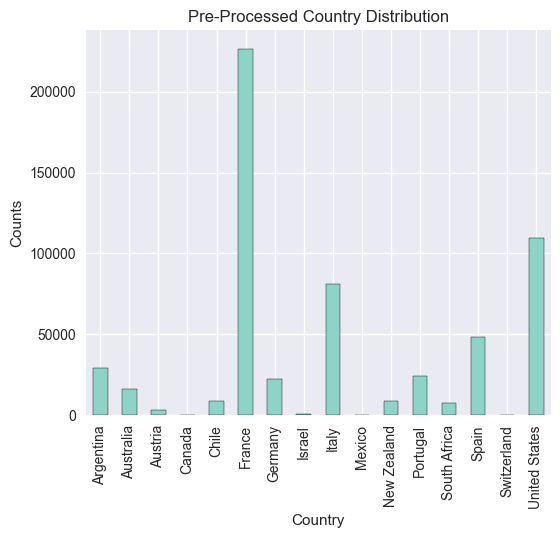

In [60]:
mpl.style.use('seaborn') 
sns.set_palette("Set3")
distribution = dataset.groupby('Country').count()['Full_Vintage_Name']

distribution.plot(kind='bar', title='Pre-Processed Country Distribution', ylabel='Counts',
         xlabel='Country', figsize=(6, 5)                  
                  ,edgecolor = "black")
plt.show()

In [61]:
dataset["Single_Most_Used_Grape"] = dataset["Most_Used_Grapes"].apply(lambda xyz:  xyz.split(",")[0])

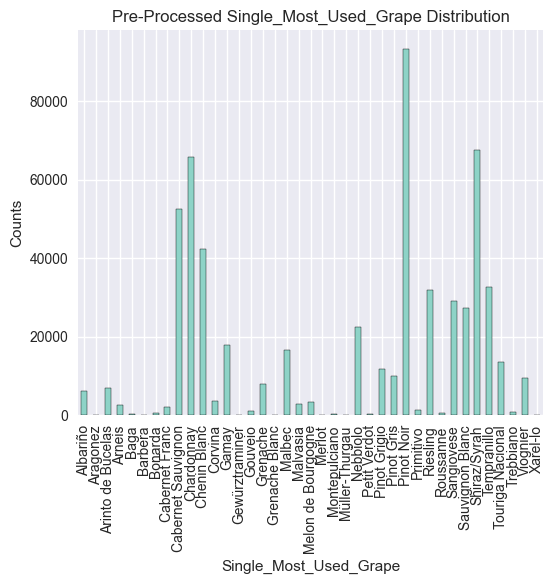

In [62]:
mpl.style.use("seaborn")
sns.set_palette("Set3")
distribution = dataset.groupby('Single_Most_Used_Grape').count()['Full_Vintage_Name']

distribution.plot(kind='bar', title='Pre-Processed Single_Most_Used_Grape Distribution', ylabel='Counts',
         xlabel='Single_Most_Used_Grape', figsize=(6, 5)
                                   ,edgecolor = "black")
plt.show()

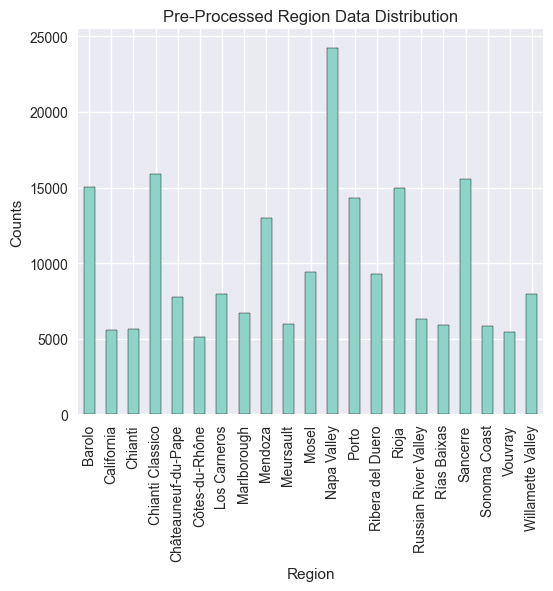

In [63]:
mpl.style.use('seaborn')
sns.set_palette("Set3")
distribution = dataset.groupby('Region').count()['Full_Vintage_Name'][dataset.groupby('Region').count()['Full_Vintage_Name']>5000]

distribution.plot(kind='bar', title='Pre-Processed Region Data Distribution', ylabel='Counts',
         xlabel='Region', figsize=(6, 5)
                  ,edgecolor = "black")
plt.show()

In [64]:
dataset[dataset.Price > 50000].Country.unique()

array(['United States'], dtype=object)

In [65]:
#sns.set_palette("rainbow")
#sns.boxplot(data=dataset, x="Type_ID", y="Price").set_title("Price BoxPlots Full Dataset - Pre Processing")
#plt.show()

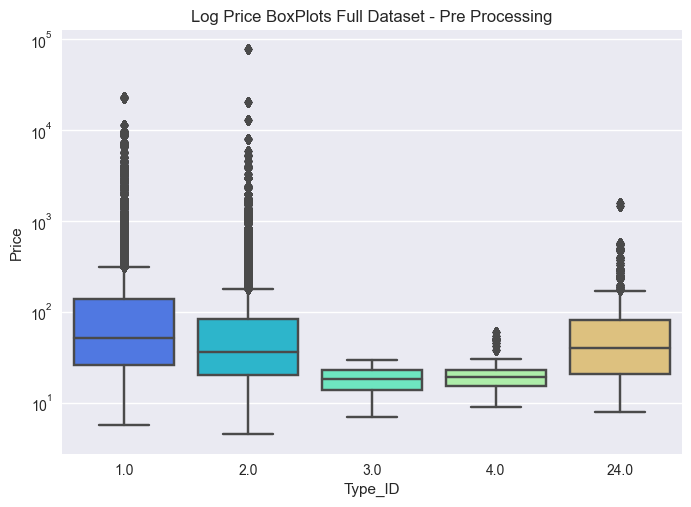

In [66]:
sns.set_palette("rainbow")
sns.boxplot(data=dataset, 
            x="Type_ID",
            y="Price"
           ).set_title("Log Price BoxPlots Full Dataset - Pre Processing")
plt.yscale('log')
plt.show()

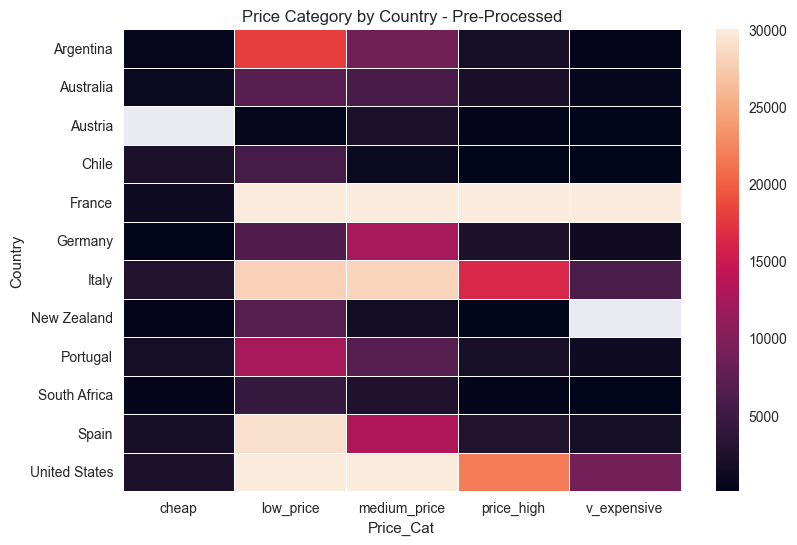

In [67]:
def Price_Cat(Price):
    if Price <= 10:
        price_cat = "cheap"
    elif Price > 10 and Price <= 30:
        price_cat = "low_price"
    elif Price > 30 and Price <= 100:
        price_cat = "medium_price"
    elif Price > 100 and Price <= 250:
        price_cat = "price_high"
    elif Price > 250:
        price_cat = "v_expensive"
    else:
        price_cat = "price_unknown"
    return price_cat

dataset["Price_Cat"] = dataset.Price.apply(Price_Cat)
dfp_price = dataset.pivot_table(index='Label', columns='Price_Cat', aggfunc='count')
dfp_price = dfp_price['Note']

filtered = dataset.groupby("Country").filter(lambda abc: len(abc) > 1500)
filtered = filtered[filtered.Price_Cat!="price_unknown"]
data_pivot = filtered.pivot_table(index="Country", columns="Price_Cat", aggfunc="count")
data_pivot = data_pivot['Acidity']
f, ax = plt.subplots(figsize=(9, 6))
ax.set_title('Price Category by Country - Pre-Processed')
sns.heatmap(data_pivot, 
#            annot=True, 
#            vmin=10000, 
            vmax=30000,
            linewidths=.5, 
            ax=ax)
plt.show()

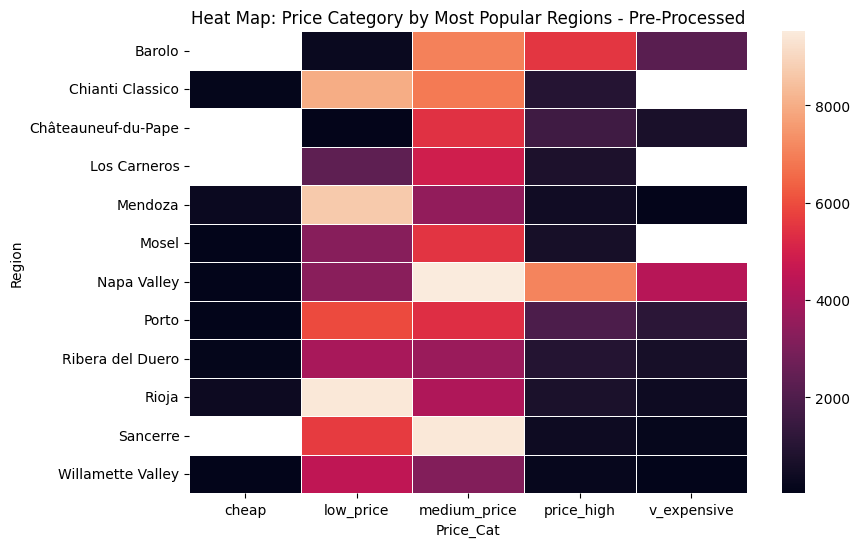

In [68]:
plt.style.use('default')

filtered = dataset.groupby("Region").filter(lambda abc: len(abc) > 7000)
filtered = filtered[filtered.Price_Cat!="price_unknown"]
data_pivot = filtered.pivot_table(index="Region", columns="Price_Cat", aggfunc="count")
data_pivot = data_pivot['Acidity']
f, ax = plt.subplots(figsize=(9, 6))
ax.set_title('Heat Map: Price Category by Most Popular Regions - Pre-Processed')
sns.heatmap(data_pivot, annot=False,             
            mask=data_pivot.isnull(),
#            vmax=10000,
#            vmin=4000,
            linewidths=.5, ax=ax)
plt.show()

<AxesSubplot:title={'center':'Heat Map: Price Category by Single_Most_Used_Grape - Pre-Processed'}, xlabel='Price_Cat', ylabel='Single_Most_Used_Grape'>

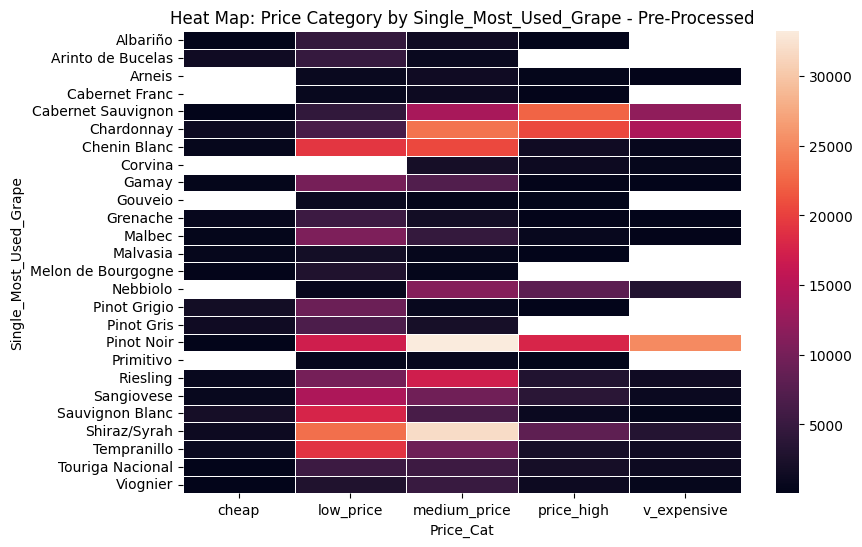

In [69]:
filtered = dataset.groupby("Single_Most_Used_Grape").filter(lambda abc: len(abc) > 1000)
filtered = filtered[filtered.Price_Cat!="price_unknown"]
data_pivot = filtered.pivot_table(index="Single_Most_Used_Grape", columns="Price_Cat", aggfunc="count")
data_pivot = data_pivot['Acidity']
f, ax = plt.subplots(figsize=(9, 6))
ax.set_title('Heat Map: Price Category by Single_Most_Used_Grape - Pre-Processed')
sns.heatmap(data_pivot, annot=False, linewidths=.5, ax=ax)

<AxesSubplot:title={'center':'Heat Map: French Regions by Price - Pre-Processed'}, xlabel='Price_Cat', ylabel='Region'>

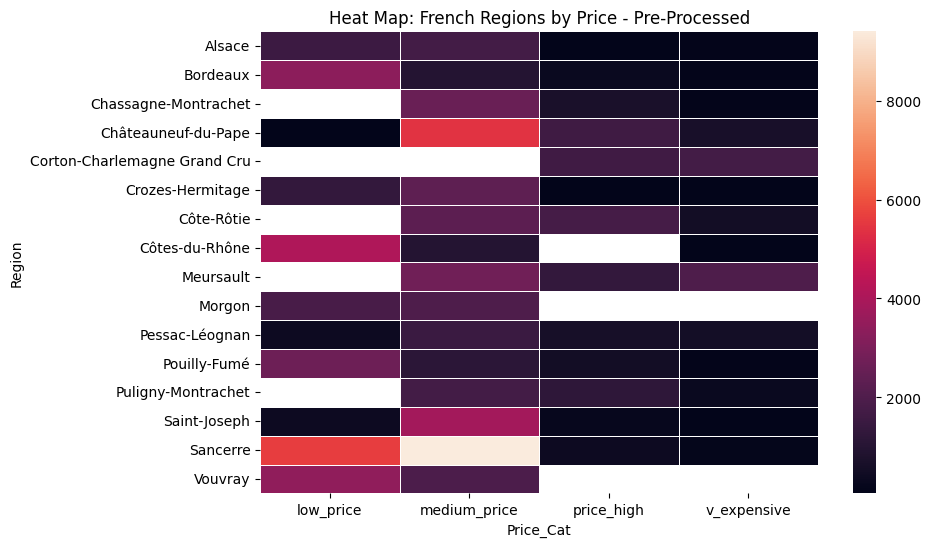

In [70]:
# heat map

filtered = dataset.groupby("Region").filter(lambda abc: len(abc) > 3000)

data_pivot = filtered[(filtered.Country=='France') & (filtered.Price_Cat!='cheap')].pivot_table(index=["Region"], columns="Price_Cat", aggfunc="count")
data_pivot = data_pivot['Acidity']
f, ax = plt.subplots(figsize=(9, 6))
ax.set_title("Heat Map: French Regions by Price - Pre-Processed")
sns.heatmap(data_pivot, annot=False, 
            linewidths=.5, ax=ax)

In [71]:
# Chianti Classico seems to use Trebbiano or Sangiovese
dataset[dataset.Single_Most_Used_Grape=='Trebbiano'].Label.unique()

array(['Pinot_Grigio', 'Sauvignon_Blanc', 'Italian_White', 'Chianti'],
      dtype=object)

In [72]:
dataset[dataset.Single_Most_Used_Grape=='Trebbiano'].groupby("Region").Price.describe()

,count,mean,std,min,25%,50%,75%,max
Region,,,,,,,,
Bolgheri,50.0,249.950000,5.742052e-14,249.950000,249.950000,249.950000,249.950000,249.950000
Chianti Classico,24.0,30.583333,0.000000e+00,30.583333,30.583333,30.583333,30.583333,30.583333
Marche,50.0,29.990000,0.000000e+00,29.990000,29.990000,29.990000,29.990000,29.990000
Soave Classico,50.0,22.990000,0.000000e+00,22.990000,22.990000,22.990000,22.990000,22.990000
Terre di Chieti,197.0,21.248883,1.007264e+01,11.990000,14.990000,19.990000,19.990000,37.990000
Toscana,321.0,52.101495,4.851855e+01,11.980000,13.990000,17.990000,74.500000,150.000000
Trebbiano d'Abruzzo,50.0,269.890000,5.742052e-14,269.890000,269.890000,269.890000,269.890000,269.890000
Umbria,148.0,75.372815,6.566566e+01,7.990000,7.990000,53.000000,163.333333,163.333333


In [73]:
dataset[dataset.Single_Most_Used_Grape=='Trebbiano'].groupby("Label").Price.describe()

,count,mean,std,min,25%,50%,75%,max
Label,,,,,,,,
Chianti,24.0,30.583333,0.000000,30.583333,30.583333,30.583333,30.583333,30.583333
Italian_White,349.0,139.841452,89.191035,29.990000,53.000000,150.000000,249.950000,269.890000
Pinot_Grigio,417.0,17.931942,8.588498,7.990000,11.990000,14.990000,19.990000,37.990000
Sauvignon_Blanc,100.0,44.245000,30.407419,13.990000,13.990000,44.245000,74.500000,74.500000


In [74]:
dataset[dataset.Label=='Pinot_Noir'].head()

,Full_Vintage_Name,Winery_Name,Vintage_Year,Short_Wine_Name,Type_ID,Region,Country,Price,Currency,Wine_ID,Average_Rating,Rating_Count,Varietal_Name,Body_Description,Acidity_Description,Food_Pairings,Most_Used_Grapes,Acidity,Intensity,Sweetness,Tannin,Primary_Keywords,User_Rating,Note,Created_At,Label,Single_Most_Used_Grape,Price_Cat
0,Peter Michael Clos du Ciel Pinot Noir 2014,Peter Michael,2014.0,Clos du Ciel Pinot Noir,1.0,Sonoma Coast,United States,189.0,USD,1183502.0,4.9,39.0,Pinot Noir,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.494742,3.16053,1.541248,2.20805,"black_fruit,red_fruit,earth,oak,spices,non_oak...",5.0,All of these PN from PM are so delicate and de...,2021-12-03T22:43:03.000Z,Pinot_Noir,Pinot Noir,price_high
1,Peter Michael Clos du Ciel Pinot Noir 2014,Peter Michael,2014.0,Clos du Ciel Pinot Noir,1.0,Sonoma Coast,United States,189.0,USD,1183502.0,4.9,39.0,Pinot Noir,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.494742,3.16053,1.541248,2.20805,"black_fruit,red_fruit,earth,oak,spices,non_oak...",4.5,Like a wine out of the night sky,2020-11-23T17:27:04.000Z,Pinot_Noir,Pinot Noir,price_high
2,Peter Michael Clos du Ciel Pinot Noir 2014,Peter Michael,2014.0,Clos du Ciel Pinot Noir,1.0,Sonoma Coast,United States,189.0,USD,1183502.0,4.9,39.0,Pinot Noir,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.494742,3.16053,1.541248,2.20805,"black_fruit,red_fruit,earth,oak,spices,non_oak...",5.0,Exceptional Pinot Noir which evolved significa...,2021-01-06T17:15:42.000Z,Pinot_Noir,Pinot Noir,price_high
3,Peter Michael Clos du Ciel Pinot Noir 2014,Peter Michael,2014.0,Clos du Ciel Pinot Noir,1.0,Sonoma Coast,United States,189.0,USD,1183502.0,4.9,39.0,Pinot Noir,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.494742,3.16053,1.541248,2.20805,"black_fruit,red_fruit,earth,oak,spices,non_oak...",5.0,"Some blackberry, raspberry, and black cherry, ...",2022-12-12T00:13:50.000Z,Pinot_Noir,Pinot Noir,price_high
4,Peter Michael Clos du Ciel Pinot Noir 2014,Peter Michael,2014.0,Clos du Ciel Pinot Noir,1.0,Sonoma Coast,United States,189.0,USD,1183502.0,4.9,39.0,Pinot Noir,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.494742,3.16053,1.541248,2.20805,"black_fruit,red_fruit,earth,oak,spices,non_oak...",4.5,"Great and complex Pinot\nNose is of leather, b...",2020-12-26T00:32:18.000Z,Pinot_Noir,Pinot Noir,price_high


<AxesSubplot:title={'center':'Heat Map: Region by Price - Cabernet_Sauvignon (Pre-Processed)'}, xlabel='Price_Cat', ylabel='Region-Country'>

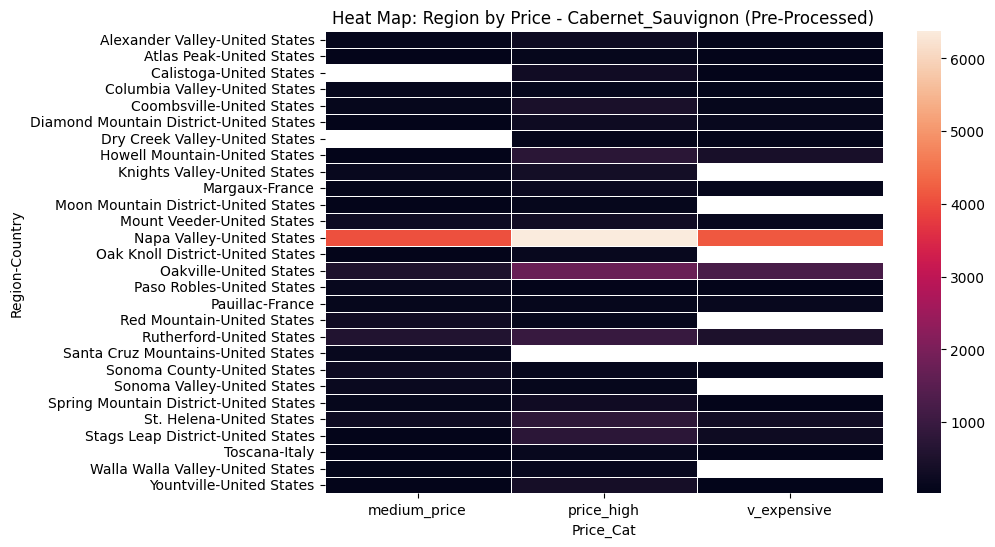

In [75]:
# heat map

filtered = dataset[dataset.Label=='Cabernet_Sauvignon'].groupby("Region").filter(lambda abc: len(abc) > 100)

data_pivot = filtered[(filtered.Label=='Cabernet_Sauvignon') & (filtered.Price_Cat != 'cheap')].pivot_table(index=["Region", "Country"], columns="Price_Cat", aggfunc="count")
data_pivot = data_pivot['Acidity']
f, ax = plt.subplots(figsize=(9, 6))
ax.set_title('Heat Map: Region by Price - Cabernet_Sauvignon (Pre-Processed)')
sns.heatmap(data_pivot, annot=False, linewidths=.5, ax=ax)

<AxesSubplot:title={'center':'Heat Map: Region by Price - Cabernet_Sauvignon (Pre-Processed)'}, xlabel='Price_Cat', ylabel='Region-Country'>

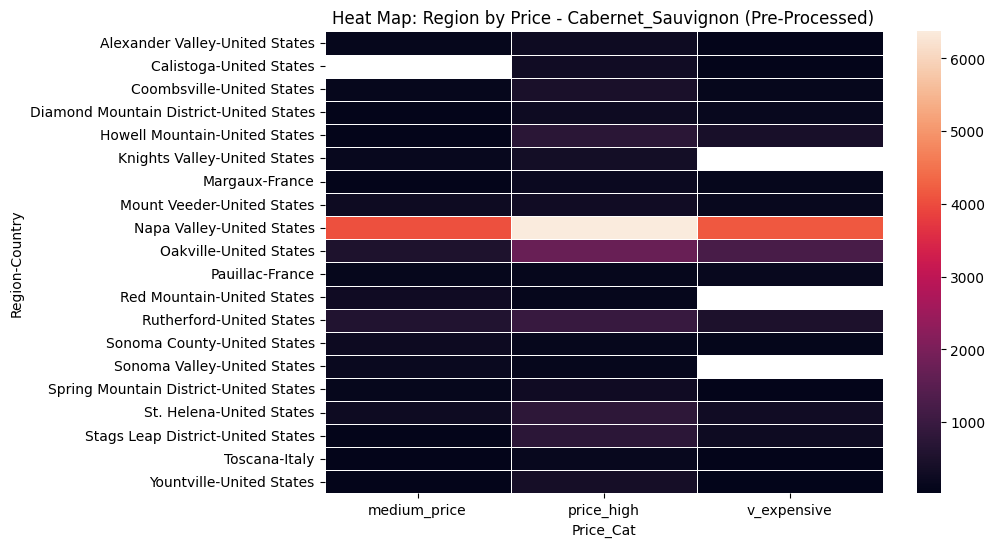

In [76]:
# heat map

filtered = dataset[dataset.Label=='Cabernet_Sauvignon'].groupby("Region").filter(lambda abc: len(abc) > 250)

data_pivot = filtered[(filtered.Label=='Cabernet_Sauvignon') & (filtered.Price_Cat != 'cheap')].pivot_table(index=["Region", "Country"], columns="Price_Cat", aggfunc="count")
data_pivot = data_pivot['Acidity']
f, ax = plt.subplots(figsize=(9, 6))
ax.set_title('Heat Map: Region by Price - Cabernet_Sauvignon (Pre-Processed)')
sns.heatmap(data_pivot, annot=False, linewidths=.5, ax=ax)

In [77]:
dataset.drop('Price_Cat', axis=1, inplace=True)

In [78]:
dataset.shape

(585952, 27)

In [79]:
dataset['Label'] = dataset.Label.str.replace(" ", "_")
dataset.loc[dataset.Label=='Syrah_-_Viognier', 'Label'] = 'Shiraz/Syrah'
dataset.loc[dataset.Label=='Syrah', 'Label'] = 'Shiraz/Syrah'

In [80]:
dataset.loc[dataset.Label=="Montepulciano_d'Abruzzo", 'Label'] = 'Italian_Red'
dataset.loc[dataset.Label=="Valpolicella_Red", 'Label'] = 'Italian_Red'
dataset.loc[dataset.Label=="Vino_Nobile_Di_Montepulciano", 'Label'] = 'Italian_Red'
dataset.loc[dataset.Label=='Nebbiolo', 'Label'] = 'Italian_Red'
dataset.loc[dataset.Label=='Amarone', 'Label'] = 'Italian_Red'
dataset.loc[dataset.Label=='Barbaresco', 'Label'] = 'Italian_Red'
dataset.loc[dataset.Label=='Brunello', 'Label'] = 'Italian_Red'
dataset.loc[dataset.Label=='Barolo', 'Label'] = 'Italian_Red'
dataset.loc[dataset.Label=='Primitivo', 'Label'] = 'Italian_Red' #aka zinfandel
dataset.loc[dataset.Label=='Bolgheri', 'Label'] = 'Italian_Red'
dataset.loc[dataset.Label=='Barbera', 'Label'] = 'Italian_Red'

In [81]:
dataset.loc[dataset.Label=='Bonarda', 'Label'] = 'Argentinian_Red'
dataset.loc[dataset.Label=='Cabernet_-_Malbec', 'Label'] = 'Argentinian_Red'
dataset.loc[dataset.Label=='Merlot', 'Label'] = 'Argentinian_Red'
dataset.loc[dataset.Label=='Petit_Verdot', 'Label'] = 'Argentinian_Red'
dataset.loc[dataset.Label=='Cabernet_Franc', 'Label'] = 'Argentinian_Red'
dataset.loc[dataset.Label=='Bordeaux_Blend', 'Label'] = 'Argentinian_Red'

In [82]:
dataset.loc[dataset.Label=="German_White"].Most_Used_Grapes.unique()

array(['Riesling'], dtype=object)

In [83]:
dataset.loc[dataset.Label=='German_White', 'Label'] = 'Riesling'

In [84]:
dataset.loc[(dataset.Label=="Albarino") & (dataset.Country=="Portugal")].shape[0]

1476

In [85]:
dataset.loc[(dataset.Label=="Albarino") & (dataset.Country=="Portugal"), 'Label'] = 'Portuguese_White'
dataset = dataset[dataset['Label'] != 'Albarino']

In [86]:
dataset.loc[(dataset.Label=="Pinot_Grigio") & (dataset.Country=="Italy")].shape[0]

12717

In [87]:
dataset.loc[(dataset.Label=="Sauvignon_Blanc") & (dataset.Country=="Italy"), 'Label'] = 'Italian_White'
dataset.loc[(dataset.Label=="Pinot_Grigio") & (dataset.Country=="Italy"), 'Label'] = 'Italian_White'

In [88]:
# drop duplicated Note where Label is pinot noir or cab sauv or charonnay or sauvignon blanc

In [89]:
# force the column's string column B to type 'category'  
dataset['Label_Category'] = dataset['Label'].astype('category') 

# define the valid categories: 
dataset['Label_Category'] = dataset['Label_Category'].cat.set_categories(dataset.Label.unique().tolist(), ordered=True) 

In [90]:
dataset.sort_values(["Note", "Label_Category"], inplace=True, ascending=False)

In [91]:
# remove duplicated Notes but get rid of the skewed pinots in favor of burgundy
dataset.drop_duplicates("Note", inplace=True)

In [92]:
dataset.Label.unique()

array(['Pinot_Noir', 'Chianti', 'Rhone_Valley_White', 'Grenache',
       'Cabernet_Sauvignon', 'Chenin_Blanc', 'Shiraz/Syrah',
       'Burgundy_Red', 'Italian_Red', 'Loire_Valley_White',
       'Burgundy_White', 'Beaujolais', 'Riesling', 'Tempranillo',
       'Chardonnay', 'Italian_White', 'Port', 'Sauvignon_Blanc', 'Malbec',
       'Bordeaux_White', 'Pinot_Grigio', 'Portuguese_White',
       'Bordeaux_Red', 'Argentinian_Red'], dtype=object)

In [93]:
len(dataset.Wine_ID.unique())

10714

In [94]:
dataset.shape

(503113, 28)

In [95]:
dataset.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,503113.000000,503113.000000,5.031130e+05,503113.000000,503113.000000,503113.000000,503113.000000,502428.000000,317621.000000,503113.000000
mean,2.006189,138.497806,2.251935e+06,3.528468,309.937326,3.603972,3.497845,1.797882,3.094170,4.104219
std,3.791006,949.037609,2.257354e+06,1.487918,2001.715529,0.630689,0.861310,0.595553,0.704391,0.561603
min,1.000000,4.500000,9.700000e+01,0.000000,10.000000,1.000000,1.000000,1.000000,1.279174,1.000000
25%,1.000000,21.990000,1.133761e+06,3.800000,35.000000,3.118067,2.963620,1.485986,2.480325,4.000000
50%,1.000000,40.790000,1.464138e+06,4.100000,78.000000,3.509447,3.586067,1.655954,3.253188,4.000000
75%,2.000000,99.000000,2.584879e+06,4.300000,213.000000,4.031465,4.116913,1.904036,3.588533,4.500000
max,24.000000,77500.000000,1.149844e+07,5.000000,162987.000000,5.000000,5.000000,5.000000,4.814000,5.000000


In [96]:
dataset[dataset.Label=='Pinot_Noir'].describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating
count,48571.0,48571.000000,4.857100e+04,48571.000000,48571.000000,48571.000000,48571.000000,48571.000000,48571.000000,48571.000000
mean,1.0,57.974290,2.699764e+06,3.534432,364.589158,3.612450,2.782706,1.562204,2.166874,4.109755
std,0.0,152.218335,2.602183e+06,1.488648,5238.897443,0.287923,0.428737,0.200381,0.210665,0.536999
min,1.0,8.990000,1.150000e+02,0.000000,10.000000,2.646839,1.231121,1.000000,1.279174,1.000000
25%,1.0,26.150000,1.141982e+06,3.900000,34.000000,3.407931,2.435107,1.435825,2.071906,4.000000
50%,1.0,39.666667,1.763285e+06,4.000000,82.000000,3.517851,2.919091,1.552027,2.138564,4.000000
75%,1.0,50.000000,4.298555e+06,4.300000,188.000000,3.855310,3.087744,1.677338,2.224049,4.500000
max,1.0,4898.000000,1.142358e+07,4.900000,162987.000000,4.683422,4.504314,2.689254,4.474684,5.000000


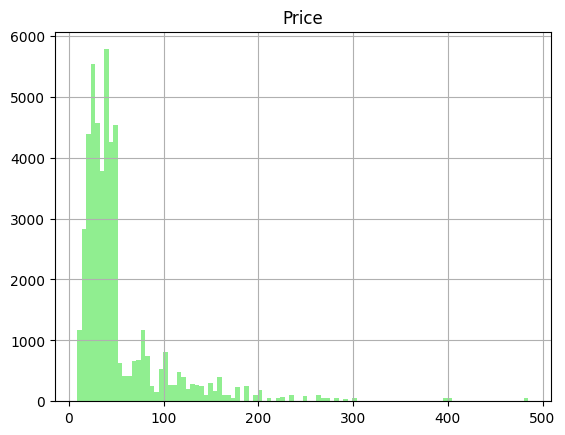

In [97]:
hist_plt = dataset[(dataset.Label=='Pinot_Noir') & (dataset.Price < 1000)].hist('Price', 
                                                                                bins=100, 
                                                                                color='lightgreen')


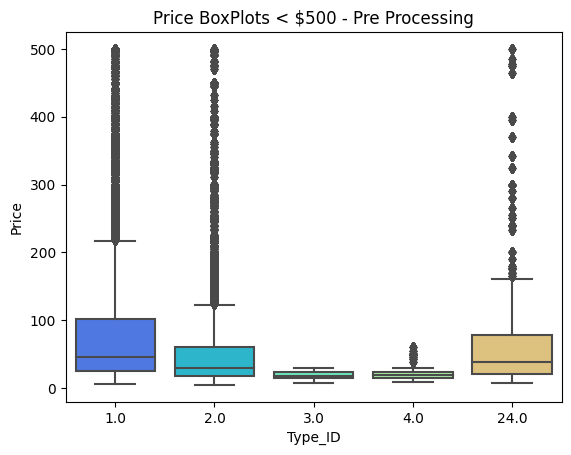

In [98]:
sns.set_palette("rainbow")
sns.boxplot(data=dataset[dataset.Price < 500], x="Type_ID", y="Price").set_title("Price BoxPlots < $500 - Pre Processing")
plt.show()

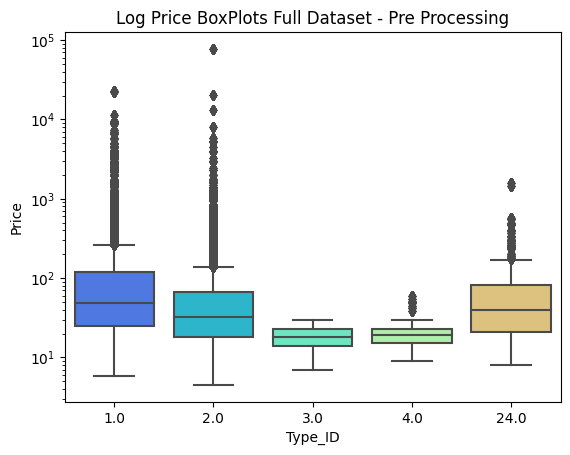

In [99]:
sns.set_palette("rainbow")
sns.boxplot(data=dataset, 
            x="Type_ID",
            y="Price"
           ).set_title("Log Price BoxPlots Full Dataset - Pre Processing")
plt.yscale('log')
plt.show()

In [100]:
dataset['Price'].describe()

count    503113.000000
mean        138.497806
std         949.037609
min           4.500000
25%          21.990000
50%          40.790000
75%          99.000000
max       77500.000000
Name: Price, dtype: float64

In [101]:
dataset['Price'].describe()['mean']+1*dataset['Price'].describe()['std']

1087.5354148973047

In [102]:
#subset = dataset.groupby("Single_Most_Used_Grape").filter(lambda abc: len(abc) > 14000)
#subset = subset.groupby("Country").filter(lambda abc: len(abc) > 10000)
#subset = subset.sample(frac=0.1)

In [103]:
#len(subset.Country.unique())

In [104]:
#len(subset.Single_Most_Used_Grape.unique())

In [105]:
subset = dataset[dataset.Price > 1000]

In [106]:
subset.shape

(7389, 28)

In [107]:
# https://www.codecademy.com/article/seaborn-design-ii
# 12 differentiables seem to be oob avail.

#plt.style.use('default')
#sns.set_palette("Paired")

#sns_scatter = sns.catplot(data=subset
#                                , x="Country"
#                                , y="Price"
#                                , hue="Single_Most_Used_Grape",s=1,height=8.27,aspect=11.7/8.27,kind='swarm'
#               ).set(title='Costly Wines : Price by Country\nLabeled by Grapes')

#plt.legend(loc='center left', bbox_to_anchor=(1., 0.5), ncol=1)
#plt.xticks(rotation=90)
#plt.show()
#plt.show()

In [108]:
dataset = dataset[dataset['Price'] < 1000]

In [109]:
dataset['Review_Term_Count'] = dataset.Note.apply(lambda xyz: len(xyz.split(" ")))

In [110]:
dataset['Review_Term_Count'].describe()

count    495525.000000
mean         24.449987
std          20.605469
min           1.000000
25%           9.000000
50%          19.000000
75%          32.000000
max         521.000000
Name: Review_Term_Count, dtype: float64

In [111]:
dataset.shape

(495525, 29)

In [112]:
dataset = dataset[dataset.Review_Term_Count > 9]

In [113]:
dataset.shape

(364191, 29)

In [114]:
dataset[dataset.Label=='Pinot_Noir'].head()

,Full_Vintage_Name,Winery_Name,Vintage_Year,Short_Wine_Name,Type_ID,Region,Country,Price,Currency,Wine_ID,Average_Rating,Rating_Count,Varietal_Name,Body_Description,Acidity_Description,Food_Pairings,Most_Used_Grapes,Acidity,Intensity,Sweetness,Tannin,Primary_Keywords,User_Rating,Note,Created_At,Label,Single_Most_Used_Grape,Label_Category,Review_Term_Count
1862,Salentein Reserve Pinot Noir (Barrel Selection...,Salentein,2014.0,Reserve Pinot Noir (Barrel Selection),1.0,Uco Valley,Argentina,27.165833,USD,1125266.0,3.8,1638.0,Pinot Noir,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.117686,2.766976,1.611607,1.859822,"red_fruit,oak,non_oak,earth,spices,black_fruit...",4.3,🥡➕🍷👌🏼\nBeautiful ruby color. Delightful straw...,2022-08-13T02:18:40.000Z,Pinot_Noir,Pinot Noir,Pinot_Noir,22
1945,Greywacke Pinot Noir 2017,Greywacke,2017.0,Pinot Noir,1.0,Marlborough,New Zealand,46.950000,USD,1130869.0,3.9,476.0,Pinot Noir,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.905255,2.372074,1.650709,2.279706,"red_fruit,oak,earth,non_oak,spices,black_fruit...",4.0,"🤑 This was a solid Pinot, with an outrageous t...",2016-11-21T10:59:56.000Z,Pinot_Noir,Pinot Noir,Pinot_Noir,50
1724,Louis Jadot Bourgogne Pinot Noir 2020,Louis Jadot,2020.0,Bourgogne Pinot Noir,1.0,Bourgogne,France,22.040000,USD,1135000.0,3.8,1825.0,Red,Light-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.915389,2.491596,1.328623,2.251655,"red_fruit,earth,oak,non_oak,black_fruit,spices...",4.0,🙂가성비굿. clear pale ruby color. mid+ aroma of ra...,2021-02-03T10:52:22.000Z,Pinot_Noir,Pinot Noir,Pinot_Noir,24
2130,Anthill Farms Anderson Valley Pinot Noir 2020,Anthill Farms,2020.0,Anderson Valley Pinot Noir,1.0,Anderson Valley,United States,39.770000,USD,85726.0,4.1,69.0,Pinot Noir,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.507259,2.820748,1.540924,2.088952,"red_fruit,earth,oak,non_oak,spices,black_fruit...",4.5,😻\n\nEverything I want in a Pinot. Leaning on ...,2018-12-29T03:04:41.000Z,Pinot_Noir,Pinot Noir,Pinot_Noir,14
1930,Stoller Family Estate Dundee Hills Pinot Noir ...,Stoller Family Estate,2021.0,Dundee Hills Pinot Noir,1.0,Dundee Hills,United States,34.990000,USD,1810194.0,4.0,93.0,Pinot Noir,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.821323,2.145821,1.518369,2.125803,"red_fruit,oak,earth,non_oak,spices,black_fruit...",3.7,"😉 medium ruby \n👃 light red fruit, smoky rasp...",2022-06-11T02:21:33.000Z,Pinot_Noir,Pinot Noir,Pinot_Noir,36


In [115]:
pinot_regions = dataset[dataset.Label=='Pinot_Noir'].groupby("Region").count()['Full_Vintage_Name']

In [116]:
high_pinot_regions = pinot_regions[pinot_regions>2000]

In [117]:
high_pinot_regions

Region
Los Carneros            2546
Russian River Valley    3913
Sonoma Coast            3412
Willamette Valley       3844
Name: Full_Vintage_Name, dtype: int64

In [118]:
dataset.shape

(364191, 29)

In [119]:
dataset.reset_index(drop=True, inplace=True)

In [120]:
subset=dataset.sample(frac=0.05)

In [121]:
#subset.groupby(["Primary_Keywords", "Single_Most_Used_Grape"]).count() # differ for sure

In [122]:
#dataset.groupby(["Food_Pairings", "Single_Most_Used_Grape"]).count().head() # dont differ

In [123]:
dataset.head()

,Full_Vintage_Name,Winery_Name,Vintage_Year,Short_Wine_Name,Type_ID,Region,Country,Price,Currency,Wine_ID,Average_Rating,Rating_Count,Varietal_Name,Body_Description,Acidity_Description,Food_Pairings,Most_Used_Grapes,Acidity,Intensity,Sweetness,Tannin,Primary_Keywords,User_Rating,Note,Created_At,Label,Single_Most_Used_Grape,Label_Category,Review_Term_Count
0,Champalou Vouvray 2021,Champalou,2021,Vouvray,2.0,Vouvray,France,23.950000,USD,1172337.0,4.2,197.0,Chenin Blanc,Medium-bodied,High,"Rich fish (salmon, tuna etc),Vegetarian,Poultr...",Chenin Blanc,4.870948,2.103069,1.545856,NaN,"tree_fruit,earth,citrus_fruit,microbio,oak,tro...",3.5,"🧐 light yellow\n🤥 citrus\n😛 honey, pear, citr...",2021-07-28T20:26:39.000Z,Chenin_Blanc,Chenin Blanc,Chenin_Blanc,29
1,Ferraton Père & Fils Crozes-Hermitage La Matin...,Ferraton Père & Fils,2019,Crozes-Hermitage La Matinière Rouge,1.0,Crozes-Hermitage,France,49.990000,USD,1981094.0,3.9,208.0,Crozes-Hermitage,Full-bodied,High,"Beef,Lamb,Game (deer, venison),Poultry",Shiraz/Syrah,3.203937,3.900221,1.455665,3.252711,"black_fruit,spices,earth,oak,red_fruit,non_oak...",4.5,"🧐 hazy deep ruby \n🥸 clean medium dark fruit, ...",2022-11-26T01:59:54.000Z,Shiraz/Syrah,Shiraz/Syrah,Shiraz/Syrah,47
2,Domaine Gros Frère et Soeur Grands Échezeaux G...,Domaine Gros Frère et Soeur,2008.0,Grands Échezeaux Grand Cru,1.0,Grands-Échezeaux Grand Cru,France,511.723449,USD,1604529.0,4.5,31.0,Côte de Nuits Red,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.980351,3.242306,1.858555,2.736865,"red_fruit,earth,oak,black_fruit,spices,non_oak...",4.5,🧐 You can definitely feel the iron and iron ox...,2020-08-23T19:00:07.000Z,Burgundy_Red,Pinot Noir,Burgundy_Red,74
3,Domaine Anne Gros Clos-Vougeot Grand Cru Le Gr...,Domaine Anne Gros,2017.0,Clos-Vougeot Grand Cru Le Grand Maupertui,1.0,Clos Vougeot Grand Cru,France,290.000000,USD,1137843.0,4.5,70.0,Côte de Nuits Red,Medium-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.987614,3.050063,1.840154,2.585082,"red_fruit,earth,oak,black_fruit,spices,non_oak...",4.5,🧐 When the top quality grape meets the experti...,2020-11-10T21:52:03.000Z,Burgundy_Red,Pinot Noir,Burgundy_Red,73
4,Domaine Joseph Voillot Volnay 1er Cru 'Les Cha...,Domaine Joseph Voillot,2017.0,Volnay 1er Cru 'Les Champans',1.0,Volnay 1er Cru 'Champans',France,109.000000,USD,22332.0,4.4,74.0,Côte de Beaune Red,Light-bodied,High,"Beef,Veal,Game (deer, venison),Poultry",Pinot Noir,3.852422,2.547341,1.526751,2.076521,"red_fruit,earth,oak,non_oak,black_fruit,microb...",4.5,🧐 Very good balance. Not the simplest wine.\nB...,2020-05-30T20:28:47.000Z,Burgundy_Red,Pinot Noir,Burgundy_Red,60


In [124]:
#no longer used. this would even the distribution of pinot noir regions by removing 1000 points from los carneros.
#remove_n = 1000
#los_carneros_pinots = dataset[(dataset['Label'] == 'Pinot_Noir') & (dataset['Region'] == high_pinot_regions[0])]
#drop_indices = np.random.choice(los_carneros_pinots.index, remove_n, replace=False)
#dataset = dataset.drop(drop_indices)

In [125]:
dataset.reset_index(drop=True, inplace=True)

In [126]:
dataset.loc[dataset.Region=='Chianti Classico', 'Region'] = 'Chianti'

# turn type id 4 into Rosé
# turn type id 24 into Port, type id 1
# drop type id 3

dataset.loc[(dataset.Type_ID==4), 'Label'] = 'Rosé'
dataset.loc[(dataset.Type_ID==24), 'Type_ID'] = 1
dataset = dataset[dataset.Type_ID!=3]

dataset.loc[dataset.Type_ID==4, 'Type_Cat'] = 'Rosé'
dataset.loc[dataset.Type_ID==1, 'Type_Cat'] = 'Red'
dataset.loc[dataset.Type_ID==2, 'Type_Cat'] = 'White'

dataset["Other_Grapes"] = dataset["Most_Used_Grapes"].apply(lambda xyz: ",".join(xyz.split(",")[1:]))

In [127]:
dataset[dataset.Label=='Pinot_Noir'].groupby("Region").count()["Type_ID"].describe()

count     142.000000
mean      242.457746
std       597.528807
min         1.000000
25%        35.000000
50%        45.500000
75%       170.500000
max      3913.000000
Name: Type_ID, dtype: float64

In [128]:
print(dataset.shape)

(363729, 31)


In [129]:
counts = dataset['Region'].value_counts()
dataset = dataset[~dataset['Region'].isin(counts[counts < 100].index)]

In [130]:
print(dataset.shape)

(344789, 31)


In [131]:
# randomly remove some shirax, tempranillo, riesling, pinot noir, italian red, cabernet sauvignon

dataset.reset_index(drop=True, inplace=True)

remove_n = 5000
label_focus = 'Cabernet_Sauvignon'

condition = dataset[(dataset['Label'] == label_focus)]
drop_indices = np.random.choice(condition.index, remove_n, replace=False)
dataset = dataset.drop(drop_indices)

In [132]:
# randomly remove some shirax, tempranillo, riesling, pinot noir, italian red, cabernet sauvignon

dataset.reset_index(drop=True, inplace=True)

remove_n = 5000
label_focus = 'Italian_Red'

condition = dataset[(dataset['Label'] == label_focus)]
drop_indices = np.random.choice(condition.index, remove_n, replace=False)
dataset = dataset.drop(drop_indices)

In [133]:
# randomly remove some shirax, tempranillo, riesling, pinot noir, italian red, cabernet sauvignon

dataset.reset_index(drop=True, inplace=True)

remove_n = 10000
label_focus = 'Pinot_Noir'

condition = dataset[(dataset['Label'] == label_focus)]
drop_indices = np.random.choice(condition.index, remove_n, replace=False)
dataset = dataset.drop(drop_indices)

In [134]:
# randomly remove some shirax, tempranillo, riesling, pinot noir, italian red, cabernet sauvignon

dataset.reset_index(drop=True, inplace=True)

remove_n = 7000
label_focus = 'Shiraz/Syrah'

condition = dataset[(dataset['Label'] == label_focus)]
drop_indices = np.random.choice(condition.index, remove_n, replace=False)
dataset = dataset.drop(drop_indices)

In [135]:
# randomly remove some shirax, tempranillo, riesling, pinot noir, italian red, cabernet sauvignon

dataset.reset_index(drop=True, inplace=True)

remove_n = 2000
label_focus = 'Tempranillo'

condition = dataset[(dataset['Label'] == label_focus)]
drop_indices = np.random.choice(condition.index, remove_n, replace=False)
dataset = dataset.drop(drop_indices)

In [136]:
# randomly remove some shirax, tempranillo, riesling, pinot noir, italian red, cabernet sauvignon

dataset.reset_index(drop=True, inplace=True)

remove_n = 2000
label_focus = 'Riesling'

condition = dataset[(dataset['Label'] == label_focus)]
drop_indices = np.random.choice(condition.index, remove_n, replace=False)
dataset = dataset.drop(drop_indices)

In [137]:
dataset.shape

(313789, 31)

In [138]:
# how to get where most_used_grapes is a single value?

In [139]:
dataset["Single_Most_Used_Grape"] = dataset["Most_Used_Grapes"].apply(lambda xyz: 
                                                                      xyz.split(",")[0])

In [140]:
dataset[['Most_Used_Grapes', 'Single_Most_Used_Grape']].head(1)

,Most_Used_Grapes,Single_Most_Used_Grape
0,Chenin Blanc,Chenin Blanc


In [141]:
dataset[dataset['Most_Used_Grapes']!=dataset['Single_Most_Used_Grape']][['Label', 'Region', 'Full_Vintage_Name', 'Most_Used_Grapes', 'Single_Most_Used_Grape']].head(1)

,Label,Region,Full_Vintage_Name,Most_Used_Grapes,Single_Most_Used_Grape
5,Loire_Valley_White,Sancerre,Henri Bourgeois Sancerre Etienne Henri 2017,"Chenin Blanc,Sauvignon Blanc",Chenin Blanc


In [142]:
# randomly remove some shirax, tempranillo, riesling, pinot noir, italian red, cabernet sauvignon

dataset.reset_index(drop=True, inplace=True)

remove_n = 50000
country_focus = 'France'

condition = dataset[(dataset['Country'] == country_focus)]
drop_indices = np.random.choice(condition.index, remove_n, replace=False)
dataset = dataset.drop(drop_indices)

In [143]:
# randomly remove some shirax, tempranillo, riesling, pinot noir, italian red, cabernet sauvignon

dataset.reset_index(drop=True, inplace=True)

remove_n = 2000
region_focus = 'Porto'

condition = dataset[(dataset['Region'] == region_focus)]
drop_indices = np.random.choice(condition.index, remove_n, replace=False)
dataset = dataset.drop(drop_indices)

In [144]:
# randomly remove some shirax, tempranillo, riesling, pinot noir, italian red, cabernet sauvignon

dataset.reset_index(drop=True, inplace=True)

remove_n = 2000
region_focus = 'Napa Valley'

condition = dataset[(dataset['Region'] == region_focus)]
drop_indices = np.random.choice(condition.index, remove_n, replace=False)
dataset = dataset.drop(drop_indices)

In [145]:
# randomly remove some shirax, tempranillo, riesling, pinot noir, italian red, cabernet sauvignon

dataset.reset_index(drop=True, inplace=True)

remove_n = 2000
region_focus = 'Chianti'

condition = dataset[(dataset['Region'] == region_focus)]
drop_indices = np.random.choice(condition.index, remove_n, replace=False)
dataset = dataset.drop(drop_indices)

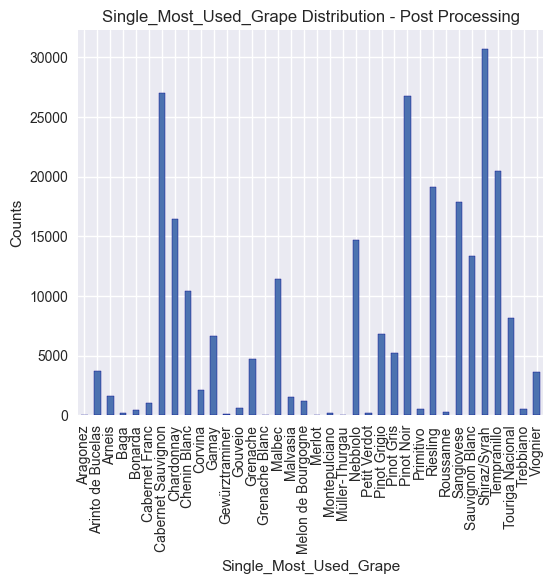

In [146]:
sns.set_palette("Set1")
plt.style.use('seaborn')

#fig, ax = plt.subplots()

distribution = dataset.groupby('Single_Most_Used_Grape').count()['Full_Vintage_Name']

ax = distribution.plot(kind='bar', title='Single_Most_Used_Grape Distribution - Post Processing', ylabel='Counts',
         xlabel='Single_Most_Used_Grape', figsize=(6, 5)
                  ,edgecolor = "darkblue")

#plt.setp(ax.patches, linewidth=-1)
plt.show()

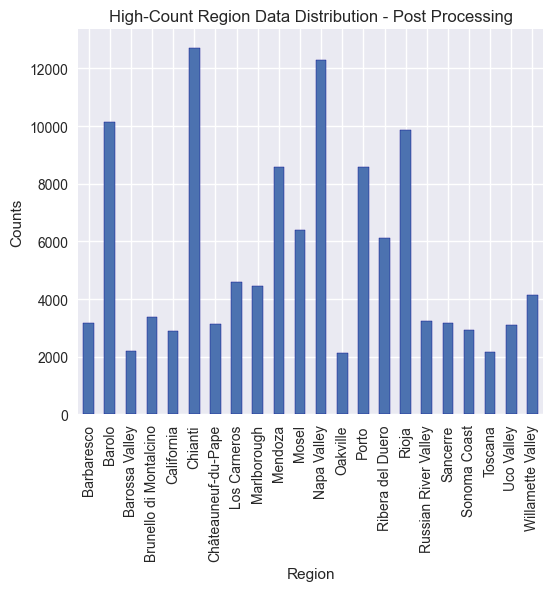

In [147]:
sns.set_palette("Set1")
plt.style.use('seaborn')

distribution = dataset.groupby('Region').count()['Full_Vintage_Name'][dataset.groupby('Region').count()['Full_Vintage_Name']>2000]

distribution.plot(kind='bar', title='High-Count Region Data Distribution - Post Processing', ylabel='Counts',
         xlabel='Region', figsize=(6, 5)
                  ,edgecolor = "darkblue")
plt.show()

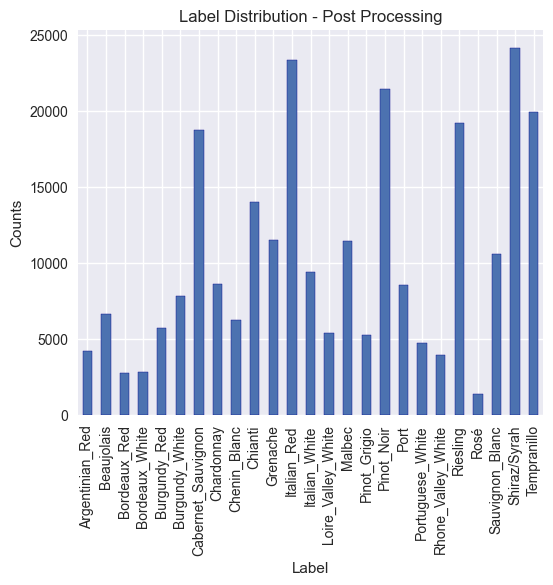

In [148]:
sns.set_palette("Set1")
plt.style.use('seaborn')

distribution = dataset.groupby('Label').count()['Full_Vintage_Name']

distribution.plot(kind='bar', title='Label Distribution - Post Processing', ylabel='Counts',
         xlabel='Label', figsize=(6, 5)
                  ,edgecolor = "darkblue")
plt.show()

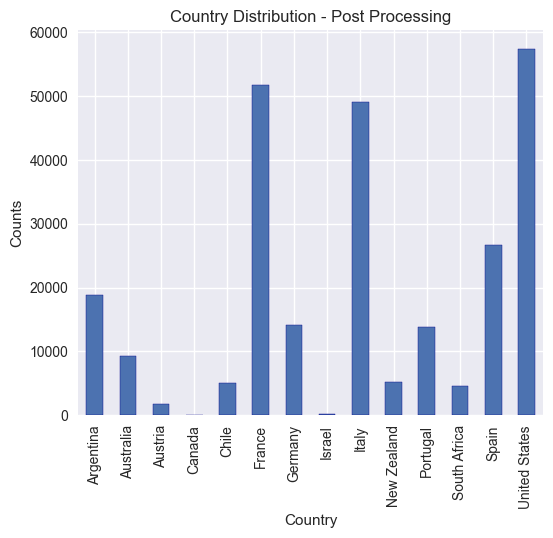

In [149]:
sns.set_palette("Set1")
plt.style.use('seaborn')
distribution = dataset.groupby('Country').count()['Full_Vintage_Name']

distribution.plot(kind='bar', title='Country Distribution - Post Processing', ylabel='Counts',
         xlabel='Country', figsize=(6, 5)
                  ,edgecolor = "darkblue")
plt.show()

In [150]:
#df1 = dataset[dataset['Most_Used_Grapes']==dataset['Single_Most_Used_Grape']][['Most_Used_Grapes', 'Single_Most_Used_Grape']].head(100)
#df1 = dataset.copy()
#mask = df1.Most_Used_Grapes==df1.Single_Most_Used_Grape
#df1.loc[mask, 'Label'] = df1.loc[mask, 'Single_Most_Used_Grape']

In [151]:
# cleanup
#del(dataset)
#dataset = df1
#del(df1)

In [152]:
dataset[dataset.duplicated(subset=["Note"])].shape

(0, 31)

In [153]:
dataset.describe()

,Type_ID,Price,Wine_ID,Average_Rating,Rating_Count,Acidity,Intensity,Sweetness,Tannin,User_Rating,Review_Term_Count
count,257789.000000,257789.000000,2.577890e+05,257789.000000,257789.000000,257789.000000,257789.000000,257789.000000,163948.000000,257789.000000,257789.000000
mean,1.341314,83.564011,2.196695e+06,3.615817,374.947158,3.593757,3.561803,1.836915,3.179503,4.091756,30.967182
std,0.506340,119.813507,2.229257e+06,1.389462,2413.430036,0.642070,0.831373,0.627341,0.688885,0.534104,20.010767
min,1.000000,4.500000,9.700000e+01,0.000000,10.000000,1.000000,1.000000,1.000000,1.279174,1.000000,10.000000
25%,1.000000,21.332500,1.128759e+06,3.800000,39.000000,3.091650,2.996349,1.501676,2.667779,4.000000,17.000000
50%,1.000000,39.990000,1.415774e+06,4.100000,92.000000,3.503636,3.676793,1.674695,3.330410,4.000000,25.000000
75%,2.000000,89.990000,2.499839e+06,4.300000,250.000000,4.021718,4.196062,1.946253,3.630907,4.500000,38.000000
max,4.000000,999.990000,1.149844e+07,4.900000,162987.000000,5.000000,5.000000,5.000000,4.814000,5.000000,521.000000


In [154]:
null_meta_dataset = pd.DataFrame([dataset.isnull().sum()],
            ).T

null_meta_dataset.rename(columns={0:"NumberOfNulls"}, inplace=True)
null_meta_dataset['PercentMissing'] = round(100*null_meta_dataset.NumberOfNulls/dataset.shape[0], 2)

In [155]:
null_meta_dataset

,NumberOfNulls,PercentMissing
Full_Vintage_Name,0,0.00
Winery_Name,0,0.00
Vintage_Year,79,0.03
Short_Wine_Name,0,0.00
Type_ID,0,0.00
Region,0,0.00
Country,0,0.00
Price,0,0.00
Currency,0,0.00
Wine_ID,0,0.00


## !

In [156]:
dataset.Varietal_Name = dataset.Varietal_Name.str.replace(" ", "_")
dataset.Body_Description = dataset.Body_Description.str.replace(" ", "_")
dataset.Body_Description = dataset.Body_Description.str.replace("-", "_")
dataset.Winery_Name = dataset.Winery_Name.str.replace(" ", "_")

In [157]:
plt.style.use('seaborn')
sns.set_palette("summer_r")

In [158]:
def Acidity_Cat(Acidity):
    if Acidity < 3.0:
        acidity_cat = "low_acidity"
    elif Acidity >= 3.0 and Acidity < 4.0:
        acidity_cat = "medium_acidity"
    elif Acidity >= 4.0:
        acidity_cat = "high_acidity"
    else:
        acidity_cat = ""
    return acidity_cat

In [159]:
dataset["Acidity_Cat"] = dataset.Acidity.apply(Acidity_Cat)

In [160]:
dataset.groupby("Acidity_Cat").count()['Full_Vintage_Name']

Acidity_Cat
high_acidity       66890
low_acidity        45515
medium_acidity    145384
Name: Full_Vintage_Name, dtype: int64

In [161]:
dfp = dataset.pivot_table(index='Label', columns='Acidity_Cat', aggfunc='count')
dfp = dfp['Note']
dfp.fillna(0, inplace=True)

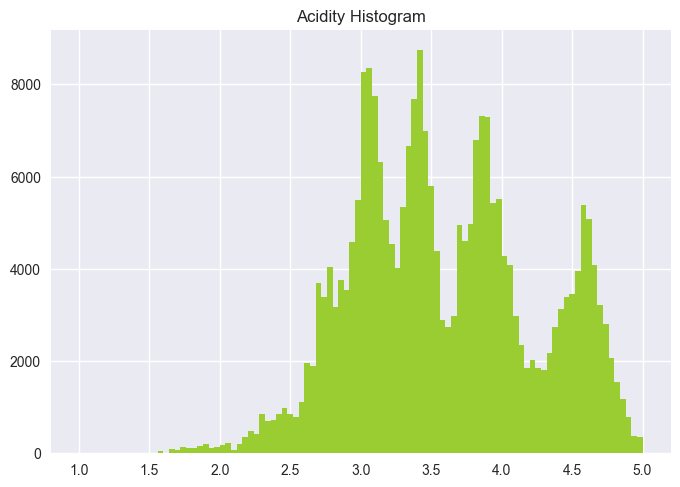

In [162]:
sns.set_palette("Set1")
plt.style.use('seaborn')
dataset.Acidity.hist(bins=100, color='yellowgreen')
plt.title("Acidity Histogram")
plt.show()

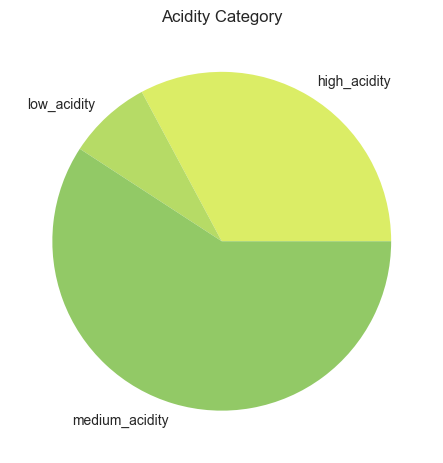

In [163]:
plt.style.use('seaborn')
sns.set_palette("summer_r")
acidity_plot = dataset.pivot_table(index='Acidity_Cat', 
                    columns='Label', 
                    aggfunc='count')['Acidity']['Argentinian_Red'].plot(kind='pie', 
                                                                        title='Acidity Category',
                                                                        ylabel='')

In [164]:
dfp[::3]

Acidity_Cat,high_acidity,low_acidity,medium_acidity
Label,,,
Argentinian_Red,1381.0,336.0,2490.0
Bordeaux_White,0.0,1150.0,1657.0
Cabernet_Sauvignon,80.0,884.0,17791.0
Chianti,601.0,0.0,13403.0
Italian_White,110.0,4489.0,4788.0
Pinot_Grigio,0.0,4960.0,293.0
Portuguese_White,2463.0,906.0,1357.0
Rosé,52.0,102.0,1202.0
Tempranillo,143.0,3820.0,15972.0


In [165]:
# filtering to avoid overcrowding
dfp2 = dfp.apply(lambda x: np.where(x < x.quantile()+10, 0, x))

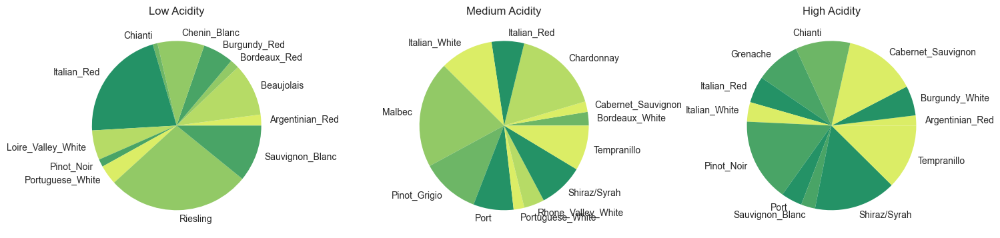

In [166]:
plt.style.use('seaborn')
sns.set_palette("summer_r")

dfp2.plot(kind='pie', 
         subplots=True,
         rot=0,
         figsize=(15, 7)
         ,layout=(2, 3),
         legend=False,
         ylabel='',
         title = ['Low Acidity', 'Medium Acidity', 'High Acidity']
        )

plt.tight_layout()

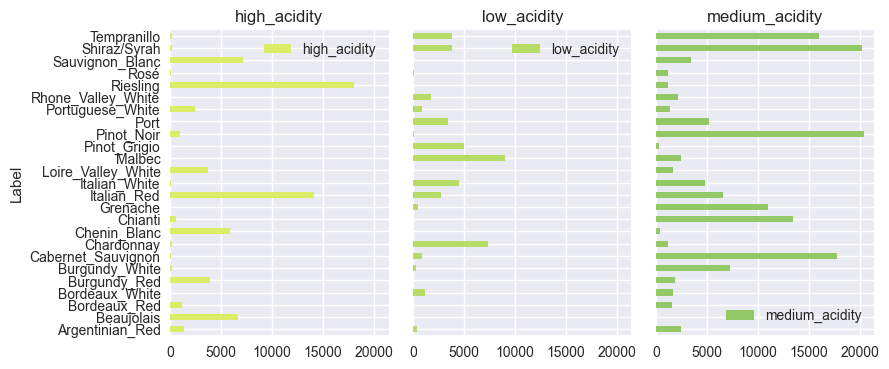

In [167]:
dfp.plot(kind='barh', subplots=True,
         rot=0,
         figsize=(9, 7)
         ,layout=(2, 3),
         sharey=True
        )
plt.tight_layout()

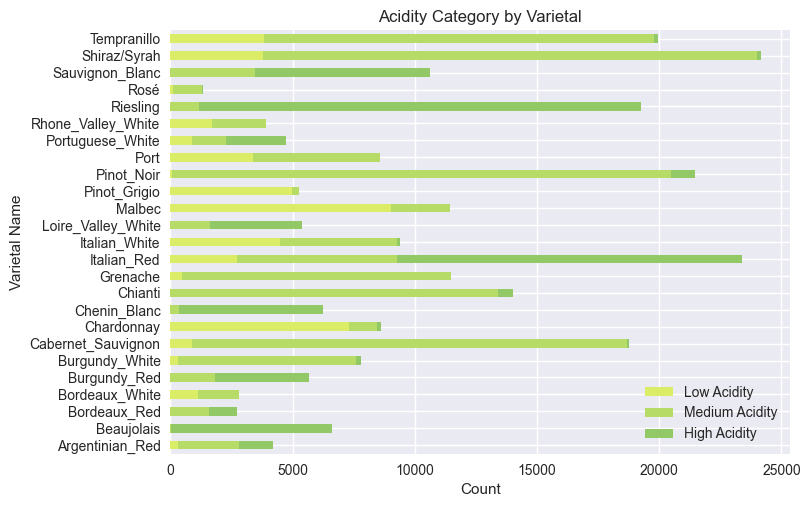

In [168]:
df = dfp.unstack().reset_index()
df.rename(columns={0:"Count"}, inplace=True)

plotdata = pd.DataFrame({
    "Low Acidity":df[df.Acidity_Cat=="low_acidity"].Count.tolist(),
    "Medium Acidity":df[df.Acidity_Cat=="medium_acidity"].Count.tolist(),
    "High Acidity":df[df.Acidity_Cat=="high_acidity"].Count.tolist()
    }, 
    index=df[df.Acidity_Cat=="low_acidity"].Label.tolist()
)

plotdata.plot(kind="barh", stacked=True)
plt.title("Acidity Category by Varietal")
plt.xlabel("Count")
plt.ylabel("Varietal Name")
plt.show()

In [169]:
plt.style.use('seaborn')
sns.set_palette("plasma")

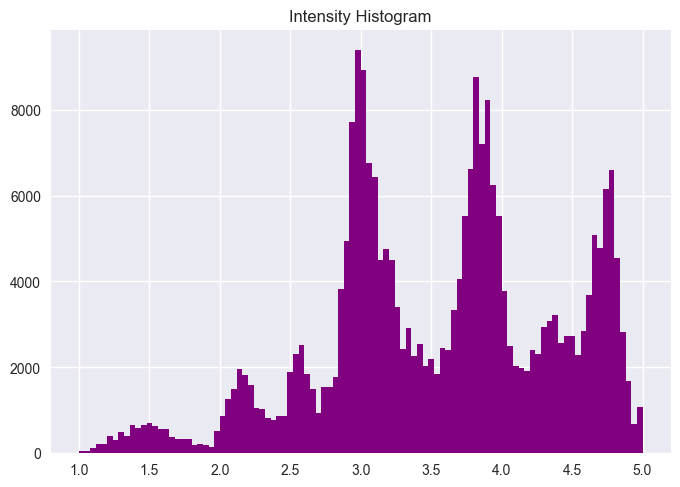

In [170]:
intensity_hist = dataset.Intensity.hist(bins=100, color='purple')
plt.title("Intensity Histogram")
plt.show()

In [171]:
def Intensity_Cat(Intensity):
    if Intensity <= 3.25:
        intensity_cat = "low_intensity"
    elif Intensity > 3.25 and Intensity <= 4.25:
        intensity_cat = "medium_intensity"
    elif Intensity > 4.25:
        intensity_cat = "high_intensity"
    else:
        intensity_cat = ""
    return intensity_cat

In [172]:
dataset["Intensity_Cat"] = dataset.Intensity.apply(Intensity_Cat)

In [173]:
dfp_intensity = dataset.pivot_table(index='Label', columns='Intensity_Cat', aggfunc='count')
dfp_intensity = dfp_intensity['Note']
dfp_intensity.fillna(0, inplace=True)

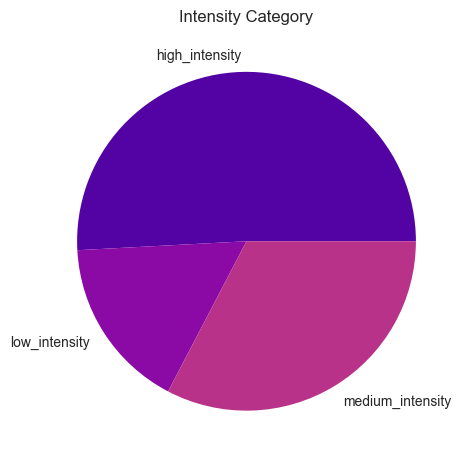

In [174]:
intensity_plot = dataset.pivot_table(index='Intensity_Cat', 
                    columns='Label', 
                    aggfunc='count')['Intensity']['Argentinian_Red'].plot(kind='pie', 
                                                                        title='Intensity Category',
                                                                        ylabel='')

Text(0, 0.5, 'Varietal Name')

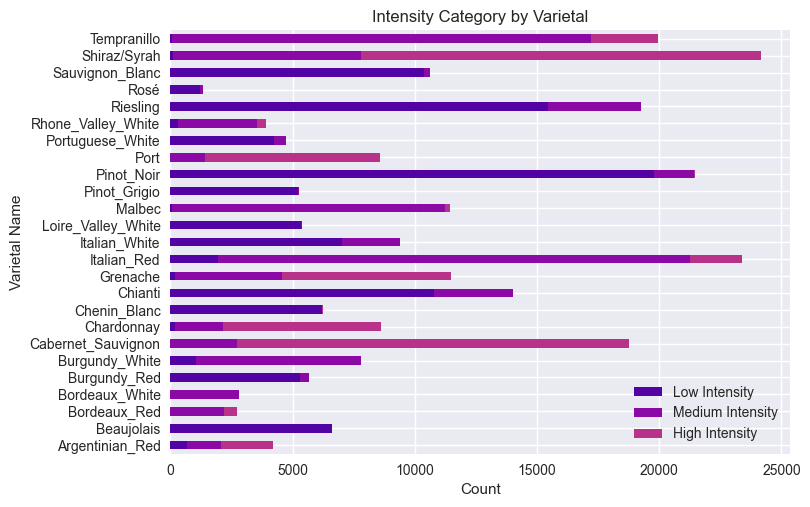

In [175]:
df_intensity = dfp_intensity.unstack().reset_index()
df_intensity.rename(columns={0:"Count"}, inplace=True)

plotdata = pd.DataFrame({
    "Low Intensity":df_intensity[df_intensity.Intensity_Cat=="low_intensity"].Count.tolist(),
    "Medium Intensity":df_intensity[df_intensity.Intensity_Cat=="medium_intensity"].Count.tolist(),
    "High Intensity":df_intensity[df_intensity.Intensity_Cat=="high_intensity"].Count.tolist()
    }, 
    index=df_intensity[df_intensity.Intensity_Cat=="low_intensity"].Label.tolist()
)

plotdata.plot(kind="barh", stacked=True)
plt.title("Intensity Category by Varietal")
plt.xlabel("Count")
plt.ylabel("Varietal Name")

## Tannin

In [176]:
plt.style.use('seaborn')
sns.set_palette("rocket")

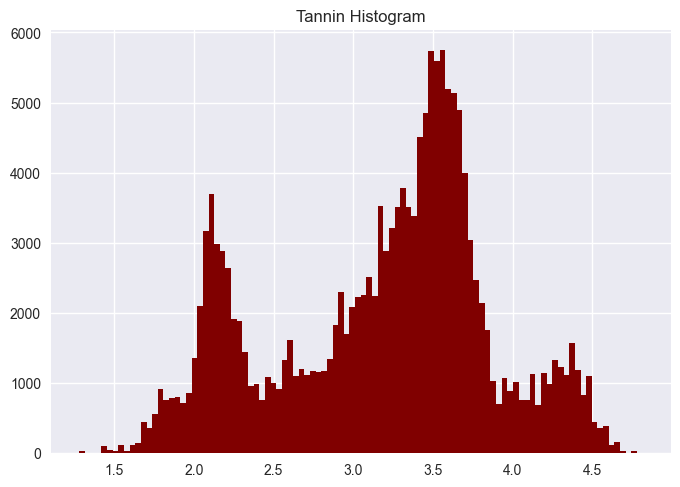

In [177]:
dataset.Tannin.hist(bins=100, color='maroon')
plt.title("Tannin Histogram")
plt.show()

In [178]:
def Tannin_Cat(Tannin):
    if Tannin <= 3.0:
        tannin_cat = "low_tannin"
    elif Tannin > 3.0 and Tannin <= 3.25:
        tannin_cat = "medium_tannin"
    elif Tannin > 3.25 and Tannin < 3.75:
        tannin_cat = "moderate_tannin"
    elif Tannin > 3.75:
        tannin_cat = "high_tannin"
    else:
        tannin_cat = "tannin_unspecified"
    return tannin_cat

In [179]:
dataset["Tannin_Cat"] = dataset.Tannin.apply(Tannin_Cat)
dfp_tannin = dataset.pivot_table(index='Label', columns='Tannin_Cat', aggfunc='count')
dfp_tannin = dfp_tannin['Note']

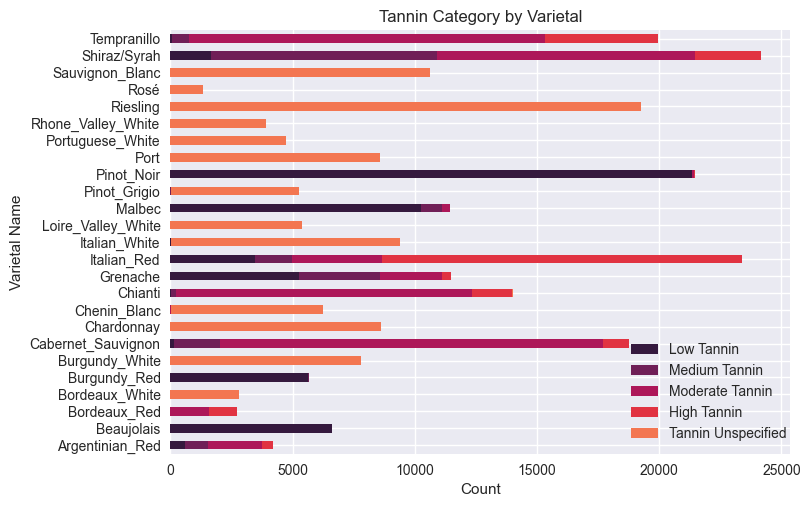

In [180]:
df_tannin = dfp_tannin.unstack().reset_index()
df_tannin.rename(columns={0:"Count"}, inplace=True)

plotdata = pd.DataFrame({
    "Low Tannin":df_tannin[df_tannin.Tannin_Cat=="low_tannin"].Count.tolist(),
    "Medium Tannin":df_tannin[df_tannin.Tannin_Cat=="medium_tannin"].Count.tolist(),
    "Moderate Tannin":df_tannin[df_tannin.Tannin_Cat=="moderate_tannin"].Count.tolist()
    ,"High Tannin":df_tannin[df_tannin.Tannin_Cat=="high_tannin"].Count.tolist()
    ,"Tannin Unspecified":df_tannin[df_tannin.Tannin_Cat=="tannin_unspecified"].Count.tolist()
    }, 
    index=df_tannin[df_tannin.Tannin_Cat=="low_tannin"].Label.tolist()
)

plotdata.plot(kind="barh", stacked=True)
plt.title("Tannin Category by Varietal")
plt.xlabel("Count")
plt.ylabel("Varietal Name")
plt.legend(loc='lower right', bbox_to_anchor=(1.015, .001))
plt.show()

## Sweetness

In [181]:
sns.set_palette("pink")

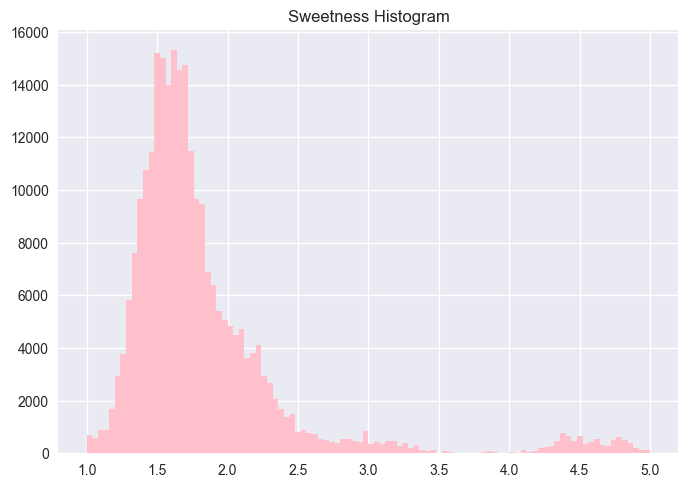

In [182]:
dataset.Sweetness.hist(bins=100, color='pink')
plt.title("Sweetness Histogram")
plt.show()

In [183]:
dataset[(dataset.Label=='Sauvignon_Blanc') & (dataset.Sweetness<1.5)][dataset[(dataset.Label=='Sauvignon_Blanc') & (dataset.Sweetness < 1.5)].Note.str.contains('sweet')].Note.values.tolist()[0:50]

['🔎 very pale lemon with a little spritz. \n\n👃 mineral nose, salinity and wet stone, and maybe some chlorine.\n\n👅sweet entry and some juicy citrus presenting in the middle, some tropical notes of passionfruit, crisp- acidity, and nice full mouth feel. Pleasant finish',
 '🍷 pale yellow\n\n👃🏼 the smell of this was pretty awful to me, instantly reminded me of cat urine, but I assume that’s from the grapefruit. I can get a bit of pear, hay, and green apple.\n\n🍷 a rather acidic wine, not particularly sweet and strong aromas of citrus. Not much going on and lacks depth and complexity.',
 '“Citrus flavors with a hint of green gras and a dry, crisp finish. Too sweet',
 'well played @[1|9701795|Marco Suarez]... wonderfully sweet  grapefruit minerals. exceptional wine. ',
 "tropical on nose a lot\n lime on palate\nIt's a bit sweet\nLovely inexpensive delicious  sauvignon blanc 😋",
 'sweet, yummy, nice by itself, doesn’t leave your mouth feeling dry',
 'sweet and hard on the minerals, prickly 

In [184]:
# half of these are saying it's very sweet. and half are saying it's badly too sweet. and half not sweet at all.
# in other words it is unclear what this sweetness rating indicates
# shouldn't be sweet but is sweet? sweet in a bad way? too sweet, therefore 1 star? ATA

In [185]:
def Sweetness_Cat(Sweetness):
    if Sweetness <= 1.5:
        sweetness_cat = "low_sweet_rating"
    elif Sweetness > 1.5 and Sweetness <= 1.75:
        sweetness_cat = "low_medium_sweet_rating"
    elif Sweetness > 1.75 and Sweetness <= 2.00:
        sweetness_cat = "medium_sweet_rating"
    elif Sweetness > 2.00 and Sweetness <= 3.0:
        sweetness_cat = "medium_high_sweet_rating"
    elif Sweetness > 3.0:
        sweetness_cat = "high_sweet_rating"
    else:
        sweetness_cat = "sweetness_unspecified"
    return sweetness_cat

In [186]:
dataset["Sweetness_Cat"] = dataset.Sweetness.apply(Sweetness_Cat)
dfp_sweet = dataset.pivot_table(index='Label', columns='Sweetness_Cat', aggfunc='count')
dfp_sweet = dfp_sweet['Note']

In [187]:
dataset.pivot_table(index='Sweetness_Cat', 
                    columns='Label', 
                    aggfunc='count')#['Sweetness']['Argentinian_Red']

Acidity                          \
Label                    Argentinian_Red Beaujolais Bordeaux_Red   
Sweetness_Cat                                                      
high_sweet_rating                    NaN        NaN          NaN   
low_medium_sweet_rating            840.0     3015.0       2015.0   
low_sweet_rating                   258.0     3108.0        190.0   
medium_high_sweet_rating          1370.0      125.0         19.0   
medium_sweet_rating               1739.0      384.0        521.0   

                                                                     \
Label                    Bordeaux_White Burgundy_Red Burgundy_White   
Sweetness_Cat                                                         
high_sweet_rating                   NaN          NaN            NaN   
low_medium_sweet_rating          1160.0       2774.0         3857.0   
low_sweet_rating                  101.0       1067.0         1931.0   
medium_high_sweet_rating          260.0        349.0          296.0   
medium_sweet_rating              1286.0       1502.0         1721.0   

                                                                             \
Label                    Cabernet_Sauvignon Chardonnay Chenin_Blanc Chianti   
Sweetness_Cat                                                                 
high_sweet_rating                       NaN      560.0         14.0     NaN   
low_medium_sweet_rating             10194.0      127.0       2208.0  4828.0   
low_sweet_rating                     3680.0       75.0       2743.0  8194.0   
medium_high_sweet_rating              875.0     7712.0        679.0    82.0   
medium_sweet_rating                  4006.0      146.0        603.0   900.0   

                                                             \
Label                    Grenache Italian_Red Italian_White   
Sweetness_Cat                                                 
high_sweet_rating             NaN      2076.0          40.0   
low_medium_sweet_rating    5665.0     11780.0        2780.0   
low_sweet_rating           2444.0      5516.0         319.0   
medium_high_sweet_rating    740.0       919.0        2317.0   
medium_sweet_rating        2633.0      3091.0        3931.0   

                                                                             \
Label                    Loire_Valley_White  Malbec Pinot_Grigio Pinot_Noir   
Sweetness_Cat                                                                 
high_sweet_rating                       NaN     NaN          NaN        NaN   
low_medium_sweet_rating               593.0   190.0       1200.0    10561.0   
low_sweet_rating                     4759.0     7.0         54.0     7603.0   
medium_high_sweet_rating                NaN  9009.0       1492.0      554.0   
medium_sweet_rating                    22.0  2244.0       2507.0     2735.0   

                                                                               \
Label                       Port Portuguese_White Rhone_Valley_White Riesling   
Sweetness_Cat                                                                   
high_sweet_rating         8566.0             40.0                NaN   1016.0   
low_medium_sweet_rating      NaN           1603.0              782.0   4442.0   
low_sweet_rating             NaN           2480.0              989.0   2561.0   
medium_high_sweet_rating     NaN             15.0             1627.0   8132.0   
medium_sweet_rating          NaN            588.0              510.0   3086.0   

                                                                          \
Label                      Rosé Sauvignon_Blanc Shiraz/Syrah Tempranillo   
Sweetness_Cat                                                              
high_sweet_rating           NaN             NaN          NaN         NaN   
low_medium_sweet_rating    73.0          2428.0       8110.0      9125.0   
low_sweet_rating          395.0          8039.0       4109.0      3271.0   
medium_high_sweet_rating  724.0            

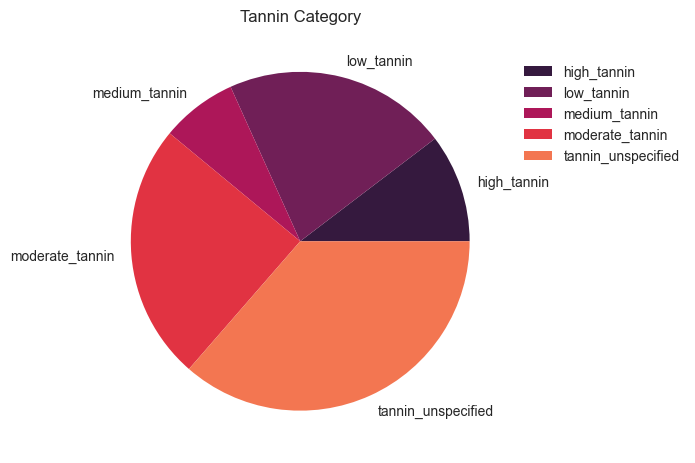

In [188]:
plt.style.use('seaborn')
sns.set_palette("rocket")

dataset["Sweetness_Cat"] = dataset.Sweetness.apply(Sweetness_Cat)
dfp_sweet = dataset.pivot_table(index='Label', columns='Sweetness_Cat', aggfunc='count')
dfp_sweet = dfp_sweet['Note']

df_tannin = dfp_tannin.unstack().reset_index()
df_tannin.rename(columns={0:"Count"}, inplace=True)

df_tannin.pivot_table(index='Tannin_Cat', 
                    aggfunc='sum').plot(kind='pie', 
                                        y='Count',
                                        title='Tannin Category',
                                        ylabel='')

plt.legend(loc='center left', bbox_to_anchor=(1., .8), ncol=1)
plt.show()

In [189]:
def cool_pie_chart_helper(TYPE_ID=None):
    """
    Creates a cool multi-dimensional pie chart using 
    colors that are easier on the eyes
    under various conditions
    """
    ANCHOR_Y = 0.6
    
    if TYPE_ID == None:
        acid_sweet_pie = dataset.pivot_table(index='Acidity_Cat', 
                    columns=['Sweetness_Cat'], 
                    aggfunc='count')['Acidity']
    else:
        acid_sweet_pie = dataset[dataset.Type_ID==TYPE_ID].pivot_table(index='Acidity_Cat', 
                            columns=['Sweetness_Cat'], 
                            aggfunc='count')['Acidity']

    acid_sweet_pie.fillna(0, inplace=True)

    sizes_col = acid_sweet_pie.loc['high_acidity',].values.tolist() + \
                   acid_sweet_pie.loc['low_acidity',].values.tolist() + \
                   acid_sweet_pie.loc['medium_acidity',].values.tolist()
    
    labels_sweet = acid_sweet_pie.columns.tolist()

    labels_col = labels_sweet + labels_sweet + labels_sweet
    colors_col = ['#9e7bb5', '#c2c2f0','#CCCCFF', '#be93d4', '#D8BFD8',
                  '#9e7bb5', '#c2c2f0','#CCCCFF', '#be93d4', '#D8BFD8',
                  '#9e7bb5', '#c2c2f0','#CCCCFF', '#be93d4', '#D8BFD8'
                 ]

    # high_sweet_rating, low_medium, low, medium_high, medium

    acid_sweet_pie['Total'] = acid_sweet_pie.sum(axis=1)
    sizes = acid_sweet_pie.Total.values.tolist()
    labels = acid_sweet_pie.index.values.tolist()

    colors = ['#ADD8E6', '#A7C7E7', '#96DED1']

    color_labels = colors + colors_col[0:5]
    labels_color = labels + labels_col[0:5]
    legend_labels = dict(zip(labels_color, color_labels))

    # https://medium.com/@kvnamipara/a-better-visualisation-of-pie-charts-by-matplotlib-935b7667d77f
    plt.pie(sizes, labels=labels, colors=colors, startangle=90,frame=True)
    plt.pie(sizes_col,
            colors=colors_col,
            radius=0.75,
            startangle=90)

    centre_circle = plt.Circle((0,0),
                               0.5,
                               color='black', 
                               fc='white',
                               linewidth=0)

    if TYPE_ID == 2:
        TYPE_CAT = "White"
    elif TYPE_ID == 1 :
        TYPE_CAT = "Red"
        ANCHOR_Y += 0.2
    else:
        TYPE_CAT = "All"
        ANCHOR_Y += 0.3
        
    fig = plt.gcf()
    fig.gca().add_artist(centre_circle)
    
    if TYPE_ID == 2:
        leg = plt.legend(legend_labels.keys(), bbox_to_anchor=(1.3, ANCHOR_Y))

    plt.axis('equal')
    plt.tight_layout()
    plt.title(f'Derived Categorical Sweetness by Acidity - {TYPE_CAT} Wines')
    plt.show()

In [190]:
plt.style.use('ggplot') 

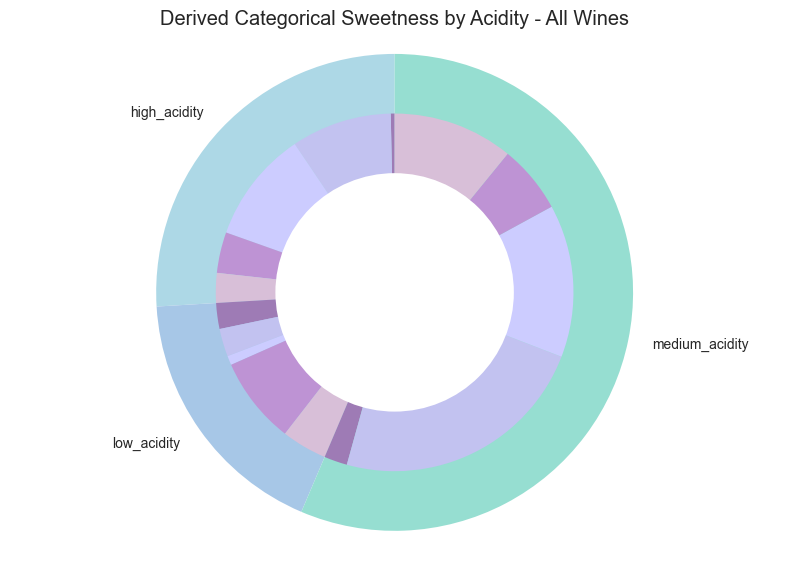

In [191]:
cool_pie_chart_helper()

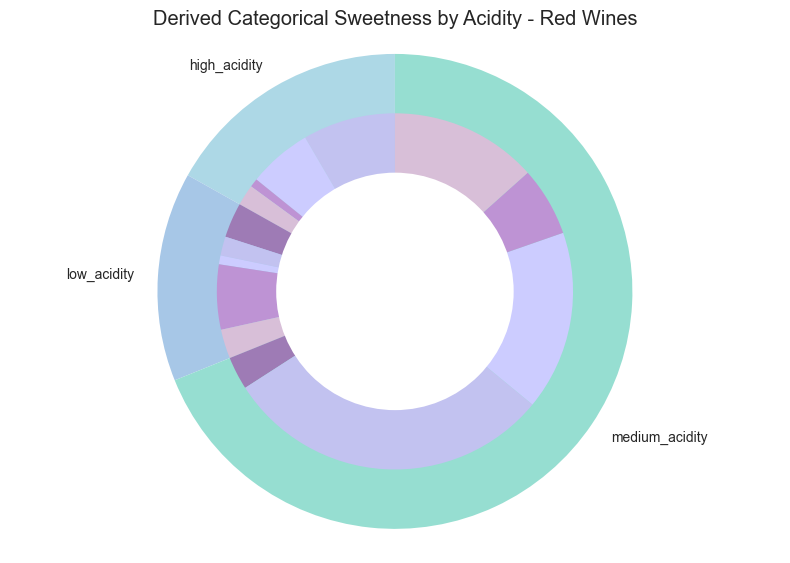

In [192]:
plt.style.use('ggplot') 
cool_pie_chart_helper(1)

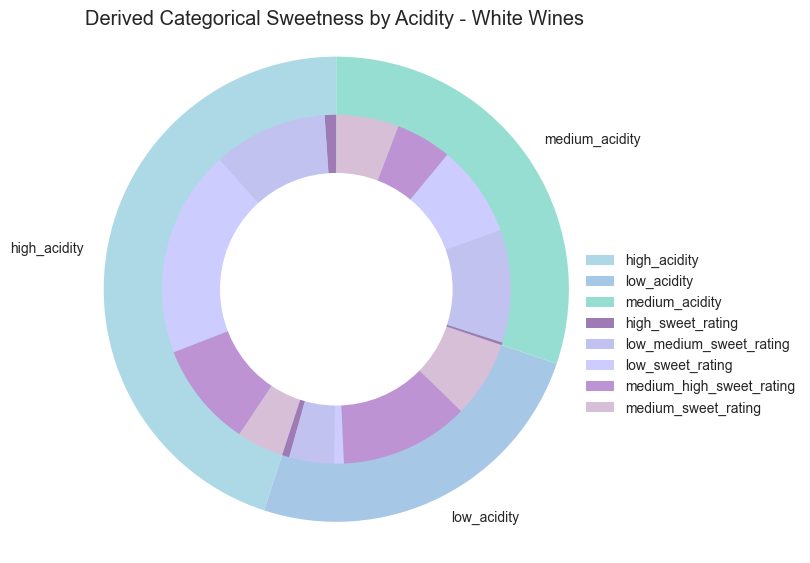

In [193]:
cool_pie_chart_helper(2)

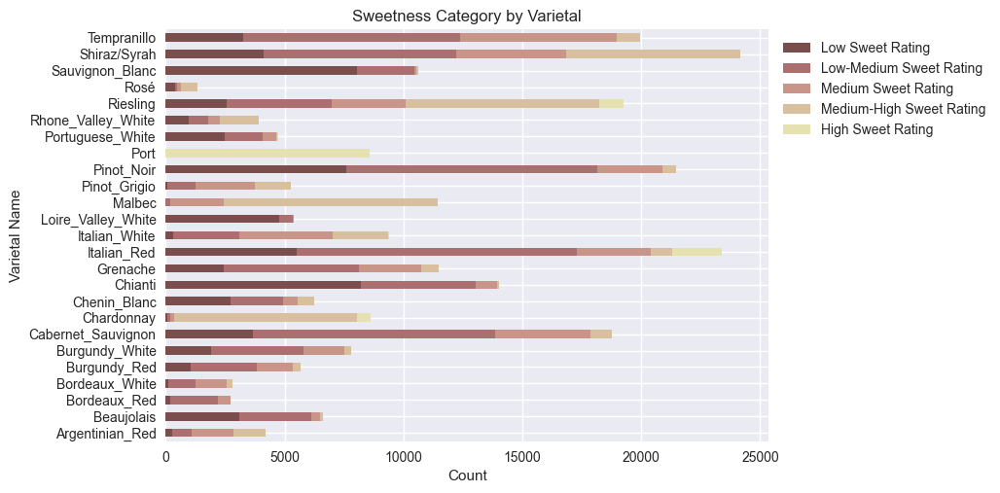

In [194]:
plt.style.use('seaborn') #bmh
sns.set_palette("pink")

df_sweet = dfp_sweet.unstack().reset_index()
df_sweet.rename(columns={0:"Count"}, inplace=True)

plotdata = pd.DataFrame({
    "Low Sweet Rating":df_sweet[df_sweet.Sweetness_Cat=="low_sweet_rating"].Count.tolist(),
    "Low-Medium Sweet Rating":df_sweet[df_sweet.Sweetness_Cat=="low_medium_sweet_rating"].Count.tolist()
    ,"Medium Sweet Rating":df_sweet[df_sweet.Sweetness_Cat=="medium_sweet_rating"].Count.tolist()
    ,"Medium-High Sweet Rating":df_sweet[df_sweet.Sweetness_Cat=="medium_high_sweet_rating"].Count.tolist()
    ,"High Sweet Rating":df_sweet[df_sweet.Sweetness_Cat=="high_sweet_rating"].Count.tolist()
    }, 
    index=df_sweet[df_sweet.Sweetness_Cat=="low_sweet_rating"].Label.tolist()
)

plotdata.plot(kind="barh", stacked=True)
plt.title("Sweetness Category by Varietal")
plt.xlabel("Count")
plt.ylabel("Varietal Name")
plt.legend(bbox_to_anchor=(1.38, 1))
plt.show()

In [195]:
df_sweet.pivot_table(index='Sweetness_Cat', aggfunc='sum')

,Count
Sweetness_Cat,
high_sweet_rating,12312.0
low_medium_sweet_rating,90350.0
low_sweet_rating,63893.0
medium_high_sweet_rating,45645.0
medium_sweet_rating,45589.0


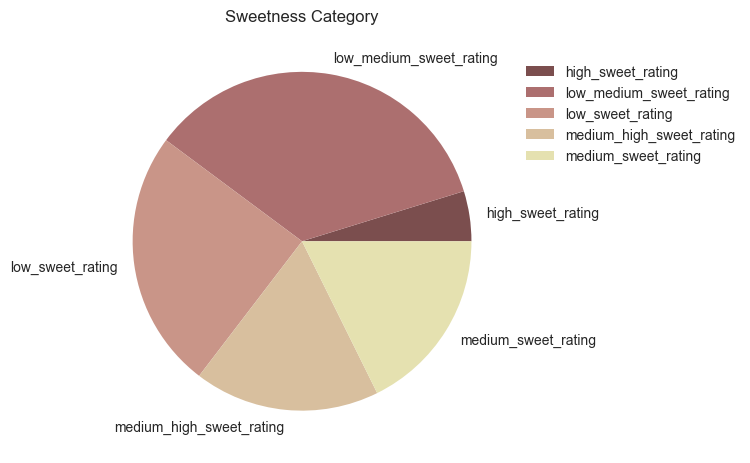

In [196]:
df_sweet.pivot_table(index='Sweetness_Cat', 
                    aggfunc='sum').plot(kind='pie', 
                                        y='Count',
                                        title='Sweetness Category',
                                        ylabel='')

plt.legend(loc='center left', bbox_to_anchor=(1., .8), ncol=1)
plt.show()

In [197]:
subset = pd.concat([dataset[dataset.Country=='Italy'], dataset[dataset.Country=='Australia']])

In [198]:
len(subset.Single_Most_Used_Grape.unique())

18

In [199]:
subset.groupby("Single_Most_Used_Grape").count()

,Full_Vintage_Name,Winery_Name,Vintage_Year,Short_Wine_Name,Type_ID,Region,Country,Price,Currency,Wine_ID,Average_Rating,Rating_Count,Varietal_Name,Body_Description,Acidity_Description,Food_Pairings,Most_Used_Grapes,Acidity,Intensity,Sweetness,Tannin,Primary_Keywords,User_Rating,Note,Created_At,Label,Label_Category,Review_Term_Count,Type_Cat,Other_Grapes,Acidity_Cat,Intensity_Cat,Tannin_Cat,Sweetness_Cat
Single_Most_Used_Grape,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Arneis,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,0,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607
Cabernet Sauvignon,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961,2961
Corvina,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107
Gewürztraminer,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,0,82,82,82,82,82,82,82,82,82,82,82,82,82
Grenache,981,981,981,981,981,981,981,981,981,981,981,981,981,981,981,981,981,981,981,981,883,981,981,981,981,981,981,981,981,981,981,981,981,981
Malvasia,480,480,480,480,480,480,480,480,480,480,480,480,480,480,480,480,480,480,480,480,0,480,480,480,480,480,480,480,480,480,480,480,480,480
Montepulciano,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183,183
Müller-Thurgau,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,0,40,40,40,40,40,40,40,40,40,40,40,40,40
Nebbiolo,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692,14692


In [200]:
subset = subset.groupby("Single_Most_Used_Grape").filter(lambda abc: len(abc) > 500)

In [201]:
subset.Body_Description.unique()

array(['Full_bodied', 'Medium_bodied', 'Very_full_bodied', 'Light_bodied'],
      dtype=object)

In [202]:
len(subset.Single_Most_Used_Grape.unique())

11

In [203]:
subset.groupby("Body_Description").count()

,Full_Vintage_Name,Winery_Name,Vintage_Year,Short_Wine_Name,Type_ID,Region,Country,Price,Currency,Wine_ID,Average_Rating,Rating_Count,Varietal_Name,Acidity_Description,Food_Pairings,Most_Used_Grapes,Acidity,Intensity,Sweetness,Tannin,Primary_Keywords,User_Rating,Note,Created_At,Label,Single_Most_Used_Grape,Label_Category,Review_Term_Count,Type_Cat,Other_Grapes,Acidity_Cat,Intensity_Cat,Tannin_Cat,Sweetness_Cat
Body_Description,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Full_bodied,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724,4724
Light_bodied,178,178,178,178,178,178,178,178,178,178,178,178,178,178,178,178,178,178,178,80,178,178,178,178,178,178,178,178,178,178,178,178,178,178
Medium_bodied,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,17346,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252,26252
Very_full_bodied,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765,25765


In [204]:
old_world_subset = pd.concat([dataset[dataset.Country=='Italy'],
                    dataset[dataset.Country=='France'],
                    dataset[dataset.Country=='Portugal'],
                    dataset[dataset.Country=='Spain'],
                    dataset[dataset.Country=='Germany'],
                    dataset[dataset.Country=='Austria']
                   ])

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 13.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 14.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 13.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


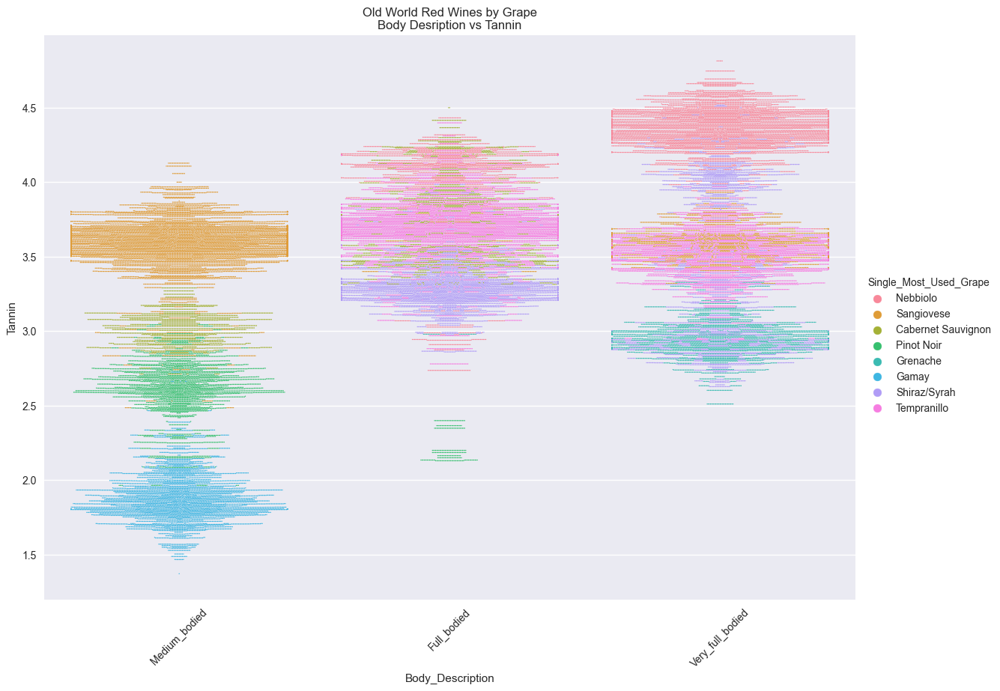

In [205]:
subset = old_world_subset[(old_world_subset.Body_Description!='Very_light_bodied')
                              & (old_world_subset.Body_Description!='Light_bodied')
                              & (old_world_subset.Type_ID==1)
                              & (old_world_subset.Single_Most_Used_Grape!='Corvina')
                               & (old_world_subset.Single_Most_Used_Grape!='Montepulciano')
                               & (old_world_subset.Single_Most_Used_Grape!='Gouveio')
                               & (old_world_subset.Single_Most_Used_Grape!='Baga')
                               & (old_world_subset.Single_Most_Used_Grape!='Aragonez')
                               & (old_world_subset.Single_Most_Used_Grape!='Cabernet Franc')
                               & (old_world_subset.Single_Most_Used_Grape!='Touriga Nacional')
                               & (old_world_subset.Single_Most_Used_Grape!='Primitivo')
                              ]

plt.style.use('seaborn-deep')

plot = sns.catplot(data=subset,
            x="Body_Description", 
            y="Tannin", 
            hue="Single_Most_Used_Grape",
            s=1,
            height=8.27, 
            aspect=11.7/8.27,
            order=['Medium_bodied', 'Full_bodied', 'Very_full_bodied'],
            kind="swarm").set(title='Old World Red Wines by Grape\nBody Desription vs Tannin')

MEDIUM_SIZE = 24
BIGGER_SIZE = 36

plt.rc('font', size=MEDIUM_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=MEDIUM_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
plt.xticks(rotation=45)
plt.show()

In [206]:
old_world_subset[(old_world_subset.Body_Description!='Very_light_bodied')
                              & (old_world_subset.Body_Description!='Light_bodied')
                              & (old_world_subset.Type_ID==1)
                              & (old_world_subset.Single_Most_Used_Grape!='Corvina')
                               & (old_world_subset.Single_Most_Used_Grape!='Montepulciano')
                               & (old_world_subset.Single_Most_Used_Grape!='Gouveio')
                               & (old_world_subset.Single_Most_Used_Grape!='Baga')
                               & (old_world_subset.Single_Most_Used_Grape!='Aragonez')
                               & (old_world_subset.Single_Most_Used_Grape!='Cabernet Franc')
                               & (old_world_subset.Single_Most_Used_Grape!='Touriga Nacional')
                               & (old_world_subset.Single_Most_Used_Grape!='Primitivo')
                              ].shape

(87295, 35)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 16.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 20.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 19.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


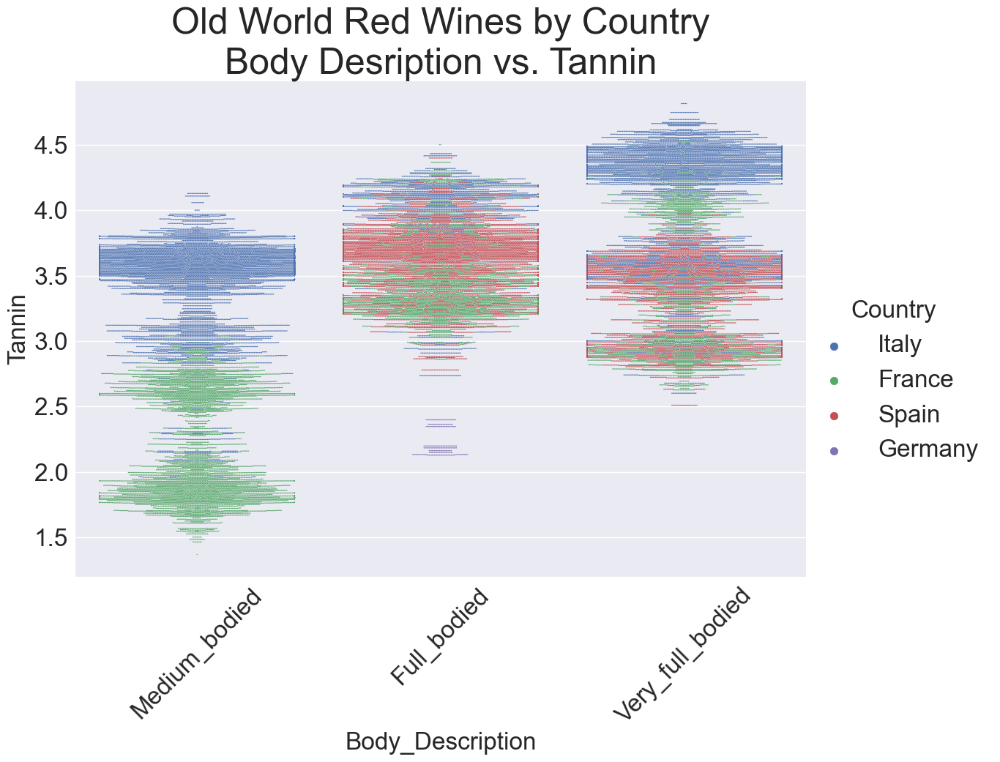

In [207]:
old_world_subset = pd.concat([dataset[dataset.Country=='Italy'],
                    dataset[dataset.Country=='France'],
                    dataset[dataset.Country=='Portugal'],
                    dataset[dataset.Country=='Spain'],
                    dataset[dataset.Country=='Germany'],
                    dataset[dataset.Country=='Austria']
                   ])

subset = old_world_subset[(old_world_subset.Body_Description!='Very_light_bodied')
                              & (old_world_subset.Body_Description!='Light_bodied')
                              & (old_world_subset.Type_ID==1)
                              & (old_world_subset.Single_Most_Used_Grape!='Corvina')
                               & (old_world_subset.Single_Most_Used_Grape!='Montepulciano')
                               & (old_world_subset.Single_Most_Used_Grape!='Gouveio')
                               & (old_world_subset.Single_Most_Used_Grape!='Baga')
                               & (old_world_subset.Single_Most_Used_Grape!='Aragonez')
                               & (old_world_subset.Single_Most_Used_Grape!='Cabernet Franc')
                               & (old_world_subset.Single_Most_Used_Grape!='Touriga Nacional')
                               & (old_world_subset.Single_Most_Used_Grape!='Primitivo')
                              ]

plt.style.use('seaborn-deep')

plot = sns.catplot(data=subset,
            x="Body_Description", 
            y="Tannin", 
            hue="Country",
            s=1,
            height=8.27, 
            aspect=11.7/8.27,
            order=['Medium_bodied', 'Full_bodied', 'Very_full_bodied'],
            kind="swarm").set(title='Old World Red Wines by Country\nBody Desription vs. Tannin')

MEDIUM_SIZE = 24
BIGGER_SIZE = 36

plt.rc('font', size=MEDIUM_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=MEDIUM_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
plt.xticks(rotation=45)
plt.show()

In [208]:
subset = dataset[dataset.Type_ID==1].groupby("Single_Most_Used_Grape").filter(lambda abc: len(abc) > 1000)
new_world_subset = pd.concat([subset[subset.Country=='United States'],
                    subset[subset.Country=='Argentina'],
                    subset[subset.Country=='New Zealand'],
                    subset[subset.Country=='South Africa'],
                    subset[subset.Country=='Canada'],
                    subset[subset.Country=='Chile']])

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 38.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 12.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 13.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


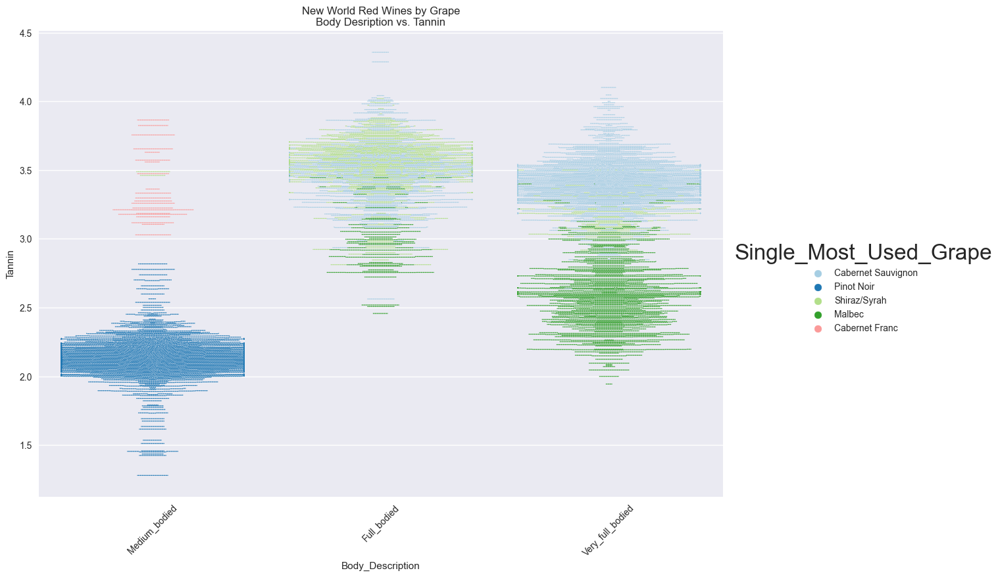

In [209]:
plt.style.use('seaborn')
sns.set_palette("Paired")

plot = sns.catplot(data=new_world_subset[new_world_subset['Single_Most_Used_Grape']!='Tempranillo']
            ,x="Body_Description", 
            y="Tannin", 
            hue="Single_Most_Used_Grape",
            s=1,
            height=8.27, 
            aspect=11.7/8.27,
            order=['Medium_bodied', 'Full_bodied', 'Very_full_bodied'],
            kind="swarm").set(title='New World Red Wines by Grape\nBody Desription vs. Tannin')

plt.style.use('seaborn')
sns.set_palette("Set3")

MEDIUM_SIZE = 18
BIGGER_SIZE = 24

MEDIUM_SIZE = 24
BIGGER_SIZE = 36

plt.rc('font', size=MEDIUM_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=MEDIUM_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

plt.xticks(rotation=45)
plt.show()

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 40.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 14.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/seaborn/categorical.py:1296: UserWarning: 15.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


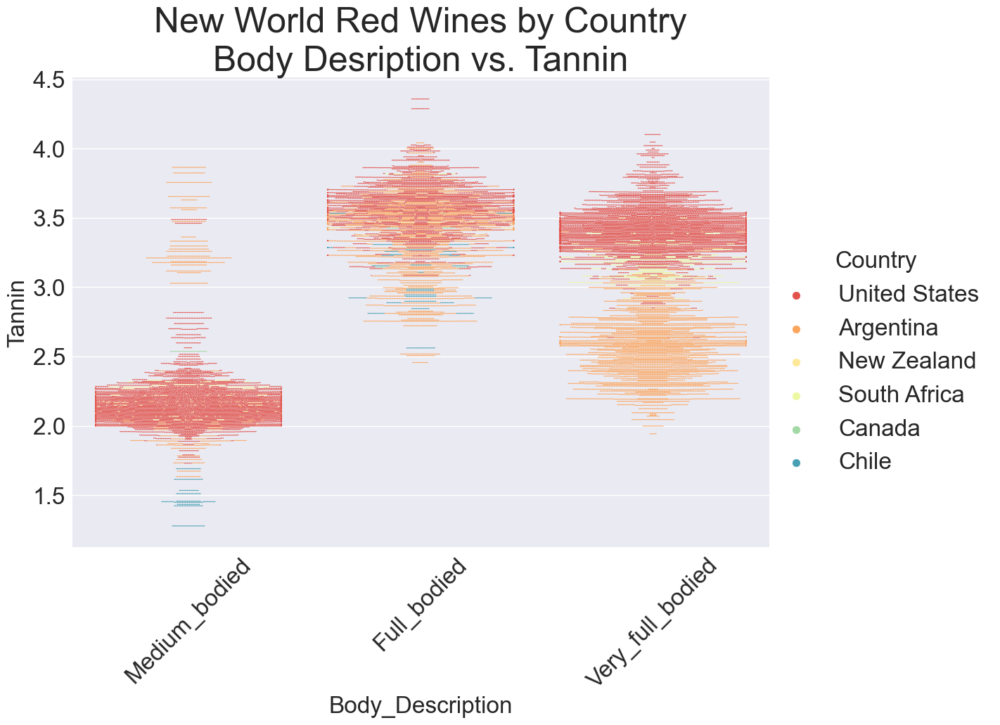

In [210]:
plt.style.use('seaborn-deep')
sns.set_palette("Spectral")

plot = sns.catplot(data=new_world_subset,
            x="Body_Description", 
            y="Tannin", 
            hue="Country",
            s=1,
            height=8.27, 
            aspect=11.7/8.27,
            order=['Medium_bodied', 'Full_bodied', 'Very_full_bodied'],   
            kind="swarm").set(title='New World Red Wines by Country\nBody Desription vs. Tannin')

MEDIUM_SIZE = 24
BIGGER_SIZE = 36

plt.rc('font', size=MEDIUM_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=MEDIUM_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
plt.xticks(rotation=45)
plt.show()

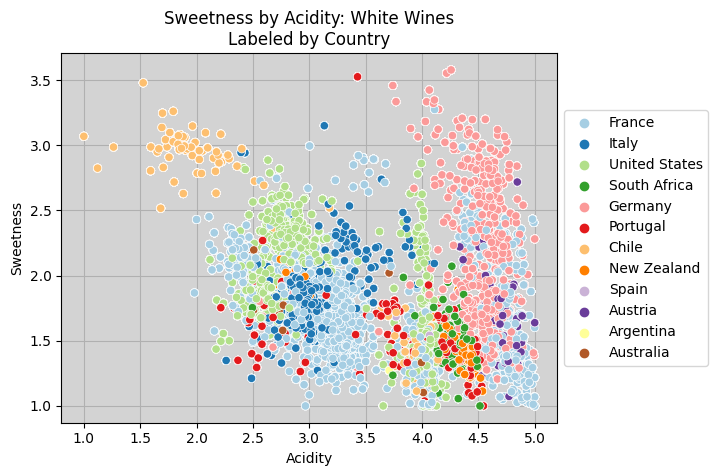

In [211]:
# https://www.codecademy.com/article/seaborn-design-ii
# 12 differentiables seem to be oob avail.

plt.style.use('default')
ax = plt.axes()
ax.set_axisbelow(True)
ax.grid()
ax.set_facecolor('lightgray')

sns.set_palette("Paired")

sns_scatter = sns.scatterplot(data=dataset[dataset.Type_ID==2]
                                , x="Acidity"
                                , y="Sweetness"
                                , hue="Country"
               ).set(title='Sweetness by Acidity: White Wines\nLabeled by Country')


plt.legend(loc='center left', bbox_to_anchor=(1., 0.5), ncol=1)
plt.show()

In [212]:
dataset[dataset.Type_ID==2].groupby("Single_Most_Used_Grape").count()

,Full_Vintage_Name,Winery_Name,Vintage_Year,Short_Wine_Name,Type_ID,Region,Country,Price,Currency,Wine_ID,Average_Rating,Rating_Count,Varietal_Name,Body_Description,Acidity_Description,Food_Pairings,Most_Used_Grapes,Acidity,Intensity,Sweetness,Tannin,Primary_Keywords,User_Rating,Note,Created_At,Label,Label_Category,Review_Term_Count,Type_Cat,Other_Grapes,Acidity_Cat,Intensity_Cat,Tannin_Cat,Sweetness_Cat
Single_Most_Used_Grape,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Arinto de Bucelas,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,0,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700,3700
Arneis,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,0,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607,1607
Chardonnay,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,0,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425,16425
Chenin Blanc,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,0,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413,10413
Gewürztraminer,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,82,0,82,82,82,82,82,82,82,82,82,82,82,82,82
Grenache Blanc,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,0,34,34,34,34,34,34,34,34,34,34,34,34,34
Malvasia,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,0,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506,1506
Melon de Bourgogne,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,0,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177,1177
Müller-Thurgau,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,0,40,40,40,40,40,40,40,40,40,40,40,40,40


In [213]:
subset = dataset[dataset.Type_ID==2].groupby("Single_Most_Used_Grape").filter(lambda abc: len(abc) > 500)

In [214]:
subset[subset.Type_ID==2].groupby("Single_Most_Used_Grape").count().shape[0]

12

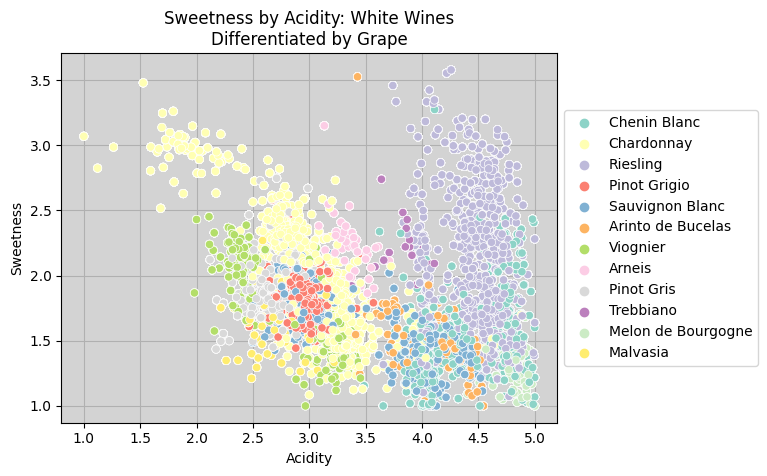

In [215]:
plt.style.use('default')
ax = plt.axes()
ax.set_axisbelow(True)
ax.grid()
ax.set_facecolor('lightgray')

sns.set_palette("Set3")

sns_scatter = sns.scatterplot(data=subset,
            x="Acidity", 
            y="Sweetness"
            , hue="Single_Most_Used_Grape"
               ).set(title='Sweetness by Acidity: White Wines\nDifferentiated by Grape')

plt.legend(loc='center left', bbox_to_anchor=(1., 0.5), ncol=1)
plt.show()

In [216]:
dataset[dataset.Type_ID==1].groupby("Single_Most_Used_Grape").count()

,Full_Vintage_Name,Winery_Name,Vintage_Year,Short_Wine_Name,Type_ID,Region,Country,Price,Currency,Wine_ID,Average_Rating,Rating_Count,Varietal_Name,Body_Description,Acidity_Description,Food_Pairings,Most_Used_Grapes,Acidity,Intensity,Sweetness,Tannin,Primary_Keywords,User_Rating,Note,Created_At,Label,Label_Category,Review_Term_Count,Type_Cat,Other_Grapes,Acidity_Cat,Intensity_Cat,Tannin_Cat,Sweetness_Cat
Single_Most_Used_Grape,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Aragonez,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48
Baga,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160
Bonarda,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463,463
Cabernet Franc,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053,1053
Cabernet Sauvignon,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983,26983
Corvina,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107,2107
Gamay,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632,6632
Gouveio,645,645,645,645,645,645,645,645,645,645,645,645,645,645,645,645,645,645,645,645,0,645,645,645,645,645,645,645,645,645,645,645,645,645
Grenache,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628,4628


In [217]:
subset = dataset[dataset.Type_ID==1].groupby("Single_Most_Used_Grape").filter(lambda abc: len(abc) > 1000)

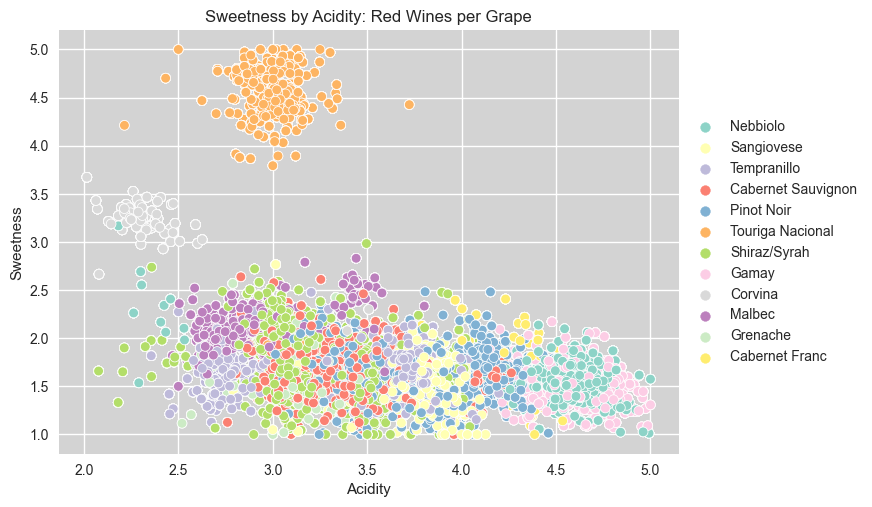

In [218]:
plt.style.use('seaborn')
ax = plt.axes()
ax.set_facecolor('lightgray')

sns.set_palette("Set3")

sns_scatter = sns.scatterplot(data=subset,
            x="Acidity", 
            y="Sweetness"
            , hue="Single_Most_Used_Grape"
               ).set(title='Sweetness by Acidity: Red Wines per Grape')

plt.legend(loc='center left', bbox_to_anchor=(1., 0.5), ncol=1)
plt.show()

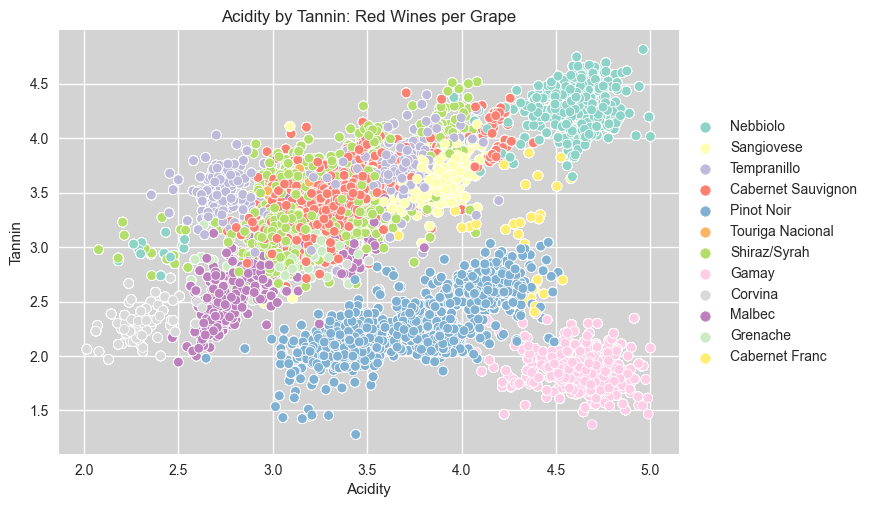

In [219]:
plt.style.use('seaborn')
ax = plt.axes()
ax.set_facecolor('lightgray')
sns.set_palette("Set3")

sns_scatter = sns.scatterplot(data=subset,
            x="Acidity", 
            y="Tannin"
            , hue="Single_Most_Used_Grape"
               ).set(title='Acidity by Tannin: Red Wines per Grape')

plt.legend(loc='center left', bbox_to_anchor=(1., 0.5), ncol=1)
plt.show()

In [220]:
dataset[dataset.Single_Most_Used_Grape=='Gamay'].head() # Beaujolais, France

,Full_Vintage_Name,Winery_Name,Vintage_Year,Short_Wine_Name,Type_ID,Region,Country,Price,Currency,Wine_ID,Average_Rating,Rating_Count,Varietal_Name,Body_Description,Acidity_Description,Food_Pairings,Most_Used_Grapes,Acidity,Intensity,Sweetness,Tannin,Primary_Keywords,User_Rating,Note,Created_At,Label,Single_Most_Used_Grape,Label_Category,Review_Term_Count,Type_Cat,Other_Grapes,Acidity_Cat,Intensity_Cat,Tannin_Cat,Sweetness_Cat
28,Domaine Marcel Lapierre Cuvée Marcel 2014,Domaine_Marcel_Lapierre,2014,Cuvée Marcel,1.0,Morgon,France,68.000000,USD,1750282.0,4.2,296.0,Red,Medium_bodied,High,"Pasta,Veal,Pork,Poultry",Gamay,4.548261,1.540391,1.696179,1.800420,"red_fruit,earth,black_fruit,oak,spices,non_oak...",4.5,🥇 4.5\n\nAnother beautiful magnum. This is jus...,2021-12-30T13:42:30.000Z,Beaujolais,Gamay,Beaujolais,25,Red,,high_acidity,low_intensity,low_tannin,low_medium_sweet_rating
63,Julien Sunier Wild Soul 2020,Julien_Sunier,2020,Wild Soul,1.0,Beaujolais,France,29.990000,USD,5776888.0,3.9,104.0,Red,Medium_bodied,High,"Pasta,Veal,Pork,Poultry",Gamay,4.465612,1.584590,1.492502,1.804670,"red_fruit,earth,spices,oak,black_fruit,microbi...",3.5,🤔 🌫 a little hazy now… I enjoyed-but not quite...,2021-11-13T14:57:23.000Z,Beaujolais,Gamay,Beaujolais,40,Red,,high_acidity,low_intensity,low_tannin,low_sweet_rating
76,Joseph Burrier (Château de Beauregard) Fleurie...,Joseph_Burrier_(Château_de_Beauregard),2016,Fleurie Poncié,1.0,Fleurie,France,20.415833,USD,2165171.0,3.9,74.0,Red,Medium_bodied,High,"Pasta,Veal,Pork,Poultry",Gamay,4.715858,1.443633,1.638964,1.894975,"red_fruit,oak,earth,spices,non_oak,black_fruit...",4.0,😷🔒⤵️ 100% Gamay🍇. Semi translucent bright ruby...,2020-05-09T19:29:01.000Z,Beaujolais,Gamay,Beaujolais,69,Red,,high_acidity,low_intensity,low_tannin,low_medium_sweet_rating
81,Domaine Lafarge Vial Fleurie Joie du Palais 2019,Domaine_Lafarge_Vial,2019,Fleurie Joie du Palais,1.0,Fleurie,France,49.950000,USD,5310829.0,4.0,31.0,Red,Medium_bodied,High,"Pasta,Veal,Pork,Poultry",Gamay,4.534281,1.551565,1.475431,2.056677,"red_fruit,earth,spices,microbio,oak,floral,bla...",4.5,"😳 deep purpley red\n🤥 red fruit\n😛 cherry, str...",2022-06-18T10:48:55.000Z,Beaujolais,Gamay,Beaujolais,11,Red,,high_acidity,low_intensity,low_tannin,low_sweet_rating
143,Domaine Mee Godard Morgon Grand Cras 2015,Domaine_Mee_Godard,2015,Morgon Grand Cras,1.0,Morgon,France,35.000000,USD,3877153.0,3.9,120.0,Red,Medium_bodied,High,"Pasta,Veal,Pork,Poultry",Gamay,4.583049,1.983748,1.491343,2.287608,"red_fruit,earth,oak,black_fruit,non_oak,microb...",4.1,🗓: 2018\n🍇: Gamay\n👁: Medium+ ruby\n👃: Medium ...,2022-10-14T15:05:21.000Z,Beaujolais,Gamay,Beaujolais,65,Red,,high_acidity,low_intensity,low_tannin,low_sweet_rating


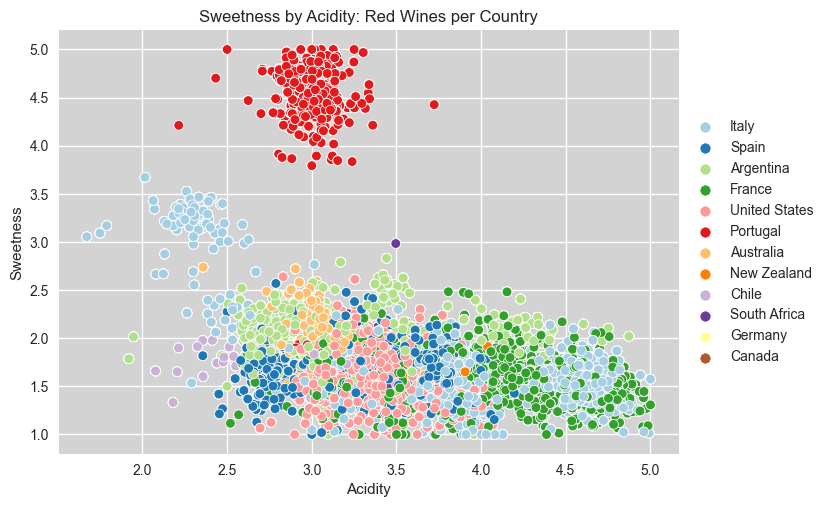

In [221]:
plt.style.use('seaborn')
ax = plt.axes()
ax.set_facecolor('lightgray')
sns.set_palette("Paired")

sns_scatter = sns.scatterplot(data=dataset[(dataset.Type_ID==1)
                                          &(dataset.Country!='Israel')],
            x="Acidity", 
            y="Sweetness"
            , hue="Country"
               ).set(title='Sweetness by Acidity: Red Wines per Country')

plt.legend(loc='center left', bbox_to_anchor=(1., 0.5), ncol=1)
plt.show()

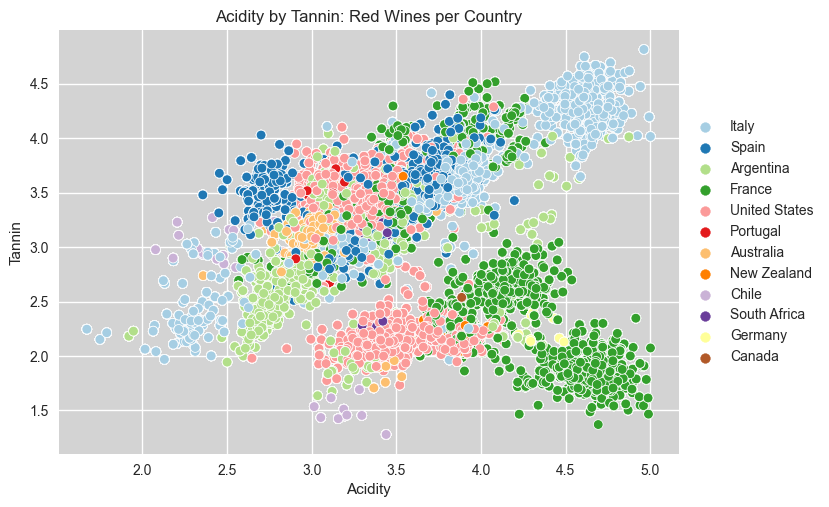

In [222]:
plt.style.use('seaborn')
ax = plt.axes()
ax.set_facecolor('lightgray')
sns.set_palette("Paired")

sns_scatter = sns.scatterplot(data=dataset[(dataset.Type_ID==1)
                                          &(dataset.Country!='Israel')],
            x="Acidity", 
            y="Tannin"
            , hue="Country"
               ).set(title='Acidity by Tannin: Red Wines per Country')

plt.legend(loc='center left', bbox_to_anchor=(1., 0.5), ncol=1)
plt.show()

In [223]:
subset.shape

(170201, 35)

In [224]:
dataset.groupby("Type_Cat").count()['Full_Vintage_Name']

Type_Cat
Red      172514
Rosé       1356
White     83919
Name: Full_Vintage_Name, dtype: int64

In [225]:
plt.style.use('seaborn-deep')
sns.set_palette("pink")

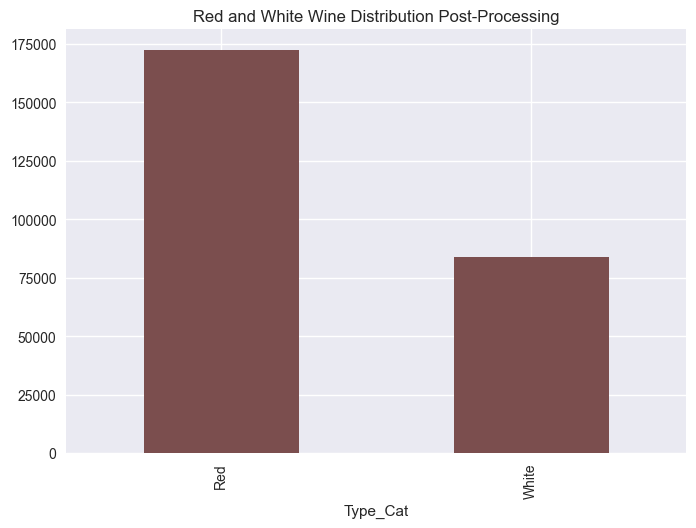

In [226]:
dataset[dataset.Type_ID!=4].groupby("Type_Cat").count()['Full_Vintage_Name'].plot(kind='bar'
                                                                                 ).set_title('Red and White Wine Distribution Post-Processing')
plt.show()

In [227]:
dataset[dataset['Most_Used_Grapes']!=dataset['Single_Most_Used_Grape']][['Most_Used_Grapes', 'Single_Most_Used_Grape', 'Other_Grapes']].head(1)

,Most_Used_Grapes,Single_Most_Used_Grape,Other_Grapes
2,"Sangiovese,Trebbiano,Canaiolo Nero,Malvasia Nera",Sangiovese,"Trebbiano,Canaiolo Nero,Malvasia Nera"


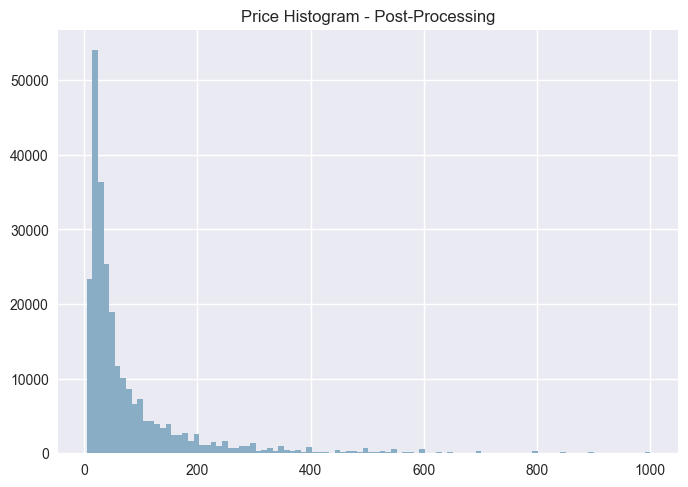

In [228]:
plt.style.use('seaborn')
cm = plt.cm.get_cmap('twilight')
sns.set_palette("twilight")
plt.hist(dataset.Price, bins=100)
plt.title("Price Histogram - Post-Processing")
plt.show()

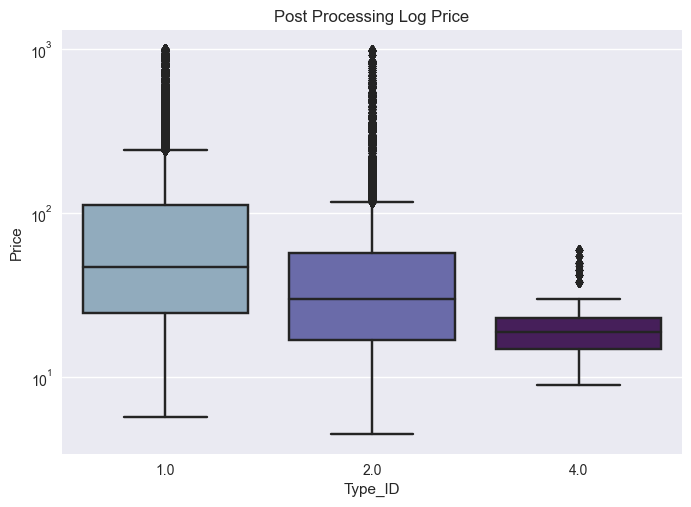

In [229]:
sns.set_palette("twilight")
sns.boxplot(data=dataset, 
            x="Type_ID",
            y="Price"
           ).set_title("Post Processing Log Price")
plt.yscale('log')
plt.show()

In [230]:
def Price_Cat(Price):
    if Price <= 10:
        price_cat = "cheap"
    elif Price > 10 and Price < 30:
        price_cat = "low_price"
    elif Price > 30 and Price <= 100:
        price_cat = "medium_price"
    elif Price > 100:
        price_cat = "price_high"
    else:
        price_cat = "price_unknown"
    return price_cat

In [231]:
dataset["Price_Cat"] = dataset.Price.apply(Price_Cat)
dfp_price = dataset.pivot_table(index='Label', columns='Price_Cat', aggfunc='count')
dfp_price = dfp_price['Note']

In [232]:
sns.set_palette("seismic")

In [233]:
dataset.pivot_table(index='Price_Cat', 
                    columns='Label', 
                    aggfunc='count')['Price']['Argentinian_Red']

Price_Cat
cheap               NaN
low_price        1855.0
medium_price     1753.0
price_high        554.0
price_unknown      45.0
Name: Argentinian_Red, dtype: float64

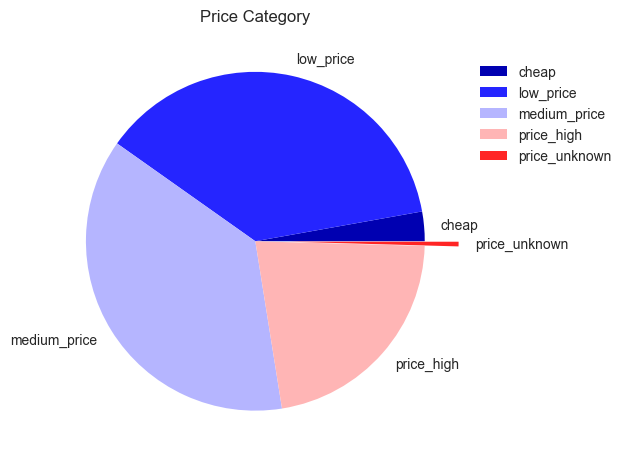

In [234]:
plt.style.use('seaborn')
sns.set_palette("seismic")

dataset["Price_Cat"] = dataset.Price.apply(Price_Cat)
dfp_price = dataset.pivot_table(index='Label', columns='Price_Cat', aggfunc='count')
dfp_price = dfp_price['Note']

df_price = dfp_price.unstack().reset_index()
df_price.rename(columns={0:"Count"}, inplace=True)

df_price.fillna(0, inplace=True)

df_price.pivot_table(index='Price_Cat', 
                    aggfunc='sum').plot(kind='pie', 
                                        y='Count',
                                        title='Price Category',
                                        explode=[0, 0, 0, 0, 0.2],
                                        ylabel='')

plt.legend(loc='center left', bbox_to_anchor=(1., .8), ncol=1)
plt.show()

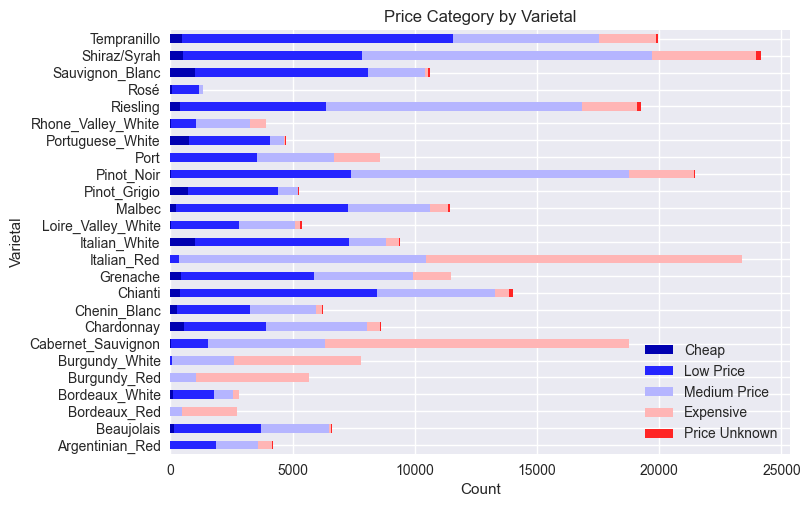

In [235]:
df_price = dfp_price.unstack().reset_index()
df_price.rename(columns={0:"Count"}, inplace=True)

plotdata = pd.DataFrame({
    "Cheap":df_price[df_price.Price_Cat=="cheap"].Count.tolist(),
    "Low Price":df_price[df_price.Price_Cat=="low_price"].Count.tolist()
    ,"Medium Price":df_price[df_price.Price_Cat=="medium_price"].Count.tolist()
    ,"Expensive":df_price[df_price.Price_Cat=="price_high"].Count.tolist()
    ,"Price Unknown":df_price[df_price.Price_Cat=="price_unknown"].Count.tolist()
    }, 
    index=df_price[df_price.Price_Cat=="cheap"].Label.tolist()
)

#mpl.style.use('seaborn-pastel') 

plotdata.plot(kind="barh", stacked=True)
plt.title("Price Category by Varietal")
plt.xlabel("Count")
plt.ylabel("Varietal")
plt.legend(loc='lower right')
plt.show()

<AxesSubplot:title={'center':'Heat Map: Price Category by Region'}, xlabel='Price_Cat', ylabel='Region'>

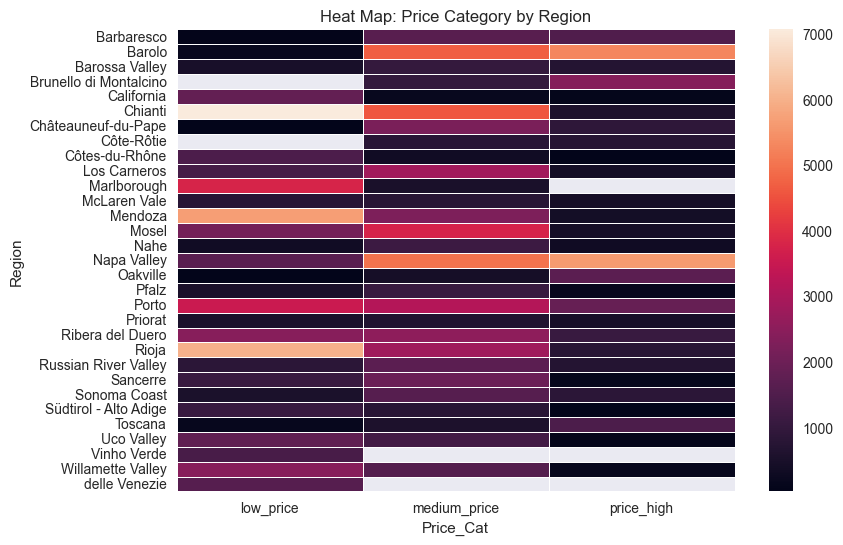

In [236]:
filtered = dataset.groupby("Region").filter(lambda abc: len(abc) > 1500)
filtered = filtered[(filtered.Price_Cat!="price_unknown") & (filtered.Price_Cat!='cheap')]
data_pivot = filtered.pivot_table(index="Region", columns="Price_Cat", aggfunc="count")
data_pivot = data_pivot['Acidity']
f, ax = plt.subplots(figsize=(9, 6))
ax.set_title('Heat Map: Price Category by Region')
sns.heatmap(data_pivot, 
            annot=False, 
            linewidths=.5, 
            mask=data_pivot.isnull(),
            ax=ax)

<AxesSubplot:title={'center':'Heat Map: Price Category by Country'}, xlabel='Price_Cat', ylabel='Country'>

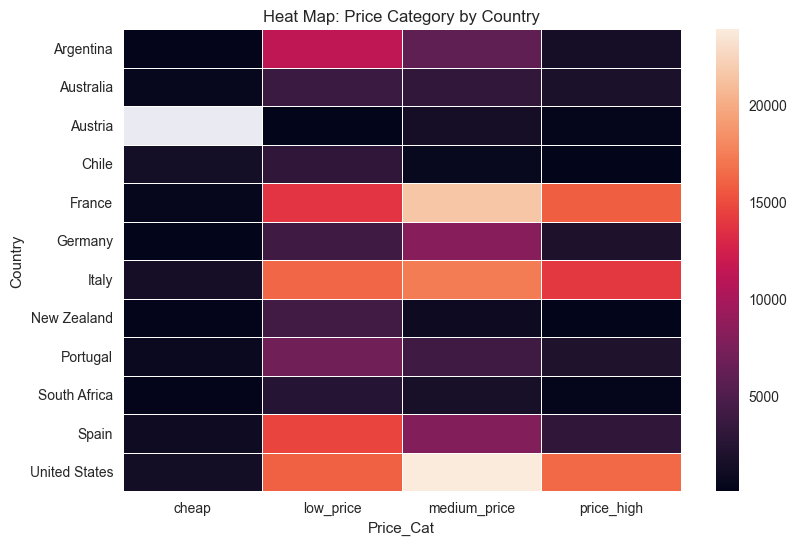

In [237]:
filtered = dataset.groupby("Country").filter(lambda abc: len(abc) > 1500)
filtered = filtered[filtered.Price_Cat!="price_unknown"]
data_pivot = filtered.pivot_table(index="Country", columns="Price_Cat", aggfunc="count")
data_pivot = data_pivot['Acidity']
f, ax = plt.subplots(figsize=(9, 6))
ax.set_title('Heat Map: Price Category by Country')
sns.heatmap(data_pivot, annot=False, linewidths=.5, ax=ax)

In [238]:
prices = dataset[['Winery_Name', 'Region', 'Label', 'Single_Most_Used_Grape', 'Price']]
prices_per_region = prices.groupby("Region").describe()
prices_per_vineyard = prices.groupby("Winery_Name").describe()
prices_per_grape = prices.groupby(["Single_Most_Used_Grape"]).describe()

In [239]:
prices_per_region.head()

Price                                                  \
                  count       mean         std    min    25%        50%   
Region                                                                    
Aconcagua Valley  138.0  21.359493    1.666388  19.90  19.90  20.990000   
Adelaide Hills    292.0  28.543082    9.247803  16.99  20.00  29.990000   
Agrelo            930.0  58.732286  102.959320  13.99  19.25  32.950000   
Alentejano        320.0  22.551188   19.263389   6.99  11.99  13.583333   
Alentejo          398.0  54.798381  112.703710  13.99  15.99  21.000000   

                                     
                        75%     max  
Region                               
Aconcagua Valley  23.750000   23.75  
Adelaide Hills    33.990000   50.00  
Agrelo            42.990000  550.00  
Alentejano        24.990000   76.99  
Alentejo          27.749167  499.99

In [240]:
fair_price_by_region = pd.DataFrame(prices_per_region['Price']['mean']+0*prices_per_region['Price']['std'])
fair_price_by_region.reset_index(inplace=True)
fair_price_by_region.rename(columns={0:"Reasonable_Price_Regional"}, inplace=True)

fair_price_by_grape = pd.DataFrame(prices_per_grape['Price']['mean']+0*prices_per_grape['Price']['std'])
fair_price_by_grape.reset_index(inplace=True)
fair_price_by_grape.rename(columns={0:"Reasonable_Price_by_Grape"}, inplace=True)

fair_price_by_vineyard = pd.DataFrame(prices_per_vineyard['Price']['mean']+0*prices_per_vineyard['Price']['std'])
fair_price_by_vineyard.reset_index(inplace=True)
fair_price_by_vineyard.rename(columns={0:"Reasonable_Price_Winery"}, inplace=True)

In [241]:
fair_price_by_region.head()

,Region,Reasonable_Price_Regional
0,Aconcagua Valley,21.359493
1,Adelaide Hills,28.543082
2,Agrelo,58.732286
3,Alentejano,22.551188
4,Alentejo,54.798381


In [242]:
fair_price_by_vineyard.head()

,Winery_Name,Reasonable_Price_Winery
0,1000_Stories,19.990000
1,13_Celsius,12.422836
2,14_Hands,12.628889
3,14°_Secolo,9.990000
4,1907,10.990000


In [243]:
fair_price_by_grape.head()

,Single_Most_Used_Grape,Reasonable_Price_by_Grape
0,Aragonez,254.161875
1,Arinto de Bucelas,20.790725
2,Arneis,80.062978
3,Baga,34.133750
4,Bonarda,25.371812


In [244]:
dataset.shape

(257789, 36)

In [245]:
dataset = dataset.merge(fair_price_by_vineyard, how='left', on='Winery_Name')

In [246]:
dataset.shape

(257789, 37)

In [247]:
dataset = dataset.merge(fair_price_by_region, how='left', on='Region')

In [248]:
dataset.shape

(257789, 38)

In [249]:
dataset = dataset.merge(fair_price_by_grape, how='left', on='Single_Most_Used_Grape')

In [250]:
dataset.shape

(257789, 39)

In [251]:
dataset.columns

Index(['Full_Vintage_Name', 'Winery_Name', 'Vintage_Year', 'Short_Wine_Name',
       'Type_ID', 'Region', 'Country', 'Price', 'Currency', 'Wine_ID',
       'Average_Rating', 'Rating_Count', 'Varietal_Name', 'Body_Description',
       'Acidity_Description', 'Food_Pairings', 'Most_Used_Grapes', 'Acidity',
       'Intensity', 'Sweetness', 'Tannin', 'Primary_Keywords', 'User_Rating',
       'Note', 'Created_At', 'Label', 'Single_Most_Used_Grape',
       'Label_Category', 'Review_Term_Count', 'Type_Cat', 'Other_Grapes',
       'Acidity_Cat', 'Intensity_Cat', 'Tannin_Cat', 'Sweetness_Cat',
       'Price_Cat', 'Reasonable_Price_Winery', 'Reasonable_Price_Regional',
       'Reasonable_Price_by_Grape'],
      dtype='object')

In [252]:
#dataset.drop(columns=[
#    'Reasonable_Price_Winery_x',
#    'Reasonable_Price_Winery_y',
#    'Reasonable_Price_by_Grape',
#    'Reasonable_Price_Regional', 
#    'Avg_Fair_Price'
#                     ], inplace=True)

In [253]:
dataset.head()[["Winery_Name", "Label", "Region", "Price", 'Reasonable_Price_Regional', "Reasonable_Price_by_Grape", "Reasonable_Price_Winery"]]

,Winery_Name,Label,Region,Price,Reasonable_Price_Regional,Reasonable_Price_by_Grape,Reasonable_Price_Winery
0,Champalou,Chenin_Blanc,Vouvray,23.95,29.625577,41.654999,34.540408
1,Roagna,Italian_Red,Barbaresco,113.00,146.386692,152.780523,158.890819
2,Podere_Il_Palazzino,Chianti,Chianti,22.99,35.932911,63.258075,23.951039
3,Domaine_Pavelot_-_Luc_&_Lise_Pavelot,Burgundy_White,Corton-Charlemagne Grand Cru,115.00,294.960743,119.546089,115.000000
4,Alonso_del_Yerro,Tempranillo,Ribera del Duero,39.00,83.702021,57.870336,43.871429


In [254]:
dataset['Avg_Fair_Price'] = dataset[['Reasonable_Price_Regional', "Reasonable_Price_by_Grape", "Reasonable_Price_Winery"]].mean(axis=1)

In [255]:
dataset.head()

,Full_Vintage_Name,Winery_Name,Vintage_Year,Short_Wine_Name,Type_ID,Region,Country,Price,Currency,Wine_ID,Average_Rating,Rating_Count,Varietal_Name,Body_Description,Acidity_Description,Food_Pairings,Most_Used_Grapes,Acidity,Intensity,Sweetness,Tannin,Primary_Keywords,User_Rating,Note,Created_At,Label,Single_Most_Used_Grape,Label_Category,Review_Term_Count,Type_Cat,Other_Grapes,Acidity_Cat,Intensity_Cat,Tannin_Cat,Sweetness_Cat,Price_Cat,Reasonable_Price_Winery,Reasonable_Price_Regional,Reasonable_Price_by_Grape,Avg_Fair_Price
0,Champalou Vouvray 2021,Champalou,2021,Vouvray,2.0,Vouvray,France,23.95,USD,1172337.0,4.2,197.0,Chenin_Blanc,Medium_bodied,High,"Rich fish (salmon, tuna etc),Vegetarian,Poultr...",Chenin Blanc,4.870948,2.103069,1.545856,NaN,"tree_fruit,earth,citrus_fruit,microbio,oak,tro...",3.5,"🧐 light yellow\n🤥 citrus\n😛 honey, pear, citr...",2021-07-28T20:26:39.000Z,Chenin_Blanc,Chenin Blanc,Chenin_Blanc,29,White,,high_acidity,low_intensity,tannin_unspecified,low_medium_sweet_rating,low_price,34.540408,29.625577,41.654999,35.273661
1,Roagna Faset Barbaresco 2014,Roagna,2014,Faset Barbaresco,1.0,Barbaresco,Italy,113.00,USD,6700106.0,4.4,59.0,Barbaresco,Full_bodied,High,"Beef,Pasta,Lamb,Game (deer, venison)",Nebbiolo,4.647670,3.731456,1.528447,4.225631,"earth,red_fruit,oak,floral,non_oak,black_fruit...",4.0,🧐 The wine is young. As of now it is very good...,2021-06-20T19:09:46.000Z,Italian_Red,Nebbiolo,Italian_Red,96,Red,,high_acidity,medium_intensity,high_tannin,low_medium_sweet_rating,price_high,158.890819,146.386692,152.780523,152.686011
2,Podere Il Palazzino Grosso Sanese Chianti Clas...,Podere_Il_Palazzino,2018,Grosso Sanese Chianti Classico Riserva,1.0,Chianti,Italy,22.99,USD,1100207.0,0.0,17.0,Chianti,Medium_bodied,High,"Beef,Veal,Poultry","Sangiovese,Trebbiano,Canaiolo Nero,Malvasia Nera",3.719051,3.277385,1.900434,3.418920,"oak,earth,red_fruit,non_oak,black_fruit,spices...",4.5,"🧐 From my limited experience, an excellent rep...",2020-04-01T20:28:23.000Z,Chianti,Sangiovese,Chianti,78,Red,"Trebbiano,Canaiolo Nero,Malvasia Nera",medium_acidity,medium_intensity,moderate_tannin,medium_sweet_rating,low_price,23.951039,35.932911,63.258075,41.047342
3,Domaine Pavelot - Luc & Lise Pavelot Corton-Ch...,Domaine_Pavelot_-_Luc_&_Lise_Pavelot,2018.0,Corton-Charlemagne Grand Cru,2.0,Corton-Charlemagne Grand Cru,France,115.00,USD,1547943.0,4.3,27.0,Côte_de_Beaune_White,Full_bodied,Medium,"Pasta,Rich fish (salmon, tuna etc),Shellfish,M...","Chardonnay,Pinot Gris,Pinot Blanc,Aligoté",3.140000,3.739599,1.683625,NaN,"oak,earth,non_oak,tree_fruit,microbio,spices,c...",4.5,"🧐 Beautiful, sophisticated wine. First oaky an...",2021-01-12T21:00:56.000Z,Burgundy_White,Chardonnay,Burgundy_White,83,White,"Pinot Gris,Pinot Blanc,Aligoté",medium_acidity,medium_intensity,tannin_unspecified,low_medium_sweet_rating,price_high,115.000000,294.960743,119.546089,176.502278
4,Alonso del Yerro Ribera del Duero 2017,Alonso_del_Yerro,2017.0,Ribera del Duero,1.0,Ribera del Duero,Spain,39.00,USD,75016.0,4.1,319.0,Ribera_Del_Duero_Red,Very_full_bodied,High,"Beef,Lamb,Game (deer, venison)",Tempranillo,3.723275,3.891962,1.807711,3.550509,"oak,black_fruit,earth,non_oak,spices,red_fruit...",4.0,🦞Y 🔠 Thursday Pregame show. Brought to you by...,2019-09-12T01:37:34.000Z,Tempranillo,Tempranillo,Tempranillo,98,Red,,medium_acidity,medium_intensity,moderate_tannin,medium_sweet_rating,medium_price,43.871429,83.702021,57.870336,61.814595


In [256]:
subset = dataset[dataset.Price < 250]

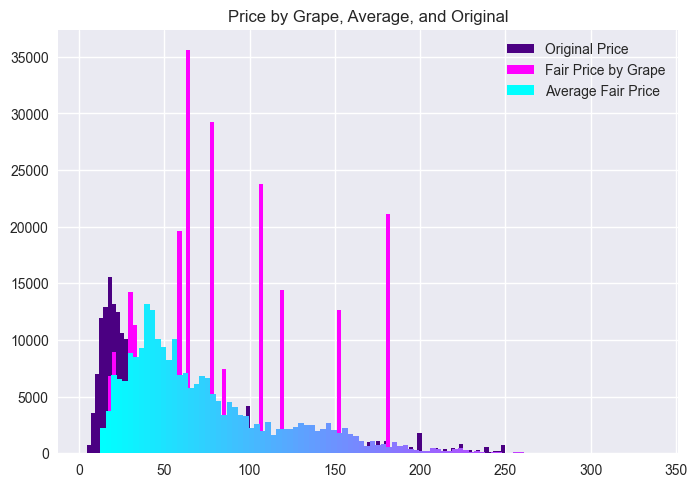

In [257]:
# https://matplotlib.org/stable/tutorials/colors/colormaps.html
cm = plt.cm.get_cmap('cool')

# Plot histogram.
n, bins, patches = plt.hist(subset.Price, color="indigo", bins=100)
#n, bins, patches = plt.hist(subset.Reasonable_Price_Regional, color="magenta", bins=100)
n, bins, patches = plt.hist(subset.Reasonable_Price_by_Grape, color="magenta", bins=100)
#n, bins, patches = plt.hist(subset.Reasonable_Price_Winery, color="indigo", bins=100)
n, bins, patches = plt.hist(subset.Avg_Fair_Price, color="indigo", bins=100)

bin_centers = 0.5 * (bins[:-1] + bins[1:])

# scale values to interval [0,1]
col = bin_centers - min(bin_centers)
col /= max(col)

for c, p in zip(col, patches):
    plt.setp(p, 'facecolor', cm(c))

plt.title('Price by Grape, Average, and Original')
plt.legend(['Original Price', 
#            'Fair Price by Region', 
            'Fair Price by Grape', 
#            'Fair Price by Winery', 
            'Average Fair Price'], 
           loc='upper right')
plt.show()

In [258]:
dataset[dataset.Price < dataset.Avg_Fair_Price].shape

(189838, 40)

In [259]:
dataset.columns

Index(['Full_Vintage_Name', 'Winery_Name', 'Vintage_Year', 'Short_Wine_Name',
       'Type_ID', 'Region', 'Country', 'Price', 'Currency', 'Wine_ID',
       'Average_Rating', 'Rating_Count', 'Varietal_Name', 'Body_Description',
       'Acidity_Description', 'Food_Pairings', 'Most_Used_Grapes', 'Acidity',
       'Intensity', 'Sweetness', 'Tannin', 'Primary_Keywords', 'User_Rating',
       'Note', 'Created_At', 'Label', 'Single_Most_Used_Grape',
       'Label_Category', 'Review_Term_Count', 'Type_Cat', 'Other_Grapes',
       'Acidity_Cat', 'Intensity_Cat', 'Tannin_Cat', 'Sweetness_Cat',
       'Price_Cat', 'Reasonable_Price_Winery', 'Reasonable_Price_Regional',
       'Reasonable_Price_by_Grape', 'Avg_Fair_Price'],
      dtype='object')

In [260]:
def Relative_Price_Cat(Price, Avg_Fair_Price):
    if Price < Avg_Fair_Price:
        relative_price_cat = "good_price"
    else:
        relative_price_cat = "bad_price"
    return relative_price_cat

In [261]:
dataset['Relative_Price_Cat'] = dataset.apply(lambda xyz: Relative_Price_Cat(xyz.Price, xyz.Avg_Fair_Price), axis=1)

In [262]:
dataset.groupby("Relative_Price_Cat").count()['Full_Vintage_Name']

Relative_Price_Cat
bad_price      67951
good_price    189838
Name: Full_Vintage_Name, dtype: int64

In [263]:
# https://textblob.readthedocs.io/en/dev/quickstart.html
dataset['sentiments'] = dataset.Note.apply(lambda xyz: TextBlob(xyz).sentiment)
dataset['polarity'] = dataset.sentiments.apply(lambda abc: abc[0])
dataset['subjectivity'] = dataset.sentiments.apply(lambda abc: abc[1])

# changing the truth to conform to the textblob
dataset["Pos_or_Neg"] = np.where(dataset["polarity"] > 0, 'happy', 'sad')

In [264]:
MAX = dataset.Rating_Count.max()
MIN = dataset.Rating_Count.min()

In [265]:
dataset['Weighted_Rating'] = dataset.apply(lambda row: (((5 - 1) * ((row.Rating_Count - MIN)/
                                                             (MAX - MIN)) + 1) + row.User_Rating)/2, 
                                           axis=1)

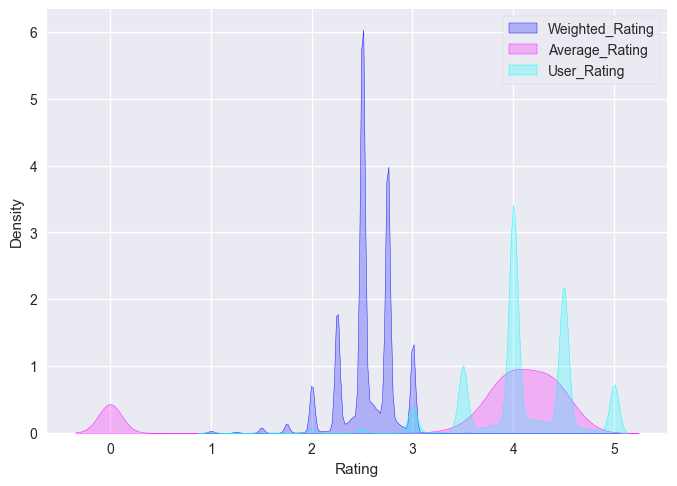

In [266]:
sns.kdeplot(dataset.Weighted_Rating, color="blue", shade=True, legend=True)
sns.kdeplot(dataset.Average_Rating, color="magenta", shade=True, legend=True)
sns.kdeplot(dataset.User_Rating, color="cyan", shade=True, legend=True)
plt.xlabel("Rating")
plt.legend(['Weighted_Rating', 'Average_Rating', 'User_Rating'],
           frameon=True,
           loc='upper right')
plt.show()

In [267]:
# ignoring nulls... fill them with ''

dataset.Region.fillna('', inplace=True)
dataset.Country.fillna('', inplace=True)
dataset.Other_Grapes.fillna('', inplace=True)
dataset.Acidity_Cat.fillna('', inplace=True)
dataset.Intensity_Cat.fillna('', inplace=True)
dataset.Tannin_Cat.fillna('', inplace=True)
dataset.Sweetness_Cat.fillna('', inplace=True)
dataset.Price_Cat.fillna('', inplace=True)
dataset.Relative_Price_Cat.fillna('', inplace=True)
dataset.Pos_or_Neg.fillna('', inplace=True)

In [268]:
dataset.shape

(257789, 46)

In [269]:
dataset.loc[:, 'text'] = dataset.Note + " " \
#+ dataset.Primary_Keywords + " " \
#+ dataset.Body_Description + " " \
#+ dataset.Food_Pairings + " " \
+ dataset.Region + " " \
+ dataset.Country + " " \
+ dataset.Other_Grapes + " " \
+ dataset.Acidity_Cat + " " \
+ dataset.Intensity_Cat + " " \
+ dataset.Tannin_Cat + " " \
+ dataset.Sweetness_Cat + " " \
+ dataset.Price_Cat + " " \
+ dataset.Relative_Price_Cat + " " \
+ dataset.Pos_or_Neg

0         Vouvray France  high_acidity low_intensity tan...
1         Barbaresco Italy  high_acidity medium_intensit...
2         Chianti Italy Trebbiano,Canaiolo Nero,Malvasia...
3         Corton-Charlemagne Grand Cru France Pinot Gris...
4         Ribera del Duero Spain  medium_acidity medium_...
5         Mendoza Argentina  medium_acidity medium_inten...
6         Barbaresco Italy  high_acidity medium_intensit...
7         Rioja Spain Graciano,Garnacha medium_acidity m...
8         Barbaresco Italy  high_acidity medium_intensit...
9         Barolo Italy  high_acidity medium_intensity hi...
10        Clos de la Roche Grand Cru France  high_acidit...
11        Chianti Italy Trebbiano,Canaiolo Nero,Malvasia...
12        Alsace France  high_acidity low_intensity tann...
13        Friuli Italy  low_acidity low_intensity tannin...
14        Mount Veeder United States  medium_acidity hig...
15        Clos Vougeot Grand Cru France  high_acidity lo...
16        Oakville United States  medium

In [270]:
dataset.reset_index(drop=True, inplace=True)

In [271]:
stop_words = stopwords.words('english')  + ["wine", 'vinho']
punc = string.punctuation
punc_less_underscore = punc.replace("_", "")

def strip_accents(STR):
    return ''.join(c for c in unicodedata.normalize('NFD', STR)
                   if unicodedata.category(c) != 'Mn')

def preprocess_text(text):
    """
    Preprocessing for efficient vectorization.
       -- Removes tabs, newlines, punctuation, empty strings.
             -- NOTE punctuation does not incl. underscore for things like acidity_category.
       -- Lemmatizes with universal Part of Speech (POS) method.
       -- Removes default English stopwords.
    """
    
    text = strip_accents(text)
    text = re.sub(r'[^\x00-\x7F]', ' ', text) # removes any remaining non-ascii chars
    
    text = text.lower()
    text = text.replace("\t", " ")
    text = text.replace("\n", " ") 
    
    re_punk = re.compile('[%s]' % re.escape(punc_less_underscore))
    tokens = word_tokenize(text)
    stripped_tkns = [re_punk.sub('', wxy) for wxy in tokens]
    st0p = [word for word in stripped_tkns if not word in stop_words]
    lemmatizer = WordNetLemmatizer()
    p0s_st0p_list = nltk.tag.pos_tag(st0p, 'universal') 
    so_fresh_and_so_clean = []
    for word, tag in p0s_st0p_list:
        if tag == 'VERB':
            tag = 'v'
        elif tag == "ADJ":
            tag = 'a'
        elif tag == "ADV":
            tag = 'r'
        else:
            tag = 'n'
        so_fresh_and_so_clean.append(lemmatizer.lemmatize(word, tag)) 
    while "" in so_fresh_and_so_clean:
        so_fresh_and_so_clean.remove("") # remove blank elements from list
    while " " in so_fresh_and_so_clean:
        so_fresh_and_so_clean.remove(" ") # remove empty spaces from list
    return " ".join(so_fresh_and_so_clean) # return a string

In [272]:
asctime()

'Mon May 22 01:38:22 2023'

In [273]:
dataset['processed_text_str'] = dataset.text.apply(lambda abc: preprocess_text(str(abc)))

In [274]:
asctime()

'Mon May 22 01:48:32 2023'

In [275]:
dataset['processed_text_tokens'] = dataset.processed_text_str.apply(lambda abc: abc.split())

In [276]:
# Example for detecting bigrams 
bigram_measures = nltk.collocations.BigramAssocMeasures()
finder = nltk.collocations.BigramCollocationFinder.from_documents(dataset.processed_text_tokens)

# Filter only those that occur at least 25 times
finder.apply_freq_filter(25)
bigram_scores = finder.score_ngrams(bigram_measures.pmi)
bigram_pmi = pd.DataFrame(bigram_scores)
bigram_pmi.columns = ['bigram', 'pmi']
bigram_pmi.sort_values(by='pmi', axis = 0, ascending = False, inplace = True)

print("bigram pmi standard deviation", round(bigram_pmi.pmi.std(), 2))
print("bigram pmi min", round(bigram_pmi.pmi.min(), 2))
print("bigram pmi min", round(bigram_pmi.pmi.max(), 2))
print("2 st devs less than max bigram pmi ", round(bigram_pmi.pmi.max() - 2 * bigram_pmi.pmi.std()))
print(". . .")

thresh = 3.5 #bigram_pmi.pmi.min() + bigram_pmi.pmi.std()
print("using a threshold of ", round(thresh, 2))

bigram pmi standard deviation 2.86
bigram pmi min -4.09
bigram pmi min 17.13
2 st devs less than max bigram pmi  11
. . .
using a threshold of  3.5


In [277]:
# Example filter for noun-type structures bigrams

def bigram_filter(bigram):
    """
    tag will become a list of lists of tuples of strings:
    [('laundry_list', 'NN'), ('guideline', 'NN')]
    [('memorize', 'NN'), ('predetermined', 'VBD')]
    """
    tag = nltk.pos_tag(bigram)
    FLAG = True
#    print(tag)
    try:
        if tag[0][1] not in ['JJ', 'NN'] and tag[1][1] not in ['NN']:
            FLAG = False
        if 'PRON' in tag[0][1] or 'PRON' in tag[1][1]:
            FLAG = False
    except Exception as exp:
        print(bigram)
        print(tag)
        print(exp)
    return FLAG

# Can eyeball list and choose PMI threshold where n-grams stop making sense
# In this case, get top 500 bigrams/trigrams with highest PMI score

filtered_bigram = bigram_pmi[bigram_pmi.
                             apply(lambda bigram: 
                                   bigram_filter(bigram['bigram']) 
                                   and bigram.pmi > thresh, axis = 1)]

In [278]:
bigram_pmi.head(10)

,bigram,pmi
0,"(hong, kong)",17.132786
1,"(antao, vaz)",17.016310
2,"(11260249robbie, priddle)",16.945159
3,"(129182960susan, neil)",16.910394
4,"(13545217ambassador, petrolhead)",16.910394
5,"(115397767aaron, blazer)",16.843280
6,"(marcelo, pelleriti)",16.717749
7,"(orin, swift)",16.662708
8,"(pall, mall)",16.593267
9,"(116425004vita, vinum)",16.547824


In [279]:
bigram_pmi[bigram_pmi.bigram==('cabernet','sauvignon')]

,bigram,pmi
863,"(cabernet, sauvignon)",8.663962


In [280]:
bigram_pmi[bigram_pmi.bigram==('napa','valley')]

,bigram,pmi
878,"(napa, valley)",8.599737


In [281]:
filtered_bigram.pmi.describe()

count    4905.000000
mean        6.291793
std         2.561111
min         3.500143
25%         4.326818
50%         5.529896
75%         7.481997
max        17.132786
Name: pmi, dtype: float64

In [282]:
filtered_bigram[filtered_bigram.pmi>thresh].tail(10) # check if need to change thresh

,bigram,pmi
5660,"(firm, tannin)",3.504608
5661,"(need, let)",3.504257
5662,"(love, try)",3.503853
5663,"(tobacco, coffee)",3.503049
5665,"(dry, apricot)",3.502359
5666,"(pepper, liquorice)",3.501548
5667,"(body, med)",3.501255
5668,"(great, depth)",3.500646
5669,"(super, complex)",3.500618
5671,"(cheese, meat)",3.500143


In [283]:
filtered_bigram[filtered_bigram.bigram==('cabernet','sauvignon')]

,bigram,pmi
863,"(cabernet, sauvignon)",8.663962


In [284]:
filtered_bigram.to_csv('../data/filtered_bigrams.csv', index=False)

In [285]:
filtered_bigram.shape

(4905, 2)

In [286]:
bigrams = [' '.join(x) for x in filtered_bigram.bigram.values if len(x[0]) > 2 or len(x[1]) > 2]

def replace_ngram(x):
    for gram in bigrams:
        x = x.replace(gram, '_'.join(gram.split()))
    return x

In [287]:
asctime()

'Mon May 22 01:48:52 2023'

In [288]:
dataset.processed_text_str = dataset.processed_text_str.map(lambda x: replace_ngram(x))

In [289]:
asctime()

'Mon May 22 01:58:29 2023'

In [290]:
dataset[dataset.processed_text_str.apply(lambda xyz: "_" in ' '.join(xyz)) == True].processed_text_str[0]

'light_yellow citrus honey pear_citrus apple unusual poorly pair still drinkable think try another day'

In [291]:
asctime()

'Mon May 22 01:58:31 2023'

In [292]:
dataset.processed_text_str.isnull().sum()

0

In [293]:
#dataset['processed_text_tokens'] = dataset.processed_text_str.apply(lambda abc: abc.split())
#dataset[dataset['processed_text_tokens'].map(lambda d: len(d)) > 0] # removes empties; slow

dataset['Text_Term_Count'] = dataset.processed_text_tokens.apply(len)
dataset['Text_Char_Count'] = dataset.processed_text_str.apply(len)

In [294]:
dataset.shape

(257789, 51)

In [295]:
dataset[dataset.Text_Term_Count==0].shape

(530, 51)

In [296]:
dataset.Text_Char_Count.describe()

count    257789.000000
mean        130.301820
std          84.605363
min           0.000000
25%          71.000000
50%         106.000000
75%         162.000000
max         513.000000
Name: Text_Char_Count, dtype: float64

In [297]:
dataset.Text_Term_Count.describe()

count    257789.000000
mean         20.068769
std          12.864238
min           0.000000
25%          11.000000
50%          16.000000
75%          25.000000
max          98.000000
Name: Text_Term_Count, dtype: float64

In [298]:
dataset = dataset[dataset.Text_Term_Count>3]

In [299]:
dataset.shape

(256474, 51)

In [300]:
dataset.isnull().sum()

Full_Vintage_Name                0
Winery_Name                      0
Vintage_Year                    79
Short_Wine_Name                  0
Type_ID                          0
Region                           0
Country                          0
Price                            0
Currency                         0
Wine_ID                          0
Average_Rating                   0
Rating_Count                     0
Varietal_Name                    0
Body_Description                 0
Acidity_Description              0
Food_Pairings                    0
Most_Used_Grapes                 0
Acidity                          0
Intensity                        0
Sweetness                        0
Tannin                       93089
Primary_Keywords                 0
User_Rating                      0
Note                             0
Created_At                       0
Label                            0
Single_Most_Used_Grape           0
Label_Category                   0
Review_Term_Count   

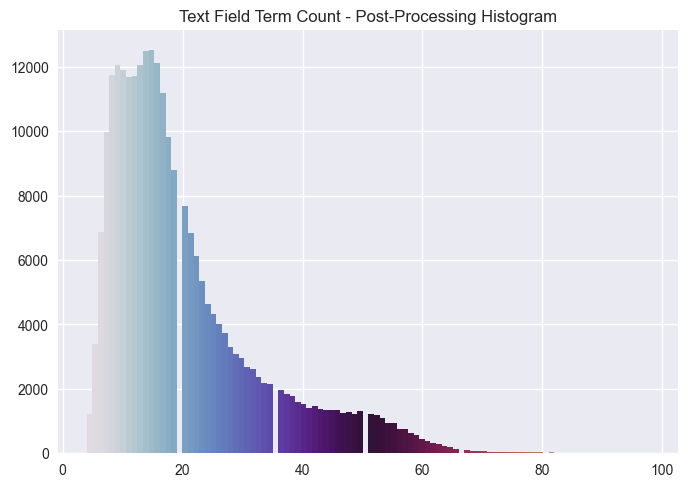

In [301]:
# https://matplotlib.org/stable/tutorials/colors/colormaps.html
cm = plt.cm.get_cmap('twilight')

# Plot histogram.
n, bins, patches = plt.hist(dataset['Text_Term_Count'], 100, color='green')
bin_centers = 0.5 * (bins[:-1] + bins[1:])

# scale values to interval [0,1]
col = bin_centers - min(bin_centers)
col /= max(col)

for c, p in zip(col, patches):
    plt.setp(p, 'facecolor', cm(c))

plt.title('Text Field Term Count - Post-Processing Histogram')
plt.show()

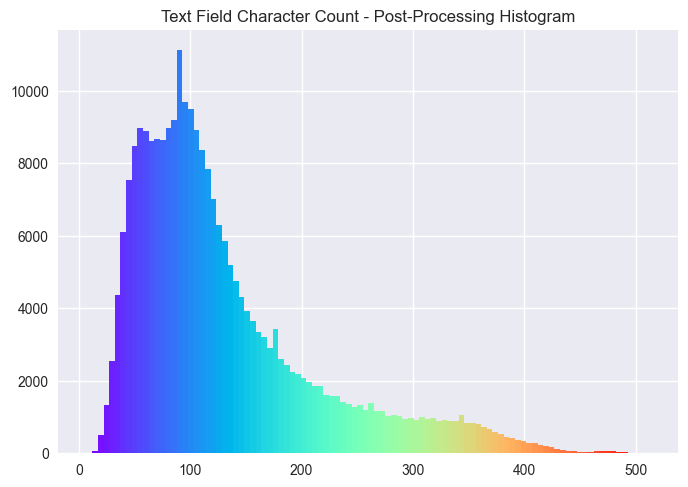

In [302]:
# https://matplotlib.org/stable/tutorials/colors/colormaps.html
cm = plt.cm.get_cmap('rainbow')

# Plot histogram.
n, bins, patches = plt.hist(dataset['Text_Char_Count'], 100, color='green')
bin_centers = 0.5 * (bins[:-1] + bins[1:])

# scale values to interval [0,1]
col = bin_centers - min(bin_centers)
col /= max(col)

for c, p in zip(col, patches):
    plt.setp(p, 'facecolor', cm(c))

plt.title('Text Field Character Count - Post-Processing Histogram')
plt.show()

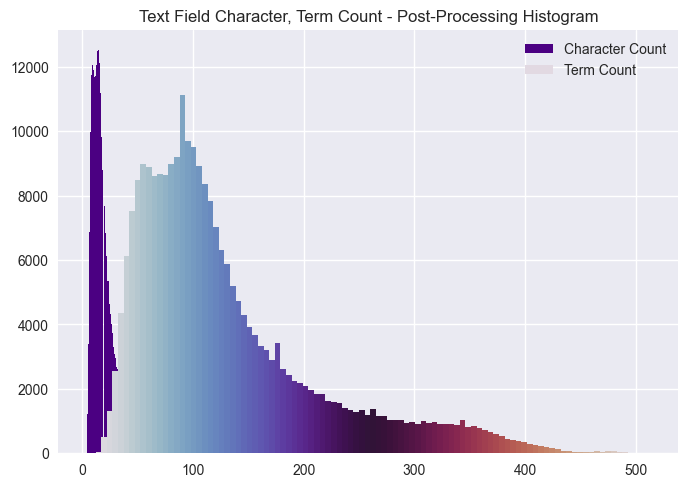

In [303]:
# https://matplotlib.org/stable/tutorials/colors/colormaps.html
cm = plt.cm.get_cmap('twilight')

# Plot histogram.
n, bins, patches = plt.hist(dataset['Text_Term_Count'], 100, color='indigo')
n, bins, patches = plt.hist(dataset['Text_Char_Count'], 100, color='green')
bin_centers = 0.5 * (bins[:-1] + bins[1:])

# scale values to interval [0,1]
col = bin_centers - min(bin_centers)
col /= max(col)

for c, p in zip(col, patches):
    plt.setp(p, 'facecolor', cm(c))

plt.title('Text Field Character, Term Count - Post-Processing Histogram')
plt.legend(['Character Count', 'Term Count'])
plt.show()

In [304]:
subset = dataset[dataset.Price<300]

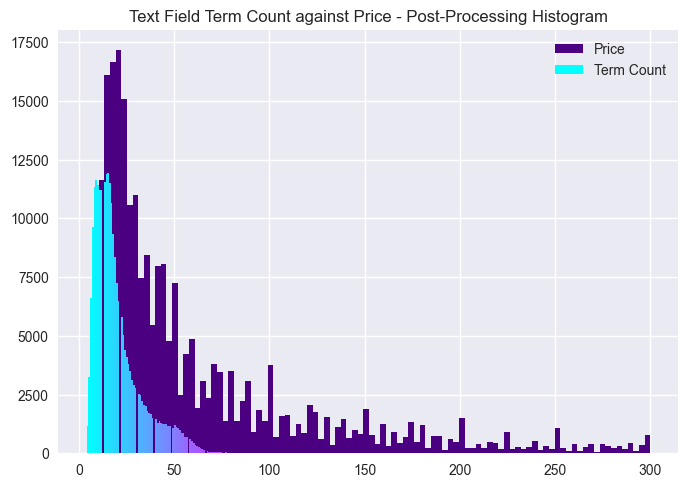

In [305]:
# https://matplotlib.org/stable/tutorials/colors/colormaps.html
cm = plt.cm.get_cmap('cool') # twilight

# Plot histogram.
n, bins, patches = plt.hist(subset['Price'], 100, color='indigo')
n, bins, patches = plt.hist(subset['Text_Term_Count'], 100, color='darkblue')


bin_centers = 0.5 * (bins[:-1] + bins[1:])

# scale values to interval [0,1]
col = bin_centers - min(bin_centers)
col /= max(col)

for c, p in zip(col, patches):
    plt.setp(p, 'facecolor', cm(c))

plt.title('Text Field Term Count against Price - Post-Processing Histogram')
plt.legend(['Price', 'Term Count'])
plt.show()

In [306]:
dataset[dataset.Text_Term_Count > 10].head().processed_text_str[1]

'young good 42 potential become outstanding tannin alcohol need integrate nose open develop already_enjoyable med ruby_color intense nose cherry red plum dry spice bit oak acidity high_tannin med bit_rough alc high stick bite body feel med tase intense finish long correspond well nose ger cherry red plum_compote bit nurmeg oak'

In [307]:
dataset[dataset.Text_Term_Count > 10].head().text[1]

'🧐 The wine is young. As of now it is very good (4.2) with potential to become outstanding (tannins and alcohol need to integrate; and nose open up and develop). Wine is already very enjoyable.\n📝 Med ruby color.\nIntense nose of cherry, red plum, dry spice and a bit of oak. \nAcidity is high; tannins are med+ a bit rough; alc is high, sticks out a bit; body feels med+.\nTase is intense; finish is long. Both correspond well with the nose. You ger cherry and red plum  compote, with a bit of nurmeg and oak.  '

In [308]:
# last, replacing label with {Country Single_Most_Used_Grape}
dataset['Label2'] = dataset['Label']
dataset['Label'] = dataset.apply(lambda xyz: f'{xyz.Country} {xyz.Single_Most_Used_Grape}', axis=1)

In [309]:
print(len(dataset.Single_Most_Used_Grape.unique()), 'Number of Unique Single Most Used Grape.')
print(len(dataset.Label.unique()), 'Number of Unique Labels.')
print(len(dataset.Country.unique()), 'Number of Unique Countries.')
print(len(dataset.Region.unique()), 'Number of Unique Regions.')
print(len(dataset.Varietal_Name.unique()), 'Number of Unique Varietal Names.')
print(len(dataset.Wine_ID.unique()), 'Number of Unique Wines.')
print(dataset.shape[0], "Number of Reviews")
print(f"average text term count post-processing is {round(sum(dataset.processed_text_tokens.str.len()/dataset.shape[0]))} terms.")

36 Number of Unique Single Most Used Grape.
93 Number of Unique Labels.
14 Number of Unique Countries.
394 Number of Unique Regions.
82 Number of Unique Varietal Names.
9968 Number of Unique Wines.
256474 Number of Reviews
average text term count post-processing is 20 terms.


In [310]:
dataset.to_csv("../data/master-thesis-dataset-large-pipedel.csv",
               sep="|"
               , index=False)

In [311]:
# lists are troublemakers
dataset.drop('processed_text_tokens', inplace=True, axis=1)

In [312]:
dataset.shape

(256474, 51)

In [313]:
dataset.columns

Index(['Full_Vintage_Name', 'Winery_Name', 'Vintage_Year', 'Short_Wine_Name',
       'Type_ID', 'Region', 'Country', 'Price', 'Currency', 'Wine_ID',
       'Average_Rating', 'Rating_Count', 'Varietal_Name', 'Body_Description',
       'Acidity_Description', 'Food_Pairings', 'Most_Used_Grapes', 'Acidity',
       'Intensity', 'Sweetness', 'Tannin', 'Primary_Keywords', 'User_Rating',
       'Note', 'Created_At', 'Label', 'Single_Most_Used_Grape',
       'Label_Category', 'Review_Term_Count', 'Type_Cat', 'Other_Grapes',
       'Acidity_Cat', 'Intensity_Cat', 'Tannin_Cat', 'Sweetness_Cat',
       'Price_Cat', 'Reasonable_Price_Winery', 'Reasonable_Price_Regional',
       'Reasonable_Price_by_Grape', 'Avg_Fair_Price', 'Relative_Price_Cat',
       'sentiments', 'polarity', 'subjectivity', 'Pos_or_Neg',
       'Weighted_Rating', 'text', 'processed_text_str', 'Text_Term_Count',
       'Text_Char_Count', 'Label2'],
      dtype='object')

In [314]:
# weird characters I think are messing with the spark import, keeping it simple
dataset = dataset[['processed_text_str', 'Label']]

In [315]:
dataset.to_csv("../data/master-thesis-dataset-large-label-processedtext-only.csv",
               sep="|"
               , index=False)

In [316]:
print(f"{asctime()} <-- End")

Mon May 22 01:58:59 2023 <-- End


<img src="../images/wine_cheers.jpeg">